<a href="https://colab.research.google.com/github/palakkapahi15/LungCancerMinor/blob/main/Lung_cancer_detection__and_classification_Minor_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import seaborn as sns
import cv2
import random
import os
import imageio
import plotly.graph_objects as go
import plotly.express as px
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from collections import Counter
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import accuracy_score, recall_score, precision_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import RandomizedSearchCV, cross_val_score, RepeatedStratifiedKFold
from imblearn.over_sampling import SMOTE
import tensorflow as tf
#import tensorflow_addons as tfa
import keras
from tensorflow.keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, BatchNormalization
from keras.applications import resnet
from tensorflow.keras.applications import EfficientNetB0, EfficientNetB1, EfficientNetB2, EfficientNetB3, EfficientNetB4, EfficientNetB5, EfficientNetB6, EfficientNetB7
from keras.applications.resnet import ResNet50
from tensorflow.keras.utils import load_img, img_to_array, array_to_img
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
tf.__version__

'2.17.0'

In [ ]:
import tensorflow as tf
print(tf.executing_eagerly())  # Should return True


True


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
dir = '/content/drive/My Drive/The IQ-OTHNCCD lung cancer dataset'
labels = os.listdir(dir)
print("No. of labels in the Training set: {}".format(len(labels)))
print("-----------------")
os.chdir(dir)
for label in labels:
    print("{}, {} files".format(label, len(os.listdir(dir+ '//' +label))))

No. of labels in the Training set: 3
-----------------
Malignant cases, 561 files
Normal cases, 416 files
Benign cases, 120 files


In [ ]:
dir = '/content/drive/My Drive/The IQ-OTHNCCD lung cancer dataset'
categories = ['Malignant cases', 'Normal cases','Benign cases']
files = os.listdir(dir)
files

['Malignant cases', 'Normal cases', 'Benign cases', 'minor_model_1.keras']

In [ ]:
size_data = {}
HEIGHT = WIDTH = 224
img_size = 224
for i in categories:
    path = os.path.join(dir, i)
    class_num = categories.index(i)
    temp_dict = {}
    for file in os.listdir(path):
        filepath = os.path.join(path, file)
        height, width, channels = imageio.v2.imread(filepath).shape
        # TODO if height == width then aspect ratio 1:1 currenly the if statement is removing 1024 x 1024
#         if height == width:
        k = str(height) + ' x ' + str(width)
        temp_dict[k] = temp_dict.get(k, 0) + 1
    size_data[i] = temp_dict

size_data

{'Malignant cases': {'512 x 512': 501,
  '512 x 801': 28,
  '404 x 511': 1,
  '512 x 623': 31},
 'Normal cases': {'512 x 512': 415, '331 x 506': 1},
 'Benign cases': {'512 x 512': 120}}

Malignant cases


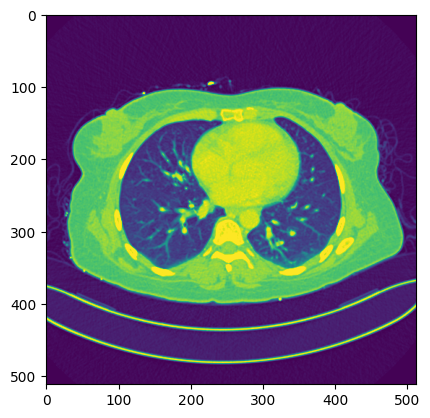

Normal cases


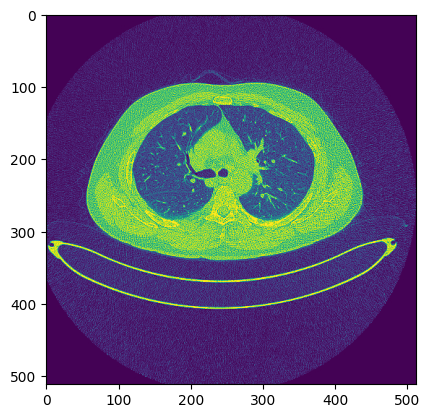

Benign cases


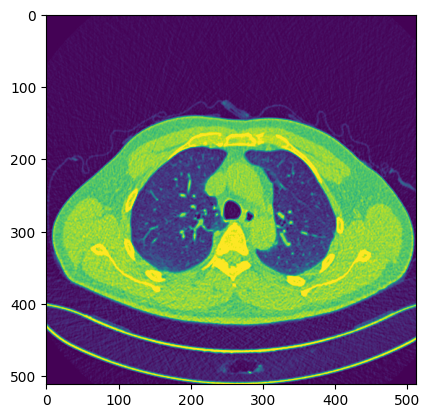

In [ ]:
for i in categories:
    path = os.path.join(dir, i)
    class_num = categories.index(i)
    for file in os.listdir(path):
        filepath = os.path.join(path, file)
        print(i)
        img = cv2.imread(filepath, 0)
        plt.imshow(img)
        plt.show()
        break

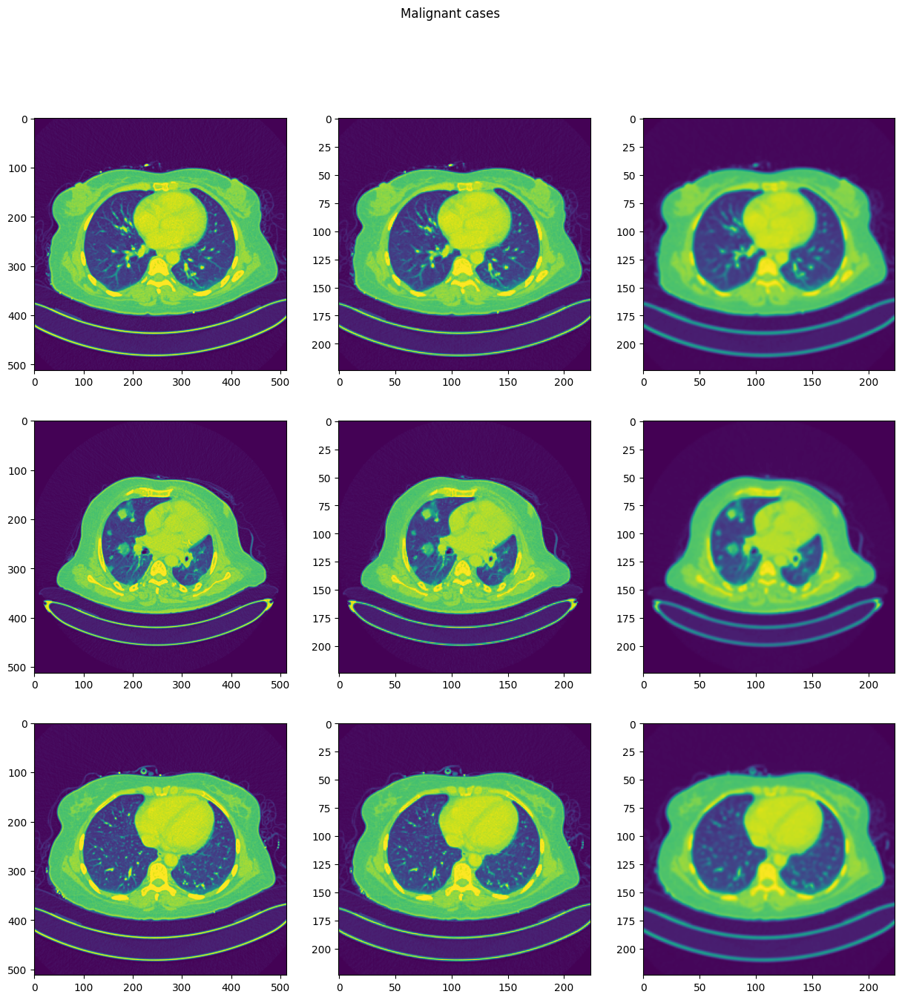

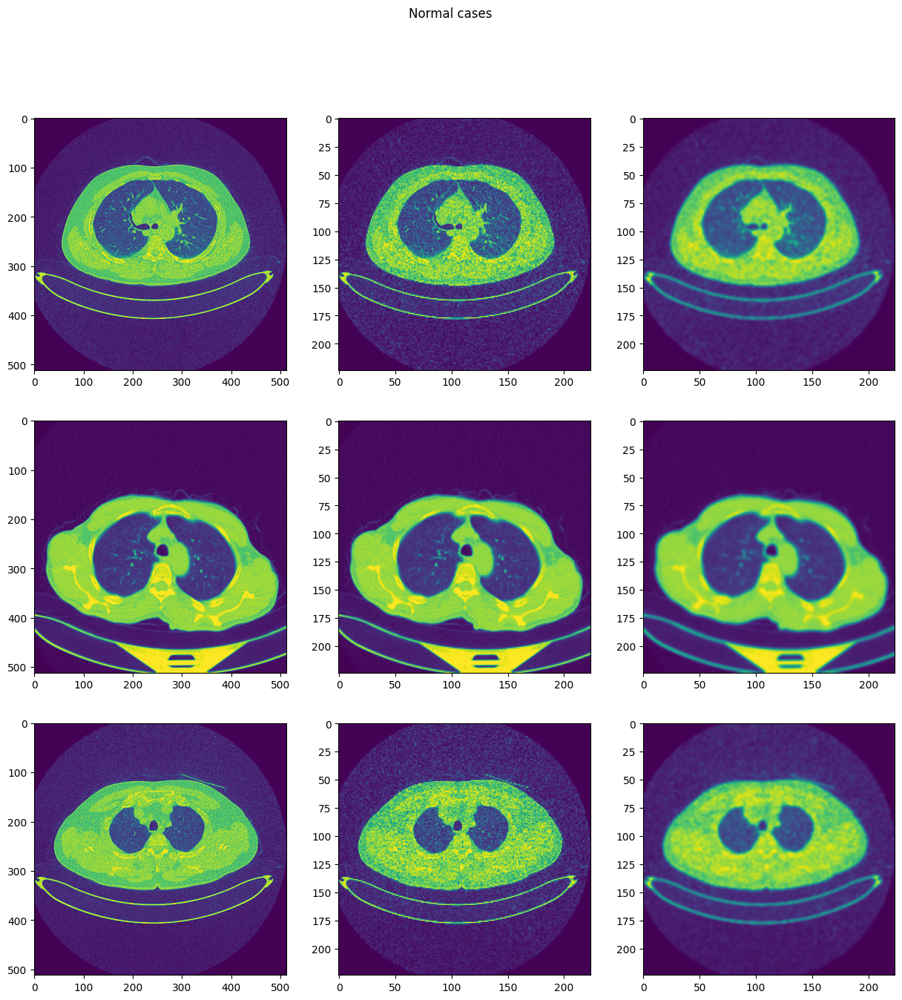

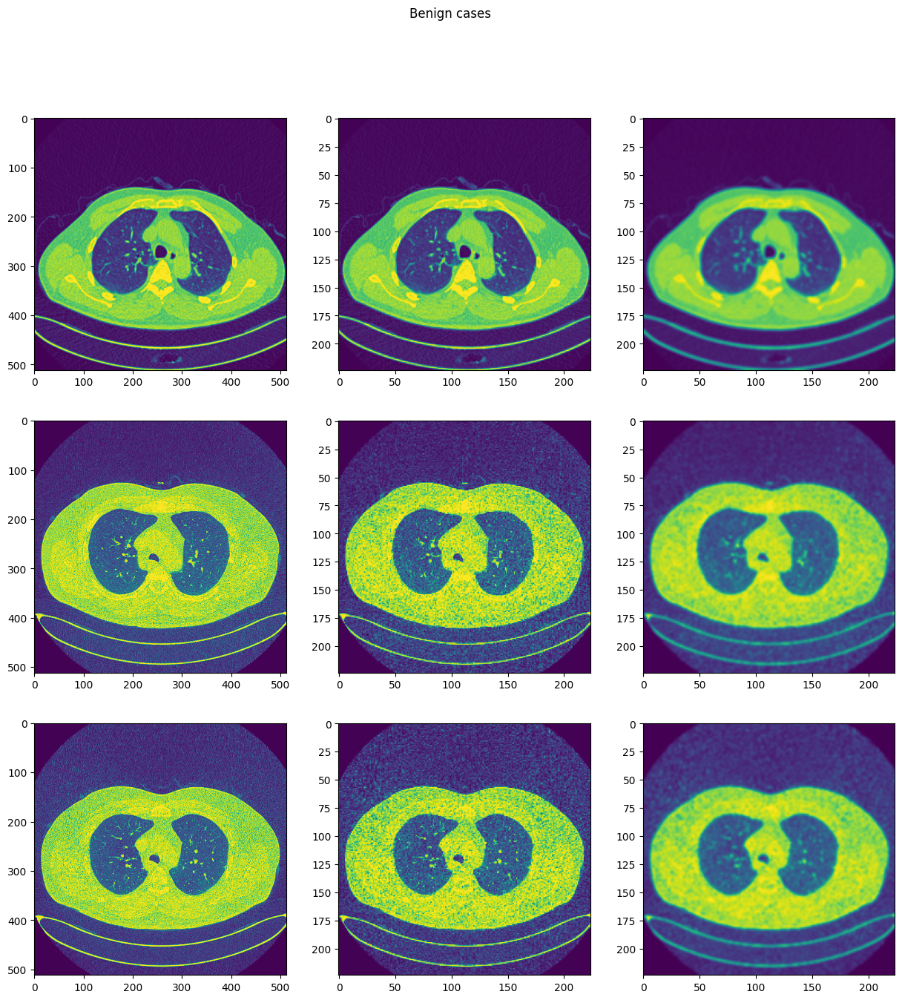

In [ ]:

for i in categories:
    cnt, samples = 0, 3
    fig, ax = plt.subplots(samples, 3, figsize=(15, 15))
    fig.suptitle(i)

    path = os.path.join(dir, i)
    class_num = categories.index(i)
    for curr_cnt, file in enumerate(os.listdir(path)):
        filepath = os.path.join(path, file)
        img = cv2.imread(filepath, 0)

        img0 = cv2.resize(img, (img_size, img_size))

        img1 = cv2.GaussianBlur(img0, (5, 5), 0)

        ax[cnt, 0].imshow(img)
        ax[cnt, 1].imshow(img0)
        ax[cnt, 2].imshow(img1)
        cnt += 1
        if cnt == samples:
            break

plt.show()

In [ ]:
!pip install numpy pillow scikit-learn imbalanced-learn


In [ ]:
import os
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler

# Set the path to your dataset directory
dir_path = '/content/drive/My Drive/The IQ-OTHNCCD lung cancer dataset'

# Initialize lists to hold features and labels
X = []
y = []

# Mapping from directory names to labels
label_map = {'Normal cases': 0, 'Malignant cases': 1, 'Benign cases': 2}

# Load images and labels
for label_name, label_id in label_map.items():
    label_dir = os.path.join(dir_path, label_name)
    for file_name in os.listdir(label_dir):
        file_path = os.path.join(label_dir, file_name)
        # Load image
        image = Image.open(file_path)
        # Convert image to grayscale and resize if necessary
        image = image.convert('L')  # Or 'L' for grayscale or 'RGB' for colored
        image = image.resize((224, 224))  # Resize to a fixed size if necessary
        # Convert image to numpy array and flatten
        image_array = np.array(image).flatten()
        # Append to lists
        X.append(image_array)
        y.append(label_id)

# Convert lists to numpy arrays
X = np.array(X)
y = np.array(y)

# Normalize data (optional but often useful)
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Split the dataset into training+validation and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Split the training+validation set into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.2, random_state=42, stratify=y_train_val)

# Print the shapes of the resulting sets
print("Training set shape:", X_train.shape)
print("Validation set shape:", X_val.shape)
print("Test set shape:", X_test.shape)

# Apply SMOTE to the training set
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Print the shapes of the resampled sets
print("Resampled training set shape:", X_train_resampled.shape)

print(f"Original training set size: {X_train.shape[0]}")
print(f"Resampled training set size: {X_train_resampled.shape[0]}")
print(f"Validation set size: {X_val.shape[0]}")
print(f"Test set size: {X_test.shape[0]}")

Training set shape: (701, 50176)
Validation set shape: (176, 50176)
Test set shape: (220, 50176)
Resampled training set shape: (1074, 50176)
Original training set size: 701
Resampled training set size: 1074
Validation set size: 176
Test set size: 220


In [ ]:
print("Test set shape:", X_test.shape)

Test set shape: (220, 50176)


In [ ]:
import numpy as np
from collections import Counter

# Assuming y_test contains the labels for the test set
class_distribution = Counter(y_test)

# Map labels back to class names if necessary
label_map_inverse = {v: k for k, v in label_map.items()}
class_distribution_names = {label_map_inverse[k]: v for k, v in class_distribution.items()}

print("Test set class distribution:")
for class_name, count in class_distribution_names.items():
    print(f"{class_name}: {count} images")


Test set class distribution:
Malignant cases: 113 images
Benign cases: 24 images
Normal cases: 83 images


In [ ]:
import numpy as np
from collections import Counter

# Assuming y_test contains the labels for the test set
class_distribution = Counter(y_train_resampled)

# Convert the Counter object to a dictionary
class_distribution = dict(class_distribution)

# Map labels back to class names if necessary
label_map_inverse = {v: k for k, v in label_map.items()}
class_distribution_names = {label_map_inverse[k]: v for k, v in class_distribution.items()}

print("Train set class distribution:")
for class_name, count in class_distribution_names.items():
    print(f"{class_name}: {count} images")


Train set class distribution:
Normal cases: 358 images
Malignant cases: 358 images
Benign cases: 358 images


In [ ]:
import os
from PIL import Image

# Function to check image sizes in a dataset
def check_image_sizes(directory, expected_size=(224, 224)):
    sizes = []
    for label_name, label_id in label_map.items():
        label_dir = os.path.join(directory, label_name)
        for file_name in os.listdir(label_dir):
            file_path = os.path.join(label_dir, file_name)
            with Image.open(file_path) as img:
                img = img.convert('L')  # Or 'RGB' if using color images
                img = img.resize(expected_size)
                sizes.append(img.size)
    unique_sizes = set(sizes)
    return unique_sizes

# Check image sizes in the training dataset directory
unique_sizes = check_image_sizes(dir_path)
print(f"Unique image sizes in dataset: {unique_sizes}")


Unique image sizes in dataset: {(224, 224)}


In [ ]:
# Check the shape of one sample image
sample_image = X_train[0]
print(f"Shape of one sample image in X_train: {sample_image.shape}")


Shape of one sample image in X_train: (50176,)


In [ ]:
# Check the shape of the resampled training set
print(f"Shape of X_train_resampled: {X_train_resampled.shape}")


Shape of X_train_resampled: (1074, 50176)


In [ ]:
print(len(X_train_resampled), X_train_resampled.shape)

1074 (1074, 50176)


# Model 1

In [ ]:
# Model is overfit
model1 = Sequential()

model1.add(Conv2D(128, (3, 3), input_shape=(224,224,1)))
model1.add(Activation('relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Conv2D(128, (3, 3), activation='relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))
model1.add(Dropout(0.7))
model1.add(Conv2D(128, (3, 3), activation='relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))
model1.add(Dropout(0.7))

model1.add(Flatten())
model1.add(Dense(16))
model1.add(Dense(3, activation='softmax'))

model1.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_10 (Conv2D)                   │ (None, 222, 222, 128)       │           1,280 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_4 (Activation)            │ (None, 222, 222, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_10 (MaxPooling2D)      │ (None, 111, 111, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_11 (Conv2D)                   │ (None, 109, 109, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_11 (MaxPooling2D)      │ (None, 54, 54, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_9 (Dropout)                  │ (None, 54, 54, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_12 (Conv2D)                   │ (None, 52, 52, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_12 (MaxPooling2D)      │ (None, 26, 26, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_10 (Dropout)                 │ (None, 26, 26, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 86528)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 16)                  │       1,384,464 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 3)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,680,963 (6.41 MB)

 Trainable params: 1,680,963 (6.41 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model1.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint


# Define early stopping callback
early_stopping = EarlyStopping(monitor='val_loss',  # Monitor validation loss
                               patience=3,         # Number of epochs with no improvement after which training will be stopped
                               restore_best_weights=True)  # Restore weights to the best model observed during training

# Define model checkpoint callback to save the best model during training
checkpoint = ModelCheckpoint('minor_project_model_1.keras',  # Filepath to save the best model
                             monitor='val_loss',  # Monitor validation loss
                             save_best_only=True,  # Save only the best model
                             mode='min',          # Mode of monitoring (minimize validation loss)
                             verbose=1)           # Verbosity mode (1 for updates)


In [ ]:
print(f"X_train_resampled shape: {X_train_resampled.shape}")
print(f"y_train_resampled shape: {y_train_resampled.shape}")


X_train_resampled shape: (1074, 50176)
y_train_resampled shape: (1074,)


In [ ]:
# Reshape X_train_resampled to the expected format
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 1)

# Now fit the model
history = model1.fit(X_train_resampled, y_train_resampled, validation_split=0.2, batch_size=8, epochs=20, callbacks=[early_stopping, checkpoint])

Epoch 1/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.6218 - loss: 1.3800
Epoch 1: val_loss improved from inf to 0.61947, saving model to minor_project_model_1.keras
108/108 ━━━━━━━━━━━━━━━━━━━━ 353s 3s/step - accuracy: 0.6225 - loss: 1.3753 - val_accuracy: 0.9767 - val_loss: 0.6195
Epoch 2/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8024 - loss: 0.5042
Epoch 2: val_loss did not improve from 0.61947
108/108 ━━━━━━━━━━━━━━━━━━━━ 395s 3s/step - accuracy: 0.8027 - loss: 0.5034 - val_accuracy: 0.8372 - val_loss: 0.6733
Epoch 3/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8744 - loss: 0.3304
Epoch 3: val_loss did not improve from 0.61947
108/108 ━━━━━━━━━━━━━━━━━━━━ 385s 4s/step - accuracy: 0.8745 - loss: 0.3303 - val_accuracy: 0.6605 - val_loss: 0.6220
Epoch 4/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9084 - loss: 0.2228
Epoch 4: val_loss improved from 0.61947 to 0.39296, saving model to minor_project_model_1.keras
108/108 ━━━━━━━━━━━━━━━━

In [ ]:
print(f"X_test shape: {X_test.shape}")
print(f"X_test data type: {X_test.dtype}")

# Print the expected input shape of your model
print(f"Model input shape: {model1.input_shape}")

X_test shape: (220, 50176)
X_test data type: float64
Model input shape: (None, 224, 224, 1)


In [ ]:
X_test_reshaped = X_test.reshape(-1, 224, 224, 1)

# Now use the reshaped data for prediction
y_pred = model1.predict(X_test_reshaped, verbose=1)
y_pred_bool = np.argmax(y_pred, axis=1)

7/7 ━━━━━━━━━━━━━━━━━━━━ 25s 3s/step


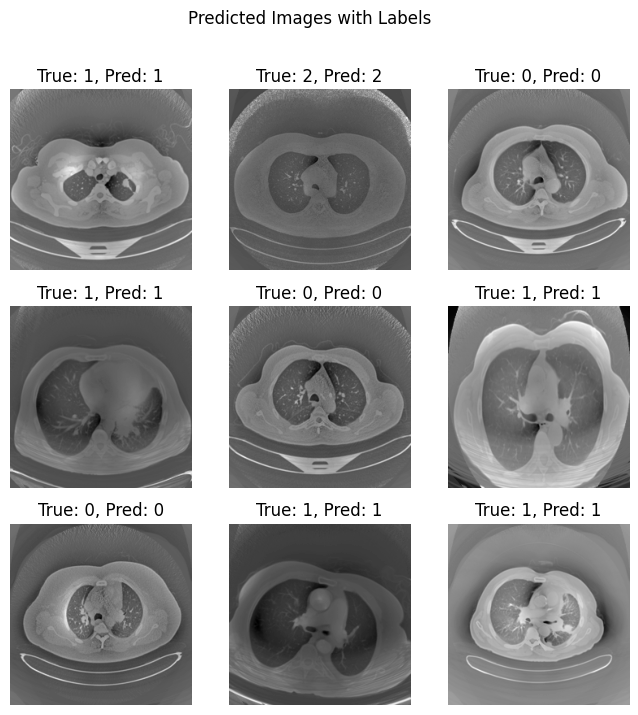

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(8, 8))
fig.suptitle('Predicted Images with Labels')

for i, ax in enumerate(axes.flat):
    ax.imshow(X_test[i].reshape(img_size, img_size, 1), cmap='gray')
    true_label = y_test[i]  # Integer-encoded label
    pred_label = y_pred_bool[i]
    ax.set_title(f'True: {true_label}, Pred: {pred_label}')
    ax.axis('off')
plt.show()

In [ ]:
# New model accuracy
print(classification_report(y_test, y_pred_bool))

print(confusion_matrix(y_true=y_test, y_pred=y_pred_bool))


              precision    recall  f1-score   support

           0       0.99      0.84      0.91        83
           1       0.99      0.98      0.99       113
           2       0.65      1.00      0.79        24

    accuracy                           0.93       220
   macro avg       0.88      0.94      0.89       220
weighted avg       0.95      0.93      0.94       220

[[ 70   1  12]
 [  1 111   1]
 [  0   0  24]]


In [ ]:
# Overfitted model
print(classification_report(y_test, y_pred_bool))

print(confusion_matrix(y_true=y_test, y_pred=y_pred_bool))


              precision    recall  f1-score   support

           0       1.00      0.99      0.99        83
           1       1.00      1.00      1.00       113
           2       0.96      1.00      0.98        24

    accuracy                           1.00       220
   macro avg       0.99      1.00      0.99       220
weighted avg       1.00      1.00      1.00       220

[[ 82   0   1]
 [  0 113   0]
 [  0   0  24]]


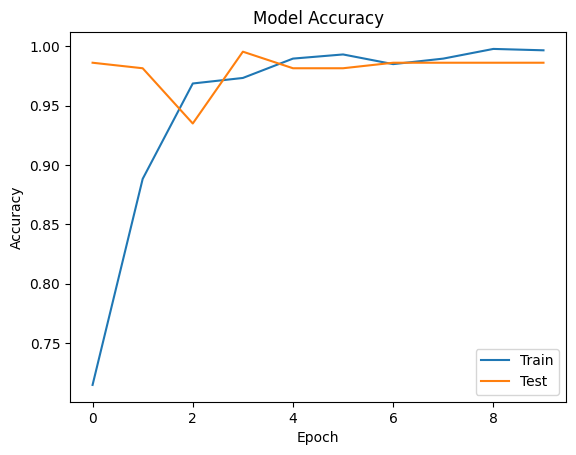

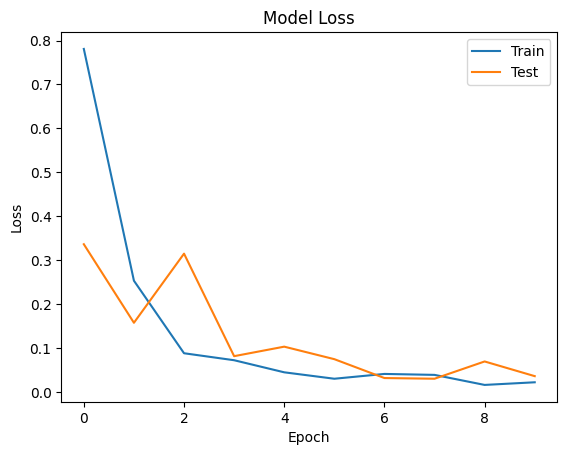

In [ ]:
plt.plot(history.history['accuracy'], label='Train')
plt.plot(history.history['val_accuracy'], label='Test')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='Train')
plt.plot(history.history['val_loss'], label='Test')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 14.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=44c7bd4cee3980f9388457cc17b737fbe0324d453beb54e44c57c13478b04311
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
X_test.shape

(220, 50176)

In [ ]:
for i in range(len(X_test)):
    #image before prediction
    print(X_test[i].shape)

(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(50176,)
(

In [ ]:
print(f"Shape of X_test: {X_test.shape}")
print(f"First image shape: {X_test[0].shape}")


Shape of X_test: (220, 50176)
First image shape: (50176,)


In [ ]:
sample_image = X_test[0]
sample_image = sample_image.reshape(1, 224, 224, 1)  # Ensure it has the right shape
preds = model1.predict(sample_image)
print(f"Predictions: {preds}")
print(f"Predicted label: {preds.argmax(axis=1)[0]}")


In [ ]:
# Print the shape of X_test and a sample image
print("Shape of X_test:", X_test.shape)
print("Shape of first sample image:", X_test[0].shape)

# Check the total number of elements in one image
sample_image_size = X_test[0].size
print(f"Size of one flattened image: {sample_image_size}")


In [ ]:
print(X_test.shape)  # Print the shape of X_test
print(X_test[0].shape)  # Print the shape of a sample image


In [ ]:
# Ensure the image dimensions are correctly defined
IMAGE_HEIGHT = 224
IMAGE_WIDTH = 224
IMAGE_CHANNELS = 1  # For grayscale images

# Function to reshape flattened image to its original dimensions
def reshape_image(flattened_image):
    return flattened_image.reshape(IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS)  # Reshape to (224, 224, 1)

# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test)):
    flattened_image = X_test[i]
    image = reshape_image(flattened_image)  # Reshape to (224, 224, 1)

    pred_label = model1.predict(image.reshape(1, IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Print the shape of the first image of each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")
        print()


NameError: name 'model1' is not defined

In [ ]:
X_test.shape

(220, 50176)

In [ ]:
X_test = X_test.reshape(-1, 224, 224, 1)
X_test.shape

(220, 224, 224, 1)

In [ ]:
label_map = {'Normal cases': 0, 'Malignant cases': 1, 'Benign cases': 2}

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (28x28)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(color_img):
    # Convert the RGB image to grayscale
    gray_img = rgb2gray(color_img).reshape(-1, 224, 224, 1)

    # Get predictions for the image
    preds = model1.predict(gray_img)

    # Assuming the model outputs a probability distribution over three categories
    # preds.shape will be (1, 3) where each value corresponds to a category
    normal_prob = preds[0][0]  # Probability for Malignant category
    malignant_prob = preds[0][1]     # Probability for Normal category
    benign_prob = preds[0][2]     # Probability for Benign category

    # Return the probabilities as a dictionary
    return {
        "Malignant": malignant_prob,
        "Normal": normal_prob,
        "Benign": benign_prob
    }

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()


In [ ]:
# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

In [ ]:
from tensorflow.keras.models import load_model
# Load the trained model
model1 = load_model('/content/drive/MyDrive/The IQ-OTHNCCD lung cancer dataset/minor_model_1.keras')

In [ ]:
!pip install lime
from lime import lime_image
explainer = lime_image.LimeImageExplainer(random_state=123)

explainer

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 15.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=0ff9ab588c3d6d35b8816d91820b28589b57f5df6a42b82106937580bc2f8df7
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


## TRUE PREDICTION - POSITIVE CONTRIBUTION

Category: Normal cases
Index: 2
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
Predictions: [[9.981877e-01 7.811370e-05 1.734174e-03]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 613ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 616ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 874ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 959ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 871ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 979ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 958ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 875ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 0
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Predictions: [[5.4065842e-04 9.9945933e-01 3.2453023e-08]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 613ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 656ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 627ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 1
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Predictions: [[6.844136e-04 5.346020e-10 9.993156e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 649ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 627ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

(224, 224, 3)
(224, 224)


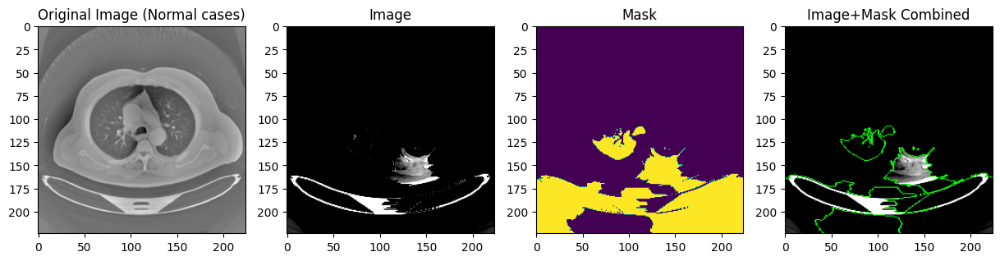

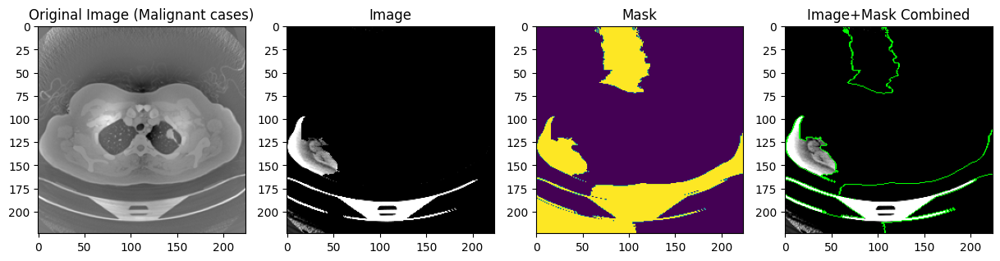

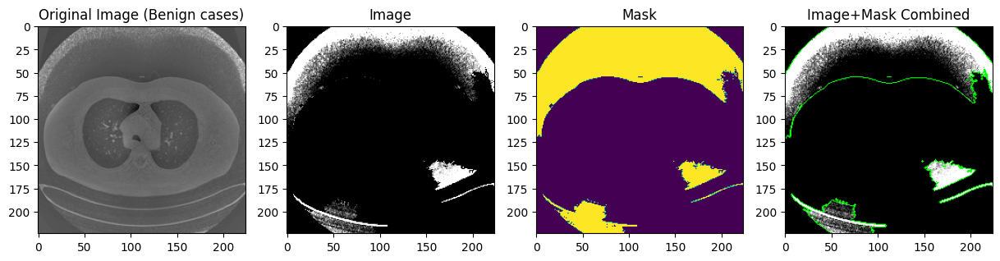

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (28x28)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(color_img):
    # Convert the RGB image to grayscale
    gray_img = rgb2gray(color_img).reshape(-1, 224, 224, 1)

    # Get predictions for the image
    preds = model1.predict(gray_img)

    # Return the prediction probabilities as a 2D array
    return preds

from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray");
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img);
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask);
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)));
    ax.set_title("Image+Mask Combined");

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Pass the reshaped image (squeeze to remove the single channel dimension)
        explanation = explainer.explain_instance(X_test[idx].squeeze(),
                                                 make_predictions_on_categories,
                                                 random_seed=123)

        img, mask = explanation.get_image_and_mask(y_test[idx], positive_only=True, hide_rest=True)

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# TRUE PREDICTION - NEGATIVE CONTRIBUTION

Category: Normal cases
Index: 2
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Shape of model predictions: (1, 3)
Predictions: [[7.4997759e-01 2.5666662e-04 2.4976572e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━

Category: Malignant cases
Index: 0
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Shape of model predictions: (1, 3)
Predictions: [[1.6688606e-05 9.9998331e-01 2.0824151e-08]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━

Category: Benign cases
Index: 1
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Shape of model predictions: (1, 3)
Predictions: [[1.0604219e-10 4.7398505e-11 1.0000000e+00]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 628ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━

Shape of model predictions: (10, 3)
(224, 224, 3)
(224, 224)


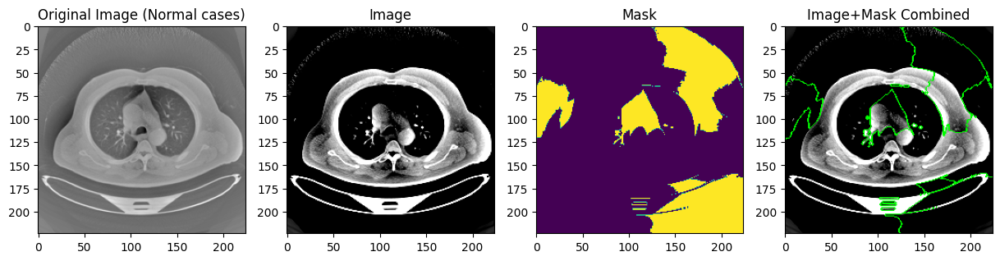

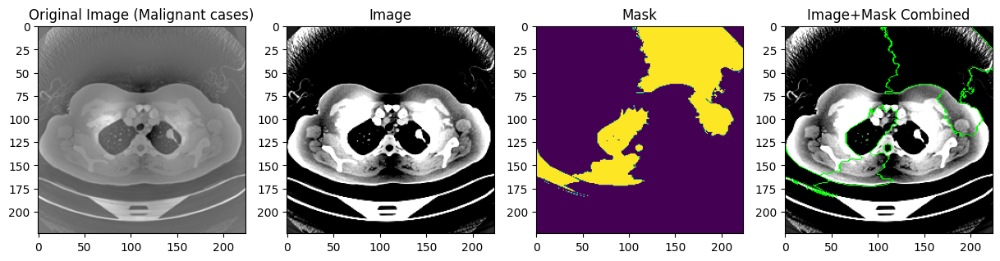

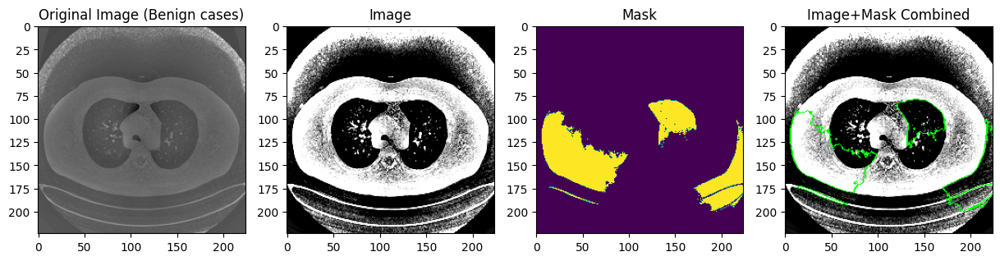

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (224x224)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(gray_img):
    # Prepare the grayscale image for prediction
    gray_img_reshaped = gray_img.reshape(-1, 224, 224, 1)

    # Debugging: Print the shape of the input image
    print(f"Shape of input to model: {gray_img_reshaped.shape}")

    # Get predictions for the image
    preds = model1.predict(gray_img_reshaped)

    # Debugging: Print the shape of the prediction output
    print(f"Shape of model predictions: {preds.shape}")

    # Return the prediction probabilities
    return preds

from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray");
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img);
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask);
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)));
    ax.set_title("Image+Mask Combined");

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB for LIME, and make predictions using grayscale
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(image)  # Pass the grayscale image for prediction

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # LIME needs to call a function that returns just the predictions
        explanation = explainer.explain_instance(colored_image,  # Use RGB image for explanation
                                                 lambda x: make_predictions_on_categories(rgb2gray(x)),
                                                 random_seed=123)

        # Get the image and mask for negative contributions
        img, mask = explanation.get_image_and_mask(y_test[idx], positive_only=False, negative_only=True, hide_rest=False)

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# TRUE PREDICTION USING felzenszwalb segmentation method - POSITIVE CONTRIBUTION

Category: Normal cases
Index: 2
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
Predictions: [[7.4997759e-01 2.5666662e-04 2.4976572e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 927ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 995ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 747ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 639ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 868ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 626ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 617ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 730ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 627ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 0
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Predictions: [[1.6688606e-05 9.9998331e-01 2.0824151e-08]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 621ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

(224, 224, 3)
(224, 224)


Category: Benign cases
Index: 1
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Predictions: [[1.0604219e-10 4.7398505e-11 1.0000000e+00]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 843ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 616ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 613ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 915ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 939ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 856ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 

(224, 224, 3)
(224, 224)


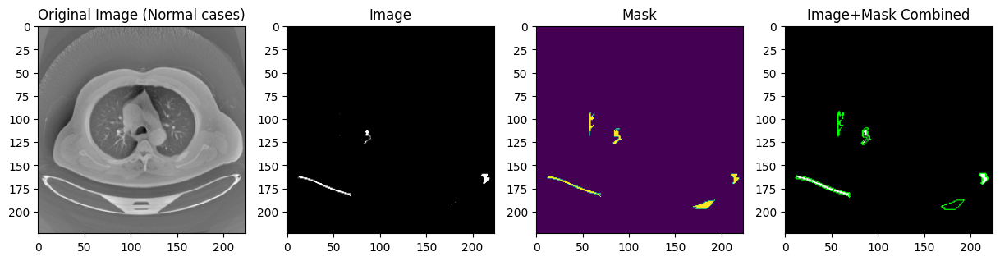

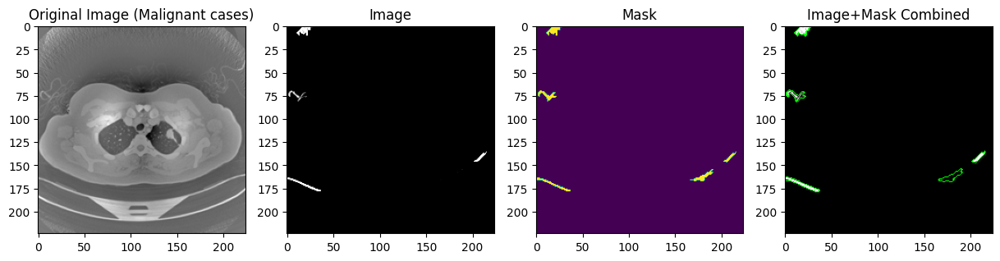

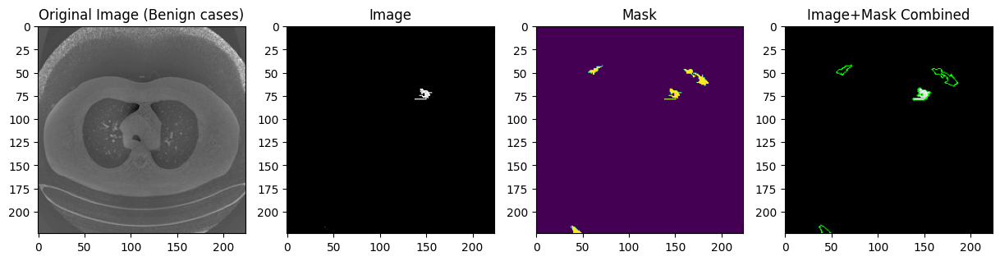

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (28x28)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(color_img):
    # Convert the RGB image to grayscale
    gray_img = rgb2gray(color_img).reshape(-1, 224, 224, 1)

    # Get predictions for the image
    preds = model1.predict(gray_img)

    # Return the prediction probabilities as a 2D array
    return preds

from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray");
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img);
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask);
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)));
    ax.set_title("Image+Mask Combined");

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Pass the reshaped image (squeeze to remove the single channel dimension)
        explanation = explainer.explain_instance(colored_image, make_predictions_on_categories,
                                         segmentation_fn=felzenszwalb, random_seed=123)

        img, mask = explanation.get_image_and_mask(y_test[idx], positive_only=True, hide_rest=True)

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# TRUE PREDICTION USING felzenszwalb segmentation method - NEGATIVE CONTRIBUTION

Category: Normal cases
Index: 2
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Predictions: [[7.4997759e-01 2.5666662e-04 2.4976572e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 635ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 0
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Predictions: [[1.6688606e-05 9.9998331e-01 2.0824151e-08]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 906ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 630ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 895ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 739ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 859ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

(224, 224, 3)
(224, 224)


Category: Benign cases
Index: 1
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
Predictions: [[1.0604219e-10 4.7398505e-11 1.0000000e+00]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

(224, 224, 3)
(224, 224)


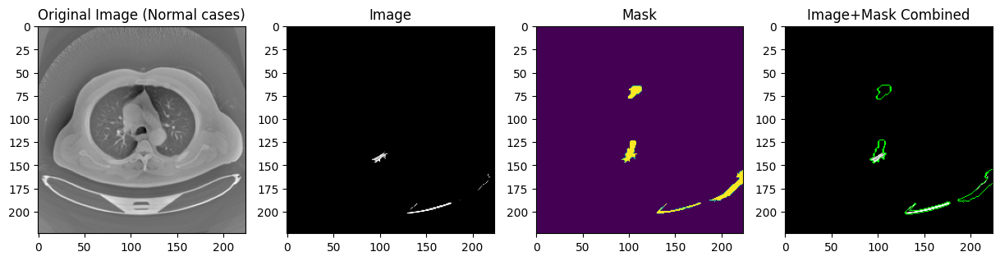

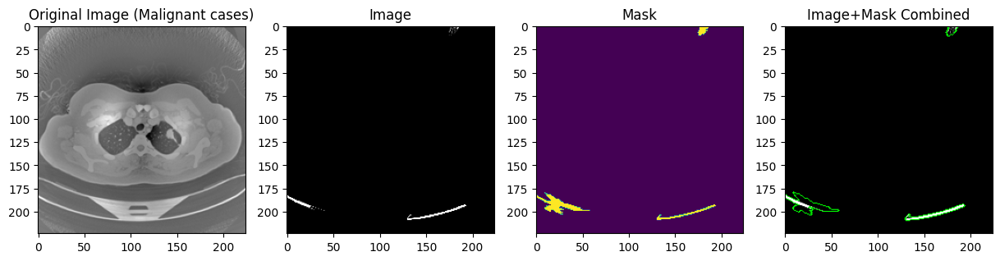

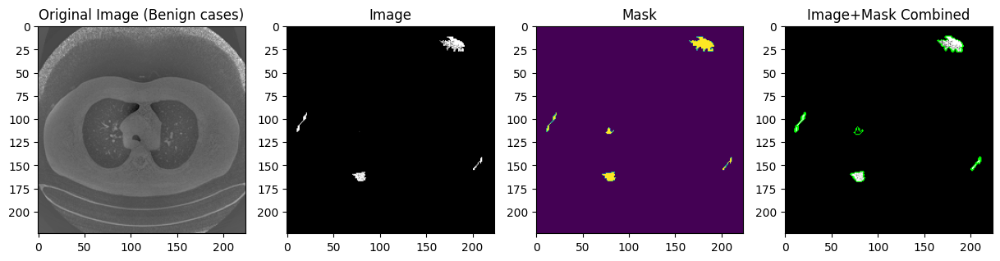

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (224x224)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(color_img):
    # Convert the RGB image to grayscale
    gray_img = rgb2gray(color_img).reshape(-1, 224, 224, 1)

    # Get predictions for the image
    preds = model1.predict(gray_img)

    # Return the prediction probabilities as a 2D array
    return preds

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)))
    ax.set_title("Image+Mask Combined")

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Pass the reshaped image (squeeze to remove the single channel dimension)
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get image and mask for negative contributions
        img, mask = explanation.get_image_and_mask(
            y_test[idx],
            positive_only=False,  # Set to False to include negative contributions
            negative_only=True,    # Set to True to focus only on negative contributions
            hide_rest=True
        )

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# FALSE PREDICTION USING felzenszwalb segmentation method - POSITIVE CONTRIBUTION

Shape of X_test before prediction: (220, 224, 224, 1)
Shape of X_test after reshaping: (220, 224, 224, 1)
Reshaped X_test shape: (220, 224, 224, 1)
7/7 ━━━━━━━━━━━━━━━━━━━━ 32s 5s/step
Category: Normal cases
Index: 27
Shape of image: (224, 224)
Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
Predictions: [[0.8360377  0.14794724 0.01601515]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 962ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 943ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 989ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 947ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 966ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 927ms/step
Shape of color_i

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 29
Shape of image: (224, 224)
Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
Predictions: [[0.12745327 0.8414592  0.03108755]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 967ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 947ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 942ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 939ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 943ms/step
Shape of color_img 

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 2
Shape of image: (224, 224)
Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
Predictions: [[2.0265256e-01 1.1119385e-04 7.9723620e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 944ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 959ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 951ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 944ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 931ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 948ms/step
Shape of color_i

(224, 224, 3)
(224, 224)


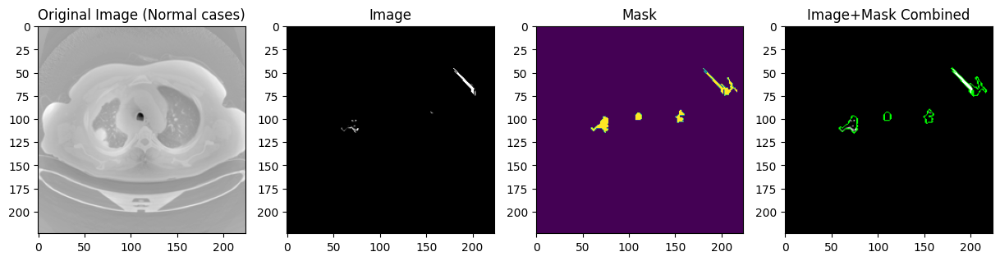

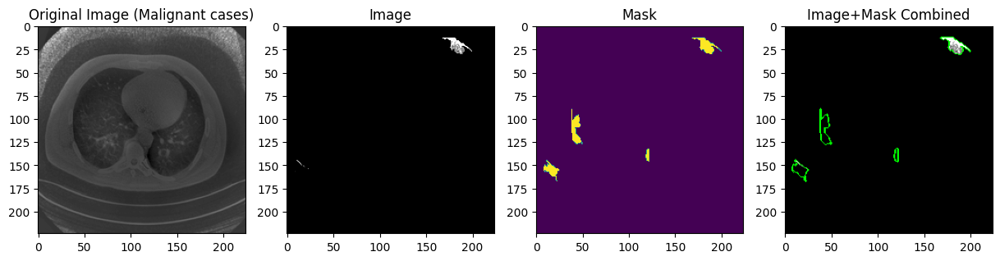

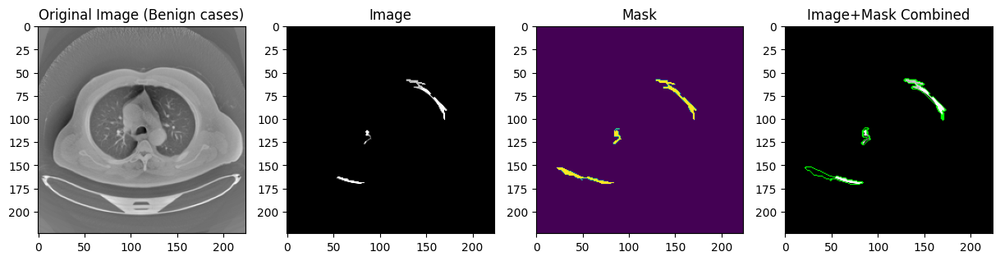

In [ ]:
import numpy as np
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

# Function to reshape the flattened image
def reshape_image(flattened_image):
    return flattened_image.reshape(224, 224)

# Function to make predictions on the reshaped and colored images
def make_predictions_on_categories(color_img):
    print(f"Shape of color_img before processing: {color_img.shape}")

    # Handle both single images and batches
    if len(color_img.shape) == 3:  # Single image
        gray_img = rgb2gray(color_img).reshape(1, 224, 224, 1)
    else:  # Batch of images
        gray_img = np.array([rgb2gray(img) for img in color_img])
        gray_img = gray_img.reshape(gray_img.shape[0], 224, 224, 1)

    print(f"Input shape for prediction: {gray_img.shape}")
    preds = model1.predict(gray_img)
    return preds

# Function to plot the comparison of images
def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15, 5))
    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224, 224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0, 1, 0)))
    ax.set_title("Image+Mask Combined")

# Assuming Y_test is already defined as the true labels for X_test
# Obtain predictions for the entire test set
# Check the shape of X_test before prediction
print(f"Shape of X_test before prediction: {X_test.shape}")

# Ensure X_test is correctly shaped
if len(X_test.shape) == 3:  # If the shape is (num_samples, height, width)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)
elif len(X_test.shape) == 2:  # If the shape is (num_samples, flattened_pixels)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)

# Print the shape again to confirm
print(f"Shape of X_test after reshaping: {X_test.shape}")

if len(X_test.shape) == 1:  # Check if X_test is a flattened array
    # Calculate the number of images in the batch
    num_images = X_test.size // (224 * 224)  # Total elements divided by one image size
    X_test = X_test.reshape(num_images, 224, 224, 1)  # Reshape into the correct batch size

print(f"Reshaped X_test shape: {X_test.shape}")

# Now, perform the prediction
Y_test_preds = model1.predict(X_test).argmax(axis=1)

# Iterate over each category
for label_name, label_value in label_map.items():
    # Filter misclassified instances for this category
    misclassified_indices = [i for i in category_indices[label_value] if y_test[i] != Y_test_preds[i]]

    if misclassified_indices:
        idx = misclassified_indices[0]  # Select the first misclassified image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Generate LIME explanation for the incorrect prediction
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get the image and mask for the misclassified sample
        predicted_class = Y_test_preds[idx]
        img, mask = explanation.get_image_and_mask(predicted_class, positive_only=True, hide_rest=True)

        # Print shape information for verification
        print(img.shape)
        print(mask.shape)

        # Plot the comparison between the original and the LIME explanation
        plot_comparison(X_test[idx], img, mask, label_name)

Shape of X_test before prediction: (220, 224, 224, 1)
Shape of X_test after reshaping: (220, 224, 224, 1)
Reshaped X_test shape: (220, 224, 224, 1)
7/7 ━━━━━━━━━━━━━━━━━━━━ 40s 5s/step
Category: Normal cases
Index: 27
Shape of image: (224, 224)
Actual Label: Malignant cases
Predicted Label: Normal cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
Predictions: [[0.8360377  0.14794724 0.01601515]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 978ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 947ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 946ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 951ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 935ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 958ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Shape of color_i

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 29
Shape of image: (224, 224)
Actual Label: Normal cases
Predicted Label: Malignant cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
Predictions: [[0.12745327 0.8414592  0.03108755]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 955ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 943ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 959ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 946ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 956ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 947ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Shape of color_i

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 2
Shape of image: (224, 224)
Actual Label: Normal cases
Predicted Label: Benign cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
Predictions: [[2.0265256e-01 1.1119385e-04 7.9723620e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 980ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 949ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 960ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 959ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 949ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 961ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 965ms/step
Shape of colo

(224, 224, 3)
(224, 224)


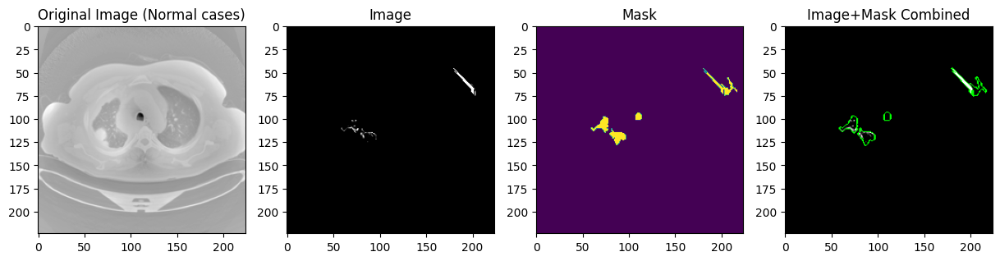

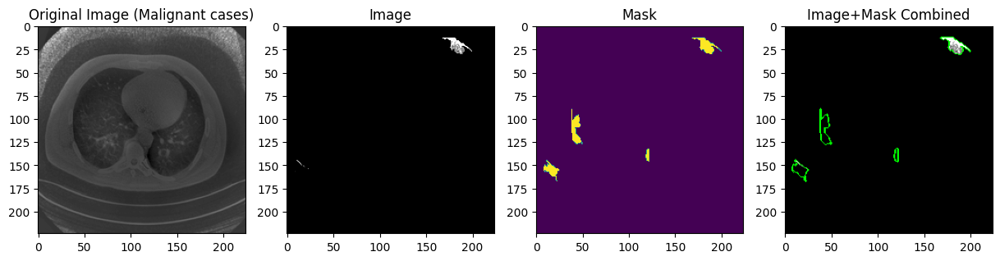

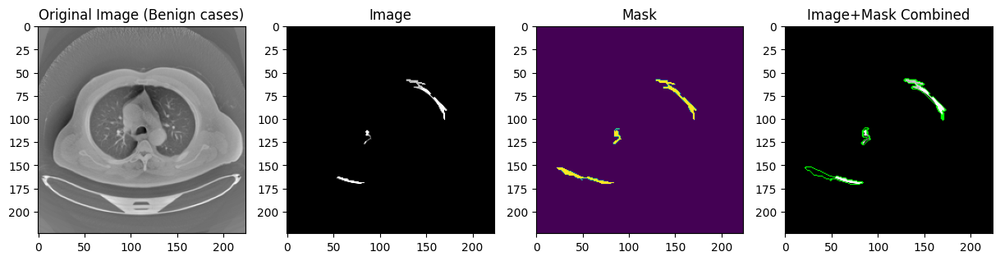

In [ ]:
import numpy as np
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

# Function to reshape the flattened image
def reshape_image(flattened_image):
    return flattened_image.reshape(224, 224)

# Function to make predictions on the reshaped and colored images
def make_predictions_on_categories(color_img):
    print(f"Shape of color_img before processing: {color_img.shape}")

    # Handle both single images and batches
    if len(color_img.shape) == 3:  # Single image
        gray_img = rgb2gray(color_img).reshape(1, 224, 224, 1)
    else:  # Batch of images
        gray_img = np.array([rgb2gray(img) for img in color_img])
        gray_img = gray_img.reshape(gray_img.shape[0], 224, 224, 1)

    print(f"Input shape for prediction: {gray_img.shape}")
    preds = model1.predict(gray_img)
    return preds

# Function to plot the comparison of images
def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15, 5))
    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224, 224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0, 1, 0)))
    ax.set_title("Image+Mask Combined")

# Assuming Y_test is already defined as the true labels for X_test
# Obtain predictions for the entire test set
# Check the shape of X_test before prediction
print(f"Shape of X_test before prediction: {X_test.shape}")

# Ensure X_test is correctly shaped
if len(X_test.shape) == 3:  # If the shape is (num_samples, height, width)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)
elif len(X_test.shape) == 2:  # If the shape is (num_samples, flattened_pixels)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)

# Print the shape again to confirm
print(f"Shape of X_test after reshaping: {X_test.shape}")

if len(X_test.shape) == 1:  # Check if X_test is a flattened array
    # Calculate the number of images in the batch
    num_images = X_test.size // (224 * 224)  # Total elements divided by one image size
    X_test = X_test.reshape(num_images, 224, 224, 1)  # Reshape into the correct batch size

print(f"Reshaped X_test shape: {X_test.shape}")

# Now, perform the prediction
Y_test_preds = model1.predict(X_test).argmax(axis=1)

for label_value, label_name in label_map.items(): # Switch the order of label_value and label_name
    # Filter misclassified instances for this category
    misclassified_indices = [i for i in category_indices[label_value] if y_test[i] != Y_test_preds[i]]

    if misclassified_indices:
        idx = misclassified_indices[0]  # Select the first misclassified image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Get the actual and predicted labels
        actual_label = y_test[idx]
        predicted_label = Y_test_preds[idx]

        # Print category, index, and label information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")
        print(f"Actual Label: {label_map[actual_label]}")
        print(f"Predicted Label: {label_map[predicted_label]}")
        print()

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Generate LIME explanation for the incorrect prediction
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get the image and mask for the misclassified sample
        predicted_class = Y_test_preds[idx]
        img, mask = explanation.get_image_and_mask(predicted_class, positive_only=True, hide_rest=True)

        # Print shape information for verification
        print(img.shape)
        print(mask.shape)

        # Plot the comparison between the original and the LIME explanation
        plot_comparison(X_test[idx], img, mask, label_name)

# FALSE PREDICTION USING felzenszwalb segmentation method - NEGATIVE CONTRIBUTION

Shape of X_test before prediction: (220, 224, 224, 1)
Shape of X_test after reshaping: (220, 224, 224, 1)
Reshaped X_test shape: (220, 224, 224, 1)
7/7 ━━━━━━━━━━━━━━━━━━━━ 23s 3s/step
Category: Normal cases
Index: 27
Shape of image: (224, 224)
Actual Label: Malignant cases
Predicted Label: Normal cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
Predictions: [[0.8360377  0.14794724 0.01601515]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 971ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 958ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 960ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Shape of color_img before

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 29
Shape of image: (224, 224)
Actual Label: Normal cases
Predicted Label: Malignant cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Predictions: [[0.12745327 0.8414592  0.03108755]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 951ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 951ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 962ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 950ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 953ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img 

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 2
Shape of image: (224, 224)
Actual Label: Normal cases
Predicted Label: Benign cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
Predictions: [[2.0265256e-01 1.1119385e-04 7.9723620e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 959ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 956ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 959ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 948ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 955ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 954ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 953ms/step
Shape of colo

(224, 224, 3)
(224, 224)


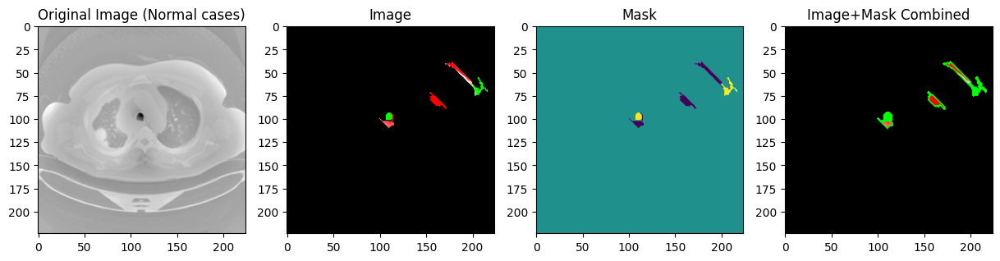

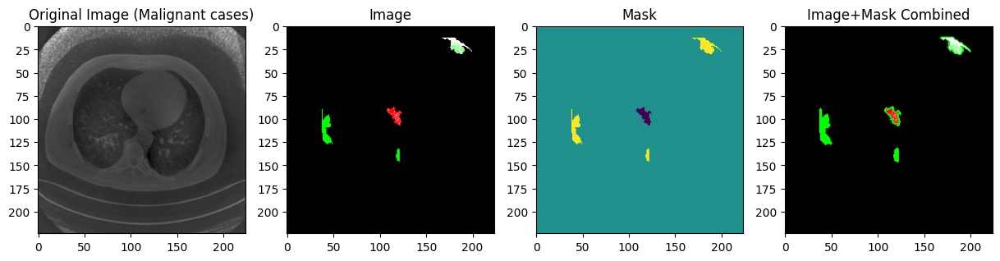

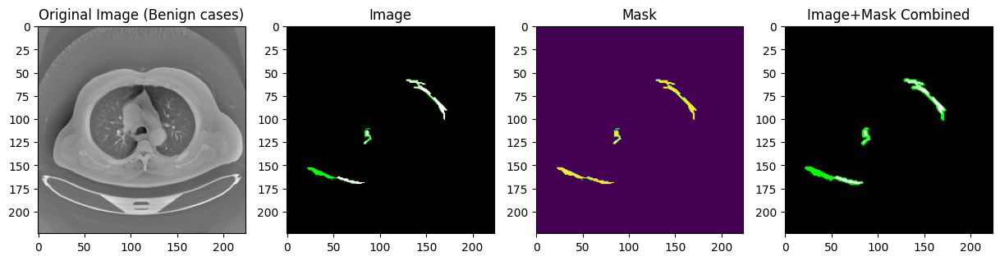

In [ ]:
import numpy as np
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

# Function to reshape the flattened image
def reshape_image(flattened_image):
    return flattened_image.reshape(224, 224)

# Function to make predictions on the reshaped and colored images
def make_predictions_on_categories(color_img):
    print(f"Shape of color_img before processing: {color_img.shape}")

    # Handle both single images and batches
    if len(color_img.shape) == 3:  # Single image
        gray_img = rgb2gray(color_img).reshape(1, 224, 224, 1)
    else:  # Batch of images
        gray_img = np.array([rgb2gray(img) for img in color_img])
        gray_img = gray_img.reshape(gray_img.shape[0], 224, 224, 1)

    print(f"Input shape for prediction: {gray_img.shape}")
    preds = model1.predict(gray_img)
    return preds

# Function to plot the comparison of images
def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15, 5))
    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224, 224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0, 1, 0)))
    ax.set_title("Image+Mask Combined")

# Assuming Y_test is already defined as the true labels for X_test
# Obtain predictions for the entire test set
# Check the shape of X_test before prediction
print(f"Shape of X_test before prediction: {X_test.shape}")

# Ensure X_test is correctly shaped
if len(X_test.shape) == 3:  # If the shape is (num_samples, height, width)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)
elif len(X_test.shape) == 2:  # If the shape is (num_samples, flattened_pixels)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)

# Print the shape again to confirm
print(f"Shape of X_test after reshaping: {X_test.shape}")

if len(X_test.shape) == 1:  # Check if X_test is a flattened array
    # Calculate the number of images in the batch
    num_images = X_test.size // (224 * 224)  # Total elements divided by one image size
    X_test = X_test.reshape(num_images, 224, 224, 1)  # Reshape into the correct batch size

print(f"Reshaped X_test shape: {X_test.shape}")

# Now, perform the prediction
Y_test_preds = model1.predict(X_test).argmax(axis=1)

for label_value, label_name in label_map.items(): # Switch the order of label_value and label_name
    # Filter misclassified instances for this category
    misclassified_indices = [i for i in category_indices[label_value] if y_test[i] != Y_test_preds[i]]

    if misclassified_indices:
        idx = misclassified_indices[0]  # Select the first misclassified image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Get the actual and predicted labels
        actual_label = y_test[idx]
        predicted_label = Y_test_preds[idx]

        # Print category, index, and label information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")
        print(f"Actual Label: {label_map[actual_label]}")
        print(f"Predicted Label: {label_map[predicted_label]}")
        print()

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Generate LIME explanation for the incorrect prediction
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get the image and mask for the misclassified sample
        predicted_class = Y_test_preds[idx]
        img, mask = explanation.get_image_and_mask(predicted_class, positive_only=False, hide_rest=True)

        # Print shape information for verification
        print(img.shape)
        print(mask.shape)

        # Plot the comparison between the original and the LIME explanation
        plot_comparison(X_test[idx], img, mask, label_name)

Shape of X_test before prediction: (220, 224, 224, 1)
Shape of X_test after reshaping: (220, 224, 224, 1)
Reshaped X_test shape: (220, 224, 224, 1)
7/7 ━━━━━━━━━━━━━━━━━━━━ 26s 3s/step
Category: Normal cases
Index: 27
Shape of image: (224, 224)
Actual Label: Malignant cases
Predicted Label: Normal cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
Predictions: [[0.8360377  0.14794724 0.01601515]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 981ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 972ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 968ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 984ms/step
Shape of color_img bef

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 29
Shape of image: (224, 224)
Actual Label: Normal cases
Predicted Label: Malignant cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
Predictions: [[0.12745327 0.8414592  0.03108755]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 976ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 960ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 949ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Shape of color_img before

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 2
Shape of image: (224, 224)
Actual Label: Normal cases
Predicted Label: Benign cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
Predictions: [[2.0265256e-01 1.1119385e-04 7.9723620e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 977ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 959ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 966ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 966ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Shape of color_img bef

(224, 224, 3)
(224, 224)


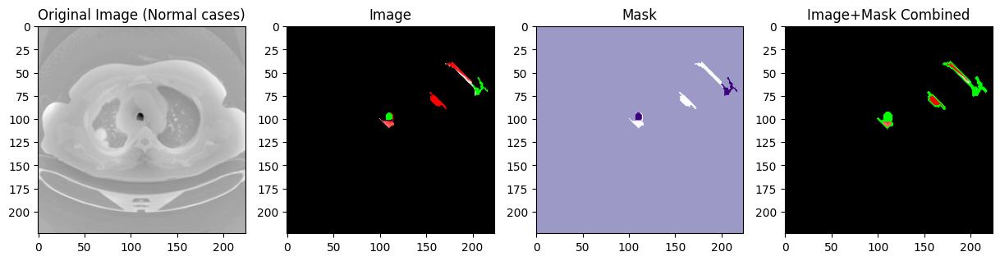

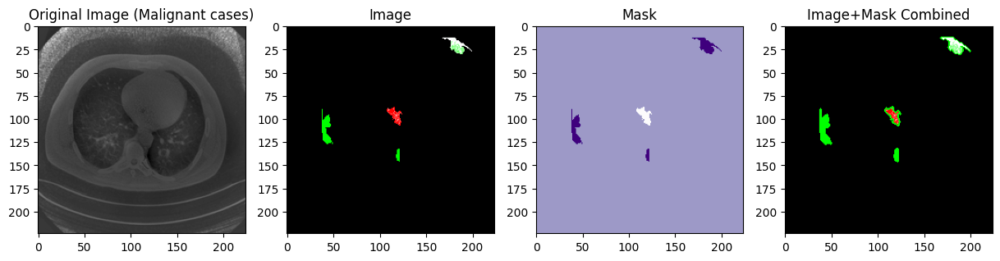

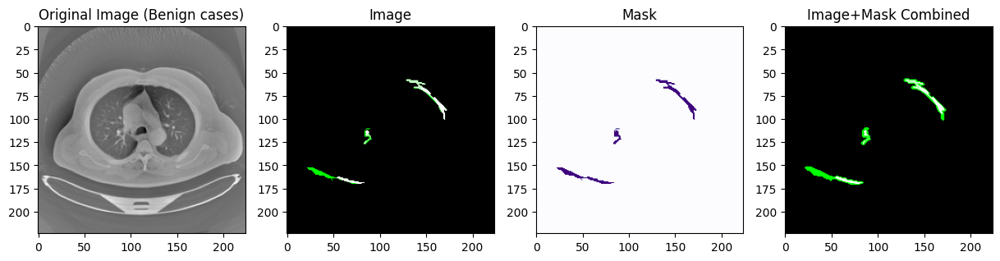

In [ ]:
import numpy as np
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

# Function to reshape the flattened image
def reshape_image(flattened_image):
    return flattened_image.reshape(224, 224)

# Function to make predictions on the reshaped and colored images
def make_predictions_on_categories(color_img):
    print(f"Shape of color_img before processing: {color_img.shape}")

    # Handle both single images and batches
    if len(color_img.shape) == 3:  # Single image
        gray_img = rgb2gray(color_img).reshape(1, 224, 224, 1)
    else:  # Batch of images
        gray_img = np.array([rgb2gray(img) for img in color_img])
        gray_img = gray_img.reshape(gray_img.shape[0], 224, 224, 1)

    print(f"Input shape for prediction: {gray_img.shape}")
    preds = model1.predict(gray_img)
    return preds

# Function to plot the comparison of images
def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15, 5))
    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224, 224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask, cmap='Purples')  # Set the mask color to purple
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0, 1, 0)))  # Boundary in green for visibility
    ax.set_title("Image+Mask Combined")

# Assuming Y_test is already defined as the true labels for X_test
# Obtain predictions for the entire test set
print(f"Shape of X_test before prediction: {X_test.shape}")

# Ensure X_test is correctly shaped
if len(X_test.shape) == 3:  # If the shape is (num_samples, height, width)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)
elif len(X_test.shape) == 2:  # If the shape is (num_samples, flattened_pixels)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)

print(f"Shape of X_test after reshaping: {X_test.shape}")

if len(X_test.shape) == 1:  # Check if X_test is a flattened array
    # Calculate the number of images in the batch
    num_images = X_test.size // (224 * 224)  # Total elements divided by one image size
    X_test = X_test.reshape(num_images, 224, 224, 1)  # Reshape into the correct batch size

print(f"Reshaped X_test shape: {X_test.shape}")

# Now, perform the prediction
Y_test_preds = model1.predict(X_test).argmax(axis=1)

for label_value, label_name in label_map.items(): # Switch the order of label_value and label_name
    # Filter misclassified instances for this category
    misclassified_indices = [i for i in category_indices[label_value] if y_test[i] != Y_test_preds[i]]

    if misclassified_indices:
        idx = misclassified_indices[0]  # Select the first misclassified image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Get the actual and predicted labels
        actual_label = y_test[idx]
        predicted_label = Y_test_preds[idx]

        # Print category, index, and label information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")
        print(f"Actual Label: {label_map[actual_label]}")
        print(f"Predicted Label: {label_map[predicted_label]}")
        print()

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Generate LIME explanation for the incorrect prediction
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get the image and mask for the misclassified sample
        predicted_class = Y_test_preds[idx]
        img, mask = explanation.get_image_and_mask(predicted_class, positive_only=False, hide_rest=True)

        # Print shape information for verification
        print(img.shape)
        print(mask.shape)

        # Plot the comparison between the original and the LIME explanation
        plot_comparison(X_test[idx], img, mask, label_name)


# LIME EXPLANATIONS IN A DIFFERENT WAY

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 625ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 610ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

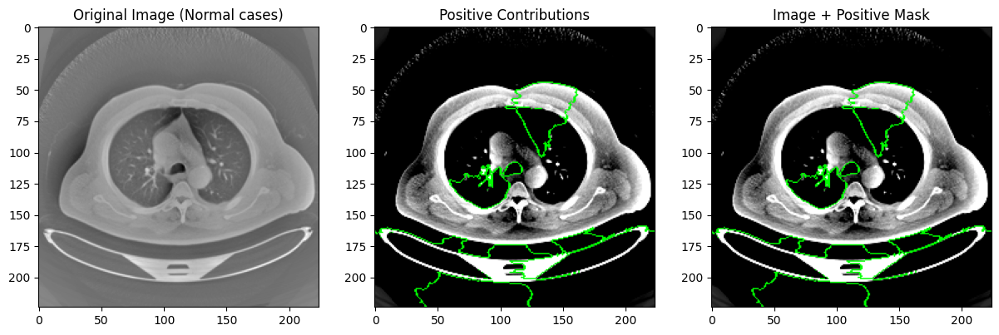

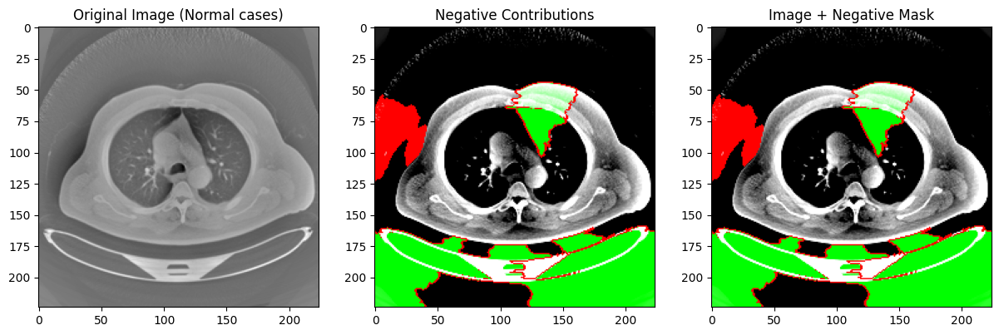

Generating explanation for: Malignant cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

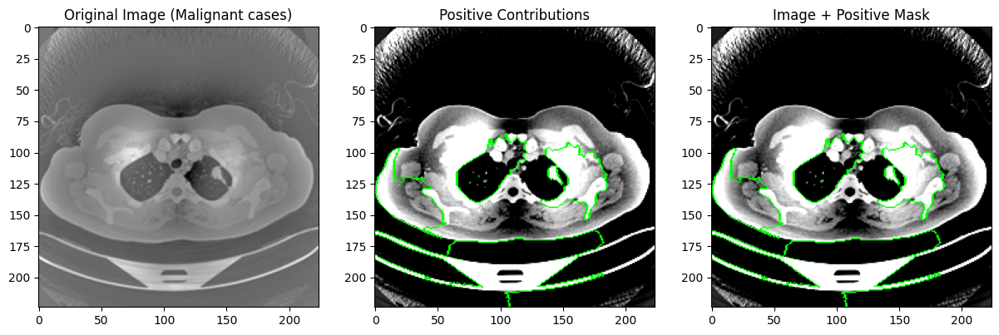

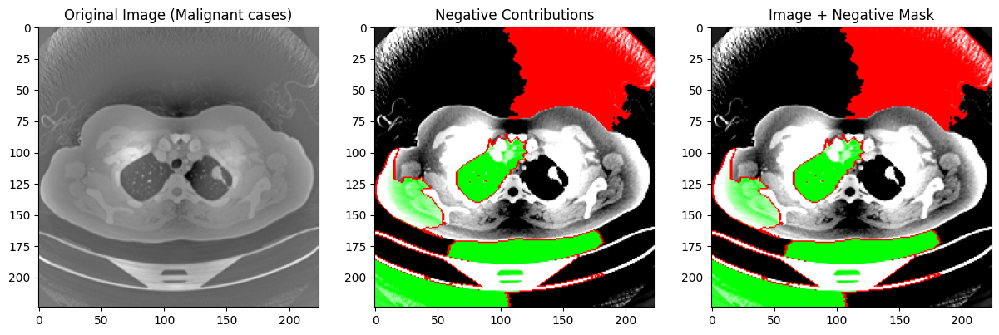

Generating explanation for: Benign cases (Image index: 1)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 610ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

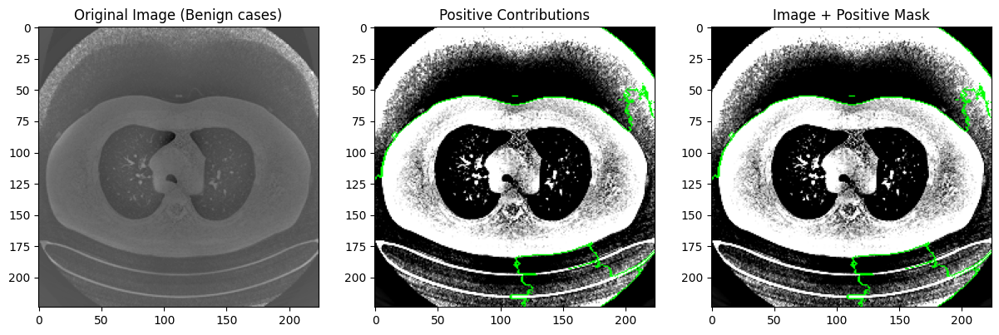

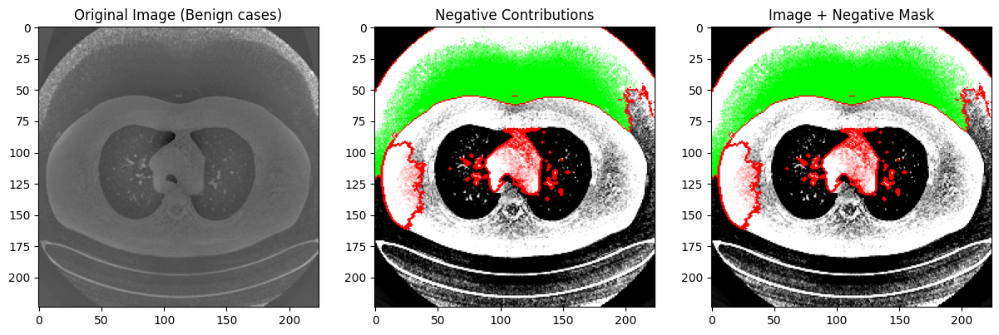

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model1.predict(image)
    return preds

# Function to plot the comparison
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries

def plot_positive_contributions(main_image, img_pos, mask_pos, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Positive Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Positive Mask")

    plt.show()

def plot_negative_contributions(main_image, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Negative Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_neg, mask_neg, color=(1, 0, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Negative Mask")

    plt.show()


# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model1.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_positive_contributions(X_test_reshaped[idx], img_pos, mask_pos, label_name)
        plot_negative_contributions(X_test_reshaped[idx], img_neg, mask_neg, label_name)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 614ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 627ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

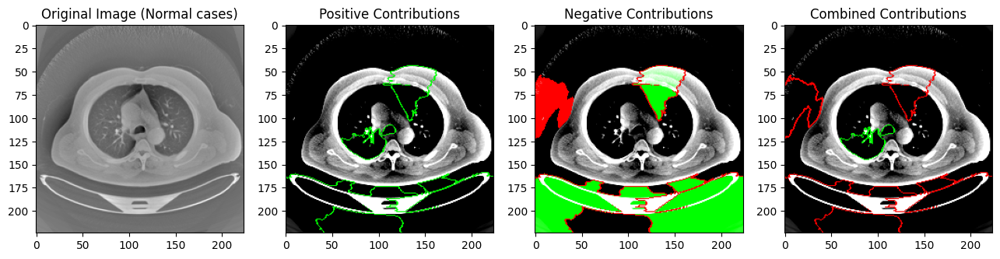

Generating explanation for: Malignant cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 614ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 607ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 620ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

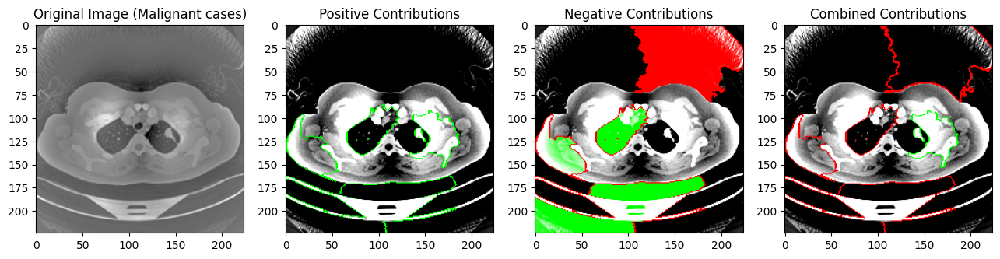

Generating explanation for: Benign cases (Image index: 1)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

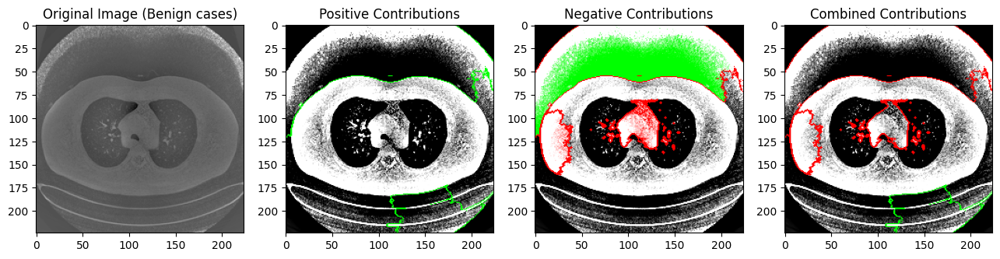

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model1.predict(image)
    return preds

# Function to plot the comparison
def plot_comparison(main_image, img_pos, mask_pos, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    ax = fig.add_subplot(151)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    ax = fig.add_subplot(152)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    ax = fig.add_subplot(153)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    ax = fig.add_subplot(154)
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    # Apply negative mask without alpha, as it's not supported in older versions
    combined_img = mark_boundaries(combined_img, mask_neg, color=(1, 0, 0))
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Combined Contributions")

    plt.show()

# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model1.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_comparison(X_test_reshaped[idx], img_pos, mask_pos, img_neg, mask_neg, label_name)
        #plot_comparison(X_test_reshaped[idx], img_pos, mask_pos)
        #plot_comparison(X_test_reshaped[idx], img_neg, mask_neg)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

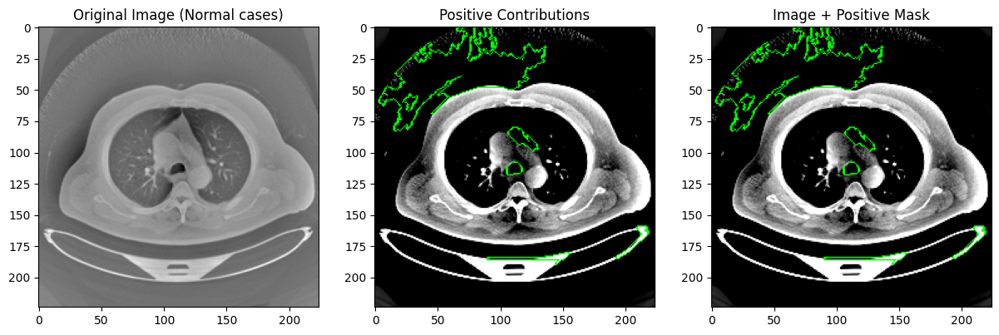

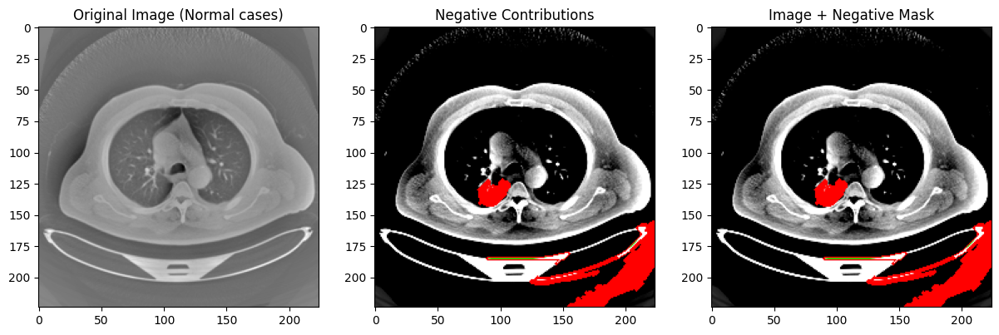

Generating explanation for: Malignant cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 617ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

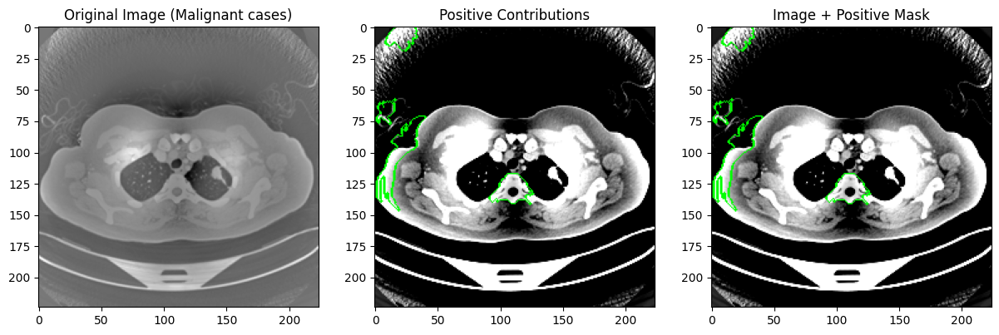

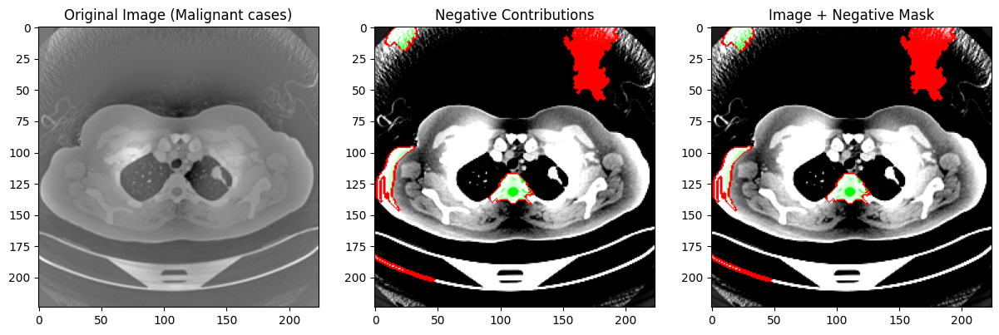

Generating explanation for: Benign cases (Image index: 1)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 735ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 596ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 609ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

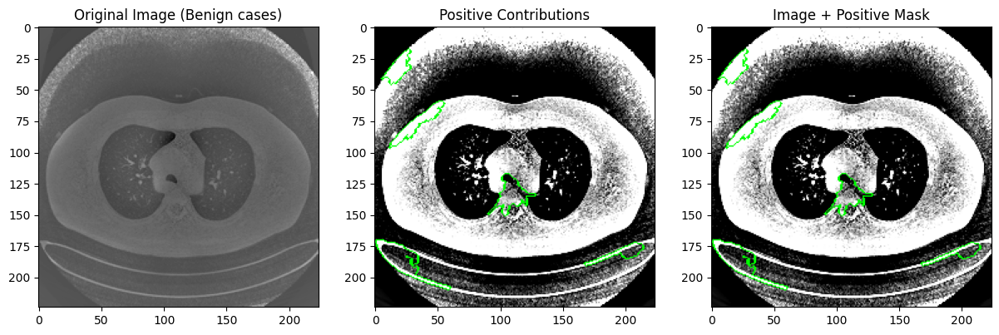

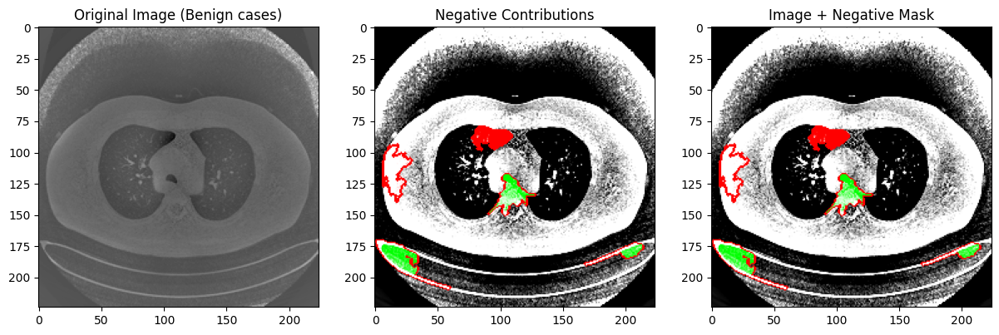

In [ ]:
# Lime using felzenszwalb segmentation method
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, felzenszwalb
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model1.predict(image)
    return preds

# Function to plot the comparison
def plot_positive_contributions(main_image, img_pos, mask_pos, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Positive Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Positive Mask")

    plt.show()

def plot_negative_contributions(main_image, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Negative Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_neg, mask_neg, color=(1, 0, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Negative Mask")

    plt.show()


# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model1.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label using felzenszwalb segmentation
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            segmentation_fn=lambda x: felzenszwalb(x, scale=100, sigma=0.5, min_size=50),
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_positive_contributions(X_test_reshaped[idx], img_pos, mask_pos, label_name)
        plot_negative_contributions(X_test_reshaped[idx], img_neg, mask_neg, label_name)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

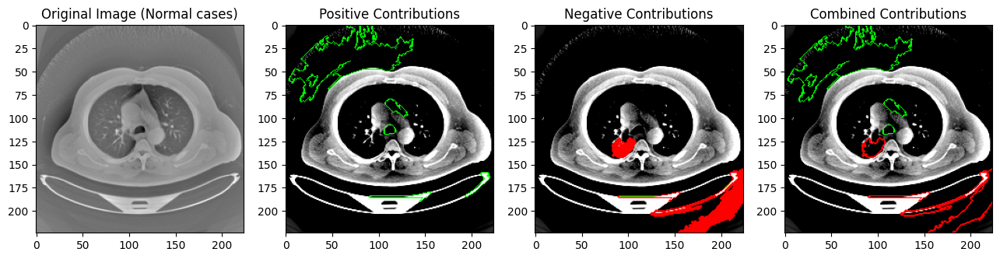

Generating explanation for: Malignant cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

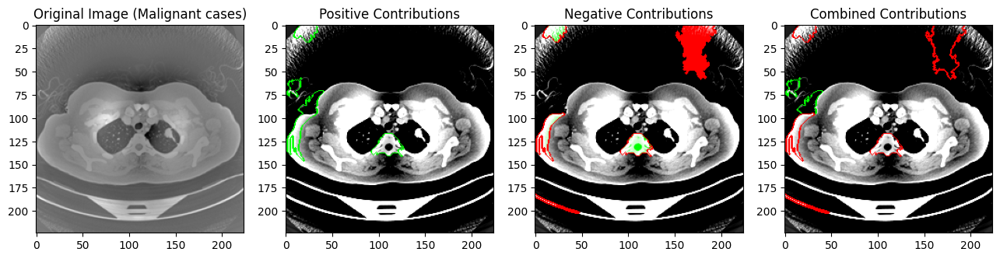

Generating explanation for: Benign cases (Image index: 1)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 615ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

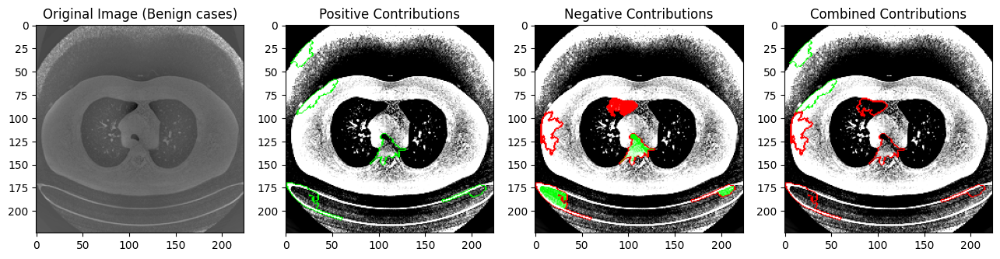

In [ ]:
# Lime using felzenszwalb segmentation method
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, felzenszwalb
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model1.predict(image)
    return preds

# Function to plot the comparison
def plot_comparison(main_image, img_pos, mask_pos, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    ax = fig.add_subplot(151)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    ax = fig.add_subplot(152)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    ax = fig.add_subplot(153)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    ax = fig.add_subplot(154)
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    combined_img = mark_boundaries(combined_img, mask_neg, color=(1, 0, 0))
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Combined Contributions")

    plt.show()

# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model1.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label using felzenszwalb segmentation
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            segmentation_fn=lambda x: felzenszwalb(x, scale=100, sigma=0.5, min_size=50),  # Customize segmentation parameters
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_comparison(X_test_reshaped[idx], img_pos, mask_pos, img_neg, mask_neg, label_name)


# Model 2

In [ ]:
model2 = Sequential()

model2.add(Conv2D(8, (3, 3), input_shape=(224,224,1)))
model2.add(Activation('relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.65))

model2.add(Conv2D(16, (3, 3), activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.65))
model2.add(Conv2D(32, (3, 3), activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.65))

model2.add(Flatten())
model2.add(Dense(16))
model2.add(Dense(3, activation='softmax'))

model2.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_14 (Conv2D)                   │ (None, 222, 222, 8)         │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_5 (Activation)            │ (None, 222, 222, 8)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_14 (MaxPooling2D)      │ (None, 111, 111, 8)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_10 (Dropout)                 │ (None, 111, 111, 8)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_15 (Conv2D)                   │ (None, 109, 109, 16)        │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_15 (MaxPooling2D)      │ (None, 54, 54, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_11 (Dropout)                 │ (None, 54, 54, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_16 (Conv2D)                   │ (None, 52, 52, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_16 (MaxPooling2D)      │ (None, 26, 26, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_12 (Dropout)                 │ (None, 26, 26, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_5 (Flatten)                  │ (None, 21632)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 16)                  │         346,128 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 3)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 352,067 (1.34 MB)

 Trainable params: 352,067 (1.34 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model2 = Sequential()

model2.add(Conv2D(8, (3, 3), input_shape=(224,224,1)))
model2.add(Activation('relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.75))

model2.add(Conv2D(16, (3, 3), activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.75))
model2.add(Conv2D(32, (3, 3), activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.75))

model2.add(Flatten())
model2.add(Dense(16))
model2.add(Dense(3, activation='softmax'))

model2.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_11 (Conv2D)                   │ (None, 222, 222, 8)         │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_4 (Activation)            │ (None, 222, 222, 8)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_11 (MaxPooling2D)      │ (None, 111, 111, 8)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 111, 111, 8)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_12 (Conv2D)                   │ (None, 109, 109, 16)        │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_12 (MaxPooling2D)      │ (None, 54, 54, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_8 (Dropout)                  │ (None, 54, 54, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_13 (Conv2D)                   │ (None, 52, 52, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_13 (MaxPooling2D)      │ (None, 26, 26, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_9 (Dropout)                  │ (None, 26, 26, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_4 (Flatten)                  │ (None, 21632)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 16)                  │         346,128 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 3)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 352,067 (1.34 MB)

 Trainable params: 352,067 (1.34 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Overitted
model2 = Sequential()

model2.add(Conv2D(64, (3, 3), input_shape=(224,224,1)))
model2.add(Activation('relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))

model2.add(Conv2D(64, (3, 3), activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))
model1.add(Dropout(0.5))
model2.add(Conv2D(64, (3, 3), activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))

model2.add(Flatten())
model2.add(Dense(16))
model2.add(Dense(3, activation='softmax'))

model2.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)                    │ (None, 222, 222, 64)        │             640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_1 (Activation)            │ (None, 222, 222, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 111, 111, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 109, 109, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 54, 54, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 52, 52, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 26, 26, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 43264)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 16)                  │         692,240 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 766,787 (2.93 MB)

 Trainable params: 766,787 (2.93 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model2.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
new_weights = {
    0: X_train.shape[0]/(2*Counter(y_train)[0]),
    1: X_train.shape[0]/(2*Counter(y_train)[1]),
    2: X_train.shape[0]/(2*Counter(y_train)[2]),
}

# new_weights[0] = 0.5
# new_weights[1] = 20

new_weights

{0: 1.3176691729323309, 1: 0.979050279329609, 2: 4.5519480519480515}

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint


# Define early stopping callback
early_stopping = EarlyStopping(monitor='val_loss',  # Monitor validation loss
                               patience=3,         # Number of epochs with no improvement after which training will be stopped
                               restore_best_weights=True)  # Restore weights to the best model observed during training

# Define model checkpoint callback to save the best model during training
checkpoint = ModelCheckpoint('minor_model_2.keras',  # Filepath to save the best model
                             monitor='val_loss',  # Monitor validation loss
                             save_best_only=True,  # Save only the best model
                             mode='min',          # Mode of monitoring (minimize validation loss)
                             verbose=1)           # Verbosity mode (1 for updates)


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint


# Define early stopping callback
early_stopping = EarlyStopping(monitor='val_loss',  # Monitor validation loss
                               patience=3,         # Number of epochs with no improvement after which training will be stopped
                               restore_best_weights=True)  # Restore weights to the best model observed during training

# Define model checkpoint callback to save the best model during training
checkpoint = ModelCheckpoint('minor_project_model_2.keras',  # Filepath to save the best model
                             monitor='val_loss',  # Monitor validation loss
                             save_best_only=True,  # Save only the best model
                             mode='min',          # Mode of monitoring (minimize validation loss)
                             verbose=1)           # Verbosity mode (1 for updates)


In [ ]:
print(f"X_train_resampled shape: {X_train_resampled.shape}")
print(f"y_train_resampled shape: {y_train_resampled.shape}")


X_train_resampled shape: (1074, 50176)
y_train_resampled shape: (1074,)


In [ ]:
# Reshape X_train_resampled to the expected format
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 1)

# Print shapes and data types for debugging
print(f"X_train_resampled shape: {X_train_resampled.shape}")
print(f"y_train_resampled shape: {y_train_resampled.shape}")

X_train_resampled shape: (1074, 224, 224, 1)
y_train_resampled shape: (1074,)


In [ ]:
history = model2.fit(X_train_resampled, y_train_resampled,
                    batch_size=8, epochs=20,
                    validation_split=0.2,
                    class_weight=new_weights,
                    callbacks=[early_stopping, checkpoint])

print("Fit method completed.")  # Check if fit method runs to completion
print(f"History object: {history}")  # Inspect the returned history object

Epoch 1/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - accuracy: 0.4210 - loss: 9.0345
Epoch 1: val_loss improved from inf to 1.05782, saving model to minor_project_model_2.keras
108/108 ━━━━━━━━━━━━━━━━━━━━ 29s 253ms/step - accuracy: 0.4215 - loss: 8.9928 - val_accuracy: 0.8930 - val_loss: 1.0578
Epoch 2/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step - accuracy: 0.6136 - loss: 1.4394
Epoch 2: val_loss did not improve from 1.05782
108/108 ━━━━━━━━━━━━━━━━━━━━ 45s 287ms/step - accuracy: 0.6138 - loss: 1.4389 - val_accuracy: 0.7023 - val_loss: 1.0724
Epoch 3/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step - accuracy: 0.6488 - loss: 1.4105
Epoch 3: val_loss did not improve from 1.05782
108/108 ━━━━━━━━━━━━━━━━━━━━ 39s 272ms/step - accuracy: 0.6488 - loss: 1.4098 - val_accuracy: 0.8884 - val_loss: 1.0579
Epoch 4/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - accuracy: 0.7234 - loss: 1.0808
Epoch 4: val_loss improved from 1.05782 to 1.04277, saving model to minor_project_model_2.keras
108/10

In [ ]:
history = model2.fit(X_train_resampled, y_train_resampled,
                    batch_size=8, epochs=20,
                    validation_split=0.2,
                    class_weight=new_weights,
                    callbacks=[early_stopping, checkpoint])

Epoch 1/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.4908 - loss: 6.3952
Epoch 1: val_loss improved from inf to 1.06050, saving model to minor_model_2.keras
108/108 ━━━━━━━━━━━━━━━━━━━━ 42s 333ms/step - accuracy: 0.4912 - loss: 6.3684 - val_accuracy: 0.6512 - val_loss: 1.0605
Epoch 2/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step - accuracy: 0.6379 - loss: 1.3745
Epoch 2: val_loss improved from 1.06050 to 1.00887, saving model to minor_model_2.keras
108/108 ━━━━━━━━━━━━━━━━━━━━ 28s 263ms/step - accuracy: 0.6380 - loss: 1.3739 - val_accuracy: 0.8651 - val_loss: 1.0089
Epoch 3/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - accuracy: 0.7120 - loss: 1.1258
Epoch 3: val_loss improved from 1.00887 to 0.94684, saving model to minor_model_2.keras
108/108 ━━━━━━━━━━━━━━━━━━━━ 39s 246ms/step - accuracy: 0.7120 - loss: 1.1256 - val_accuracy: 0.9256 - val_loss: 0.9468
Epoch 4/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step - accuracy: 0.7612 - loss: 0.9455
Epoch 4: val_loss improved f

In [ ]:
X_test_reshaped = X_test.reshape(-1, 224, 224, 1)

# Now use the reshaped data for prediction
y_pred = model2.predict(X_test_reshaped, verbose=1)
y_pred_bool = np.argmax(y_pred, axis=1)

7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 225ms/step


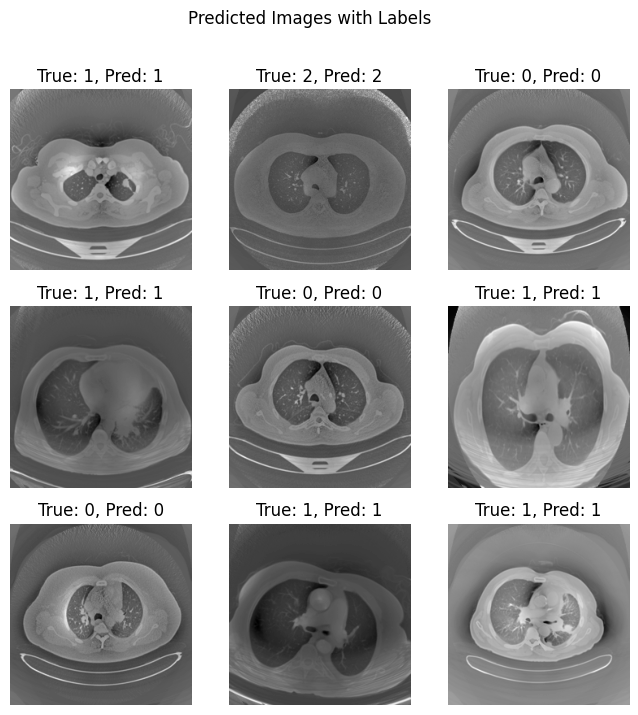

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(8, 8))
fig.suptitle('Predicted Images with Labels')

for i, ax in enumerate(axes.flat):
    ax.imshow(X_test[i].reshape(img_size, img_size, 1), cmap='gray')
    true_label = y_test[i]  # Integer-encoded label
    pred_label = y_pred_bool[i]
    ax.set_title(f'True: {true_label}, Pred: {pred_label}')
    ax.axis('off')

plt.show()

In [ ]:
print(classification_report(y_test, y_pred_bool))
print(confusion_matrix(y_true=y_test, y_pred=y_pred_bool))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        83
           1       1.00      1.00      1.00       113
           2       1.00      1.00      1.00        24

    accuracy                           1.00       220
   macro avg       1.00      1.00      1.00       220
weighted avg       1.00      1.00      1.00       220

[[ 83   0   0]
 [  0 113   0]
 [  0   0  24]]


In [ ]:
print(classification_report(y_test, y_pred_bool))
print(confusion_matrix(y_true=y_test, y_pred=y_pred_bool))

              precision    recall  f1-score   support

           0       1.00      0.96      0.98        83
           1       1.00      1.00      1.00       113
           2       0.89      1.00      0.94        24

    accuracy                           0.99       220
   macro avg       0.96      0.99      0.97       220
weighted avg       0.99      0.99      0.99       220

[[ 80   0   3]
 [  0 113   0]
 [  0   0  24]]


In [ ]:
# new model accuracy
print(classification_report(y_test, y_pred_bool))
print(confusion_matrix(y_true=y_test, y_pred=y_pred_bool))

              precision    recall  f1-score   support

           0       0.97      0.34      0.50        83
           1       0.83      0.96      0.89       113
           2       0.31      0.79      0.45        24

    accuracy                           0.70       220
   macro avg       0.70      0.69      0.61       220
weighted avg       0.82      0.70      0.69       220

[[ 28  17  38]
 [  1 108   4]
 [  0   5  19]]


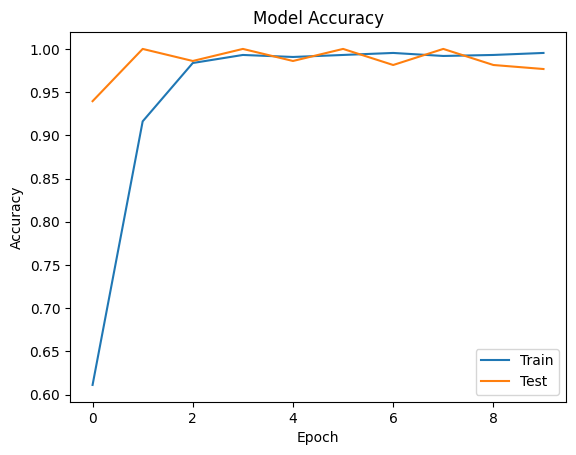

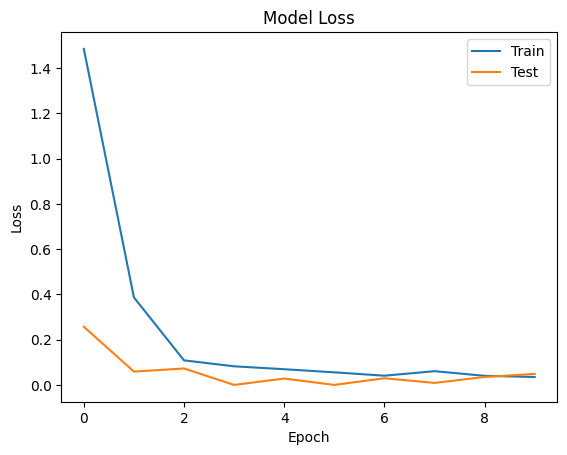

In [ ]:
plt.plot(history.history['accuracy'], label='Train')
plt.plot(history.history['val_accuracy'], label='Test')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='Train')
plt.plot(history.history['val_loss'], label='Test')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# TRUE PREDICTION – POSITIVE CONTRIBUTION

In [ ]:
!pip install lime
from lime import lime_image
explainer = lime_image.LimeImageExplainer(random_state=123)

explainer

In [ ]:
# Ensure the image dimensions are correctly defined
IMAGE_HEIGHT = 224
IMAGE_WIDTH = 224
IMAGE_CHANNELS = 1  # For grayscale images

# Function to reshape flattened image to its original dimensions
def reshape_image(flattened_image):
    return flattened_image.reshape(IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS)  # Reshape to (224, 224, 1)

# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test)):
    flattened_image = X_test[i]
    image = reshape_image(flattened_image)  # Reshape to (224, 224, 1)

    pred_label = model2.predict(image.reshape(1, IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Print the shape of the first image of each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")
        print()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1

Category: Normal cases
Index: 2
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Shape of model predictions: (1, 3)
Predictions: [[0.5412105  0.01138452 0.447405  ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━

Shape of model predictions: (10, 3)
(224, 224, 3)
(224, 224)


Category: Malignant cases
Index: 0
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Shape of model predictions: (1, 3)
Predictions: [[0.08207738 0.90723246 0.01069013]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━

Category: Benign cases
Index: 1
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Shape of model predictions: (1, 3)
Predictions: [[4.8127558e-02 3.6678761e-05 9.5183581e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━

Shape of model predictions: (10, 3)
(224, 224, 3)
(224, 224)


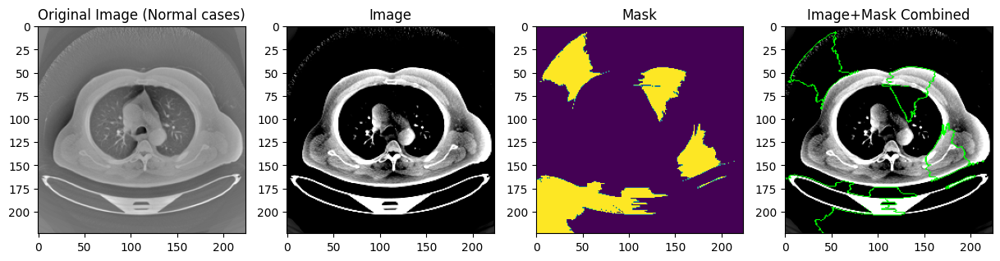

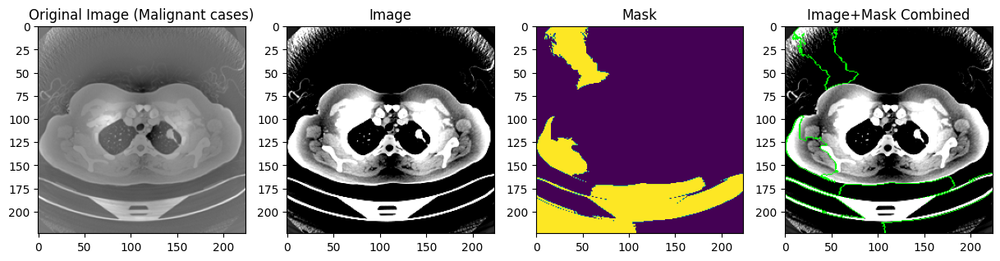

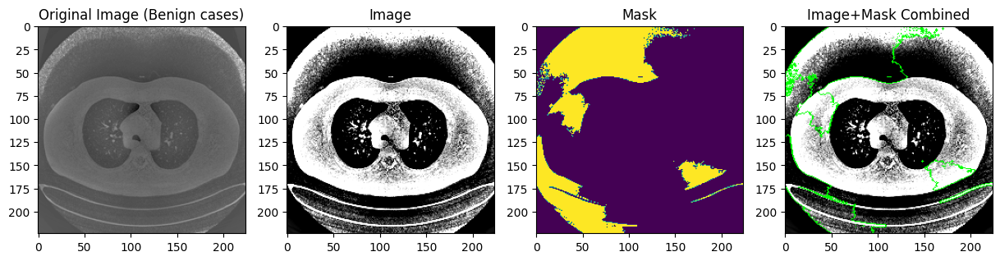

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (224x224)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(gray_img):
    # Prepare the grayscale image for prediction
    gray_img_reshaped = gray_img.reshape(-1, 224, 224, 1)

    # Debugging: Print the shape of the input image
    print(f"Shape of input to model: {gray_img_reshaped.shape}")

    # Get predictions for the image
    preds = model2.predict(gray_img_reshaped)

    # Debugging: Print the shape of the prediction output
    print(f"Shape of model predictions: {preds.shape}")

    # Return the prediction probabilities
    return preds

from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray");
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img);
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask);
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)));
    ax.set_title("Image+Mask Combined");

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB for LIME, and make predictions using grayscale
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(image)  # Pass the grayscale image for prediction

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # LIME needs to call a function that returns just the predictions
        explanation = explainer.explain_instance(colored_image,  # Use RGB image for explanation
                                                 lambda x: make_predictions_on_categories(rgb2gray(x)),
                                                 random_seed=123)

        # Get the image and mask for negative contributions
        img, mask = explanation.get_image_and_mask(y_test[idx], positive_only=True, hide_rest=False)

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# TRUE PREDICTION – NEGATIVE CONTRIBUTION

Category: Normal cases
Index: 2
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
Shape of model predictions: (1, 3)
Predictions: [[0.5412105  0.01138452 0.447405  ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━

(224, 224, 3)
(224, 224)


Category: Malignant cases
Index: 0
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
Shape of model predictions: (1, 3)
Predictions: [[0.08207738 0.90723246 0.01069013]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━

(224, 224, 3)
(224, 224)


Category: Benign cases
Index: 1
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Shape of model predictions: (1, 3)
Predictions: [[4.8127558e-02 3.6678761e-05 9.5183581e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━

(224, 224, 3)
(224, 224)


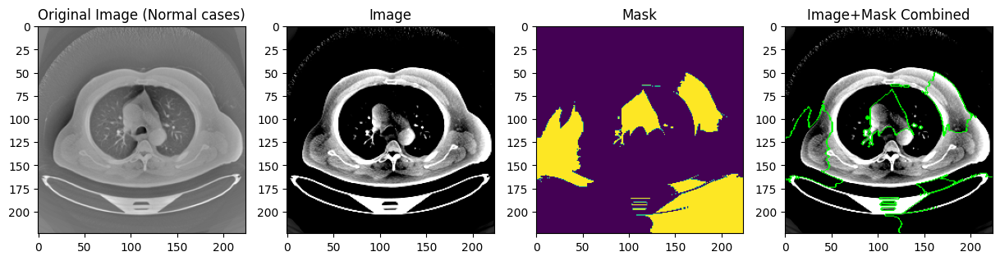

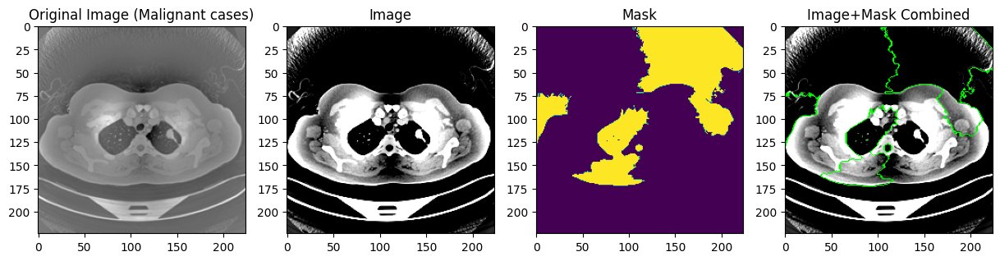

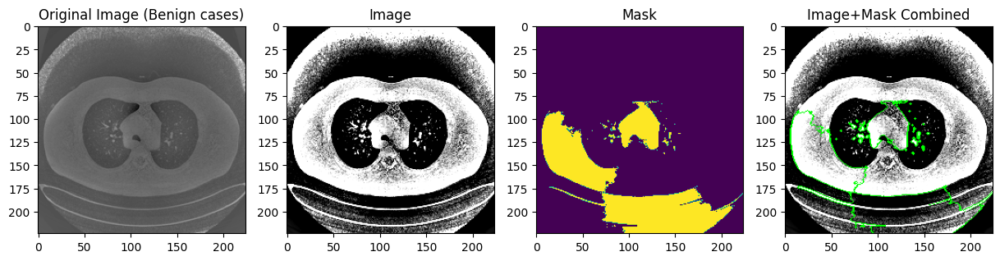

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (224x224)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(gray_img):
    # Prepare the grayscale image for prediction
    gray_img_reshaped = gray_img.reshape(-1, 224, 224, 1)

    # Debugging: Print the shape of the input image
    print(f"Shape of input to model: {gray_img_reshaped.shape}")

    # Get predictions for the image
    preds = model2.predict(gray_img_reshaped)

    # Debugging: Print the shape of the prediction output
    print(f"Shape of model predictions: {preds.shape}")

    # Return the prediction probabilities
    return preds

from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray");
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img);
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask);
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)));
    ax.set_title("Image+Mask Combined");

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB for LIME, and make predictions using grayscale
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(image)  # Pass the grayscale image for prediction

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # LIME needs to call a function that returns just the predictions
        explanation = explainer.explain_instance(colored_image,  # Use RGB image for explanation
                                                 lambda x: make_predictions_on_categories(rgb2gray(x)),
                                                 random_seed=123)

        # Get the image and mask for negative contributions
        img, mask = explanation.get_image_and_mask(y_test[idx], positive_only=False, negative_only=True, hide_rest=False)

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# TRUE PREDICTION USING felzenszwalb segmentation method - POSITIVE CONTRIBUTION

Category: Normal cases
Index: 2
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Predictions: [[0.5412105  0.01138452 0.447405  ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 0
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Predictions: [[0.08207738 0.90723246 0.01069013]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 1
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Predictions: [[4.8127558e-02 3.6678761e-05 9.5183581e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/s

(224, 224, 3)
(224, 224)


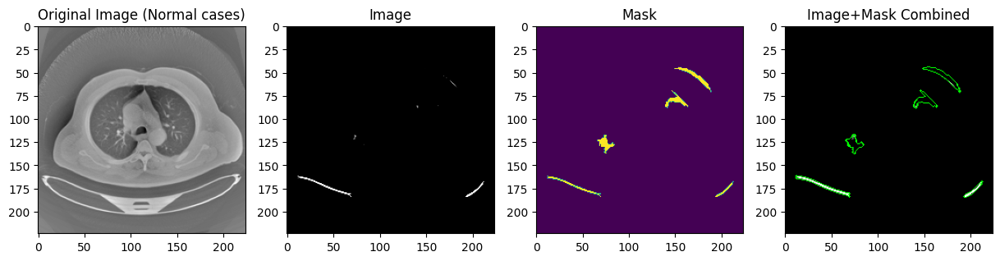

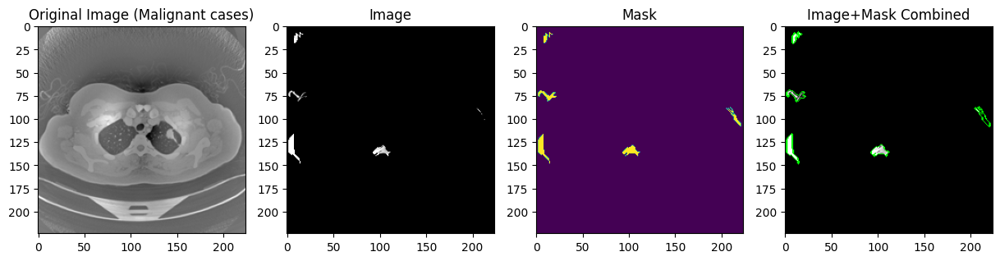

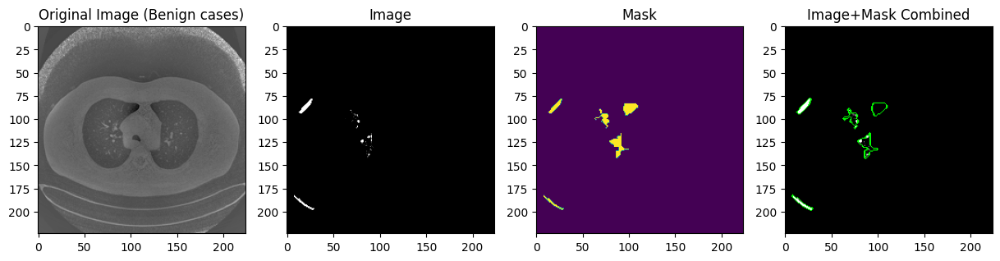

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (28x28)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(color_img):
    # Convert the RGB image to grayscale
    gray_img = rgb2gray(color_img).reshape(-1, 224, 224, 1)

    # Get predictions for the image
    preds = model2.predict(gray_img)

    # Return the prediction probabilities as a 2D array
    return preds

from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray");
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img);
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask);
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)));
    ax.set_title("Image+Mask Combined");

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Pass the reshaped image (squeeze to remove the single channel dimension)
        explanation = explainer.explain_instance(colored_image, make_predictions_on_categories,
                                         segmentation_fn=felzenszwalb, random_seed=123)

        img, mask = explanation.get_image_and_mask(y_test[idx], positive_only=True, hide_rest=True)

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# TRUE PREDICTION USING felzenszwalb segmentation method - NEGATIVE CONTRIBUTION

Category: Normal cases
Index: 2
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
Predictions: [[0.5412105  0.01138452 0.447405  ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

Category: Malignant cases
Index: 0
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Predictions: [[0.08207738 0.90723246 0.01069013]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 1
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Predictions: [[4.8127558e-02 3.6678761e-05 9.5183581e-01]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/st

(224, 224, 3)
(224, 224)


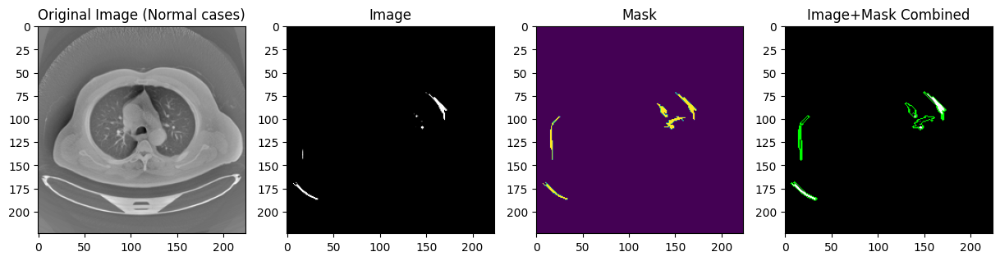

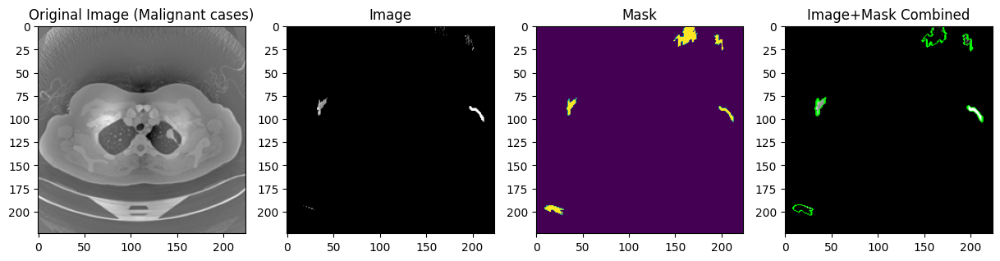

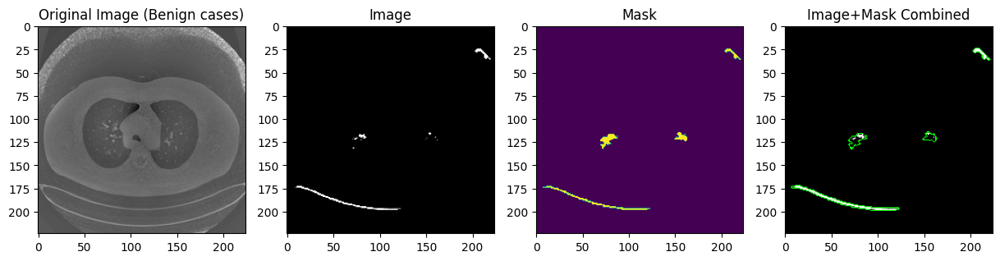

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (224x224)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(color_img):
    # Convert the RGB image to grayscale
    gray_img = rgb2gray(color_img).reshape(-1, 224, 224, 1)

    # Get predictions for the image
    preds = model2.predict(gray_img)

    # Return the prediction probabilities as a 2D array
    return preds

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)))
    ax.set_title("Image+Mask Combined")

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Pass the reshaped image (squeeze to remove the single channel dimension)
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get image and mask for negative contributions
        img, mask = explanation.get_image_and_mask(
            y_test[idx],
            positive_only=False,  # Set to False to include negative contributions
            negative_only=True,    # Set to True to focus only on negative contributions
            hide_rest=True
        )

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# FALSE PREDICTION USING felzenszwalb segmentation method - POSITIVE CONTRIBUTION

In [ ]:
# Load the trained model
model2 = tf.keras.models.load_model('/content/minor_project_model_2.keras')

Shape of X_test before prediction: (220, 224, 224, 1)
Shape of X_test after reshaping: (220, 224, 224, 1)
Reshaped X_test shape: (220, 224, 224, 1)
7/7 ━━━━━━━━━━━━━━━━━━━━ 3s 382ms/step
Category: Normal cases
Index: 2
Shape of image: (224, 224)
Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Predictions: [[0.33030933 0.323463   0.34622762]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
Shape of colo

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 104
Shape of image: (224, 224)
Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Predictions: [[0.31790435 0.33946452 0.3426311 ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
Shape of color_im

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 42
Shape of image: (224, 224)
Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
Predictions: [[0.32546887 0.32866782 0.3458633 ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
Shape of colo

(224, 224, 3)
(224, 224)


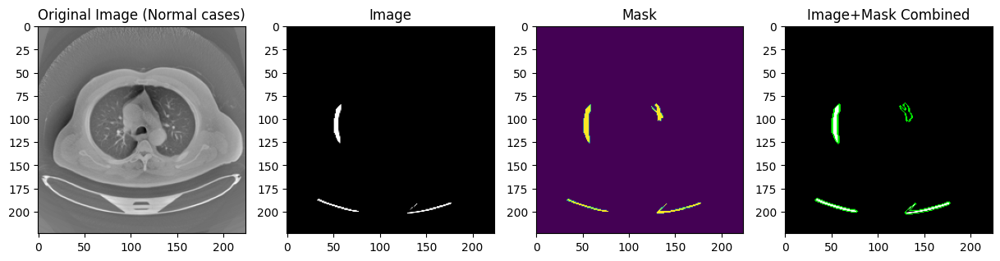

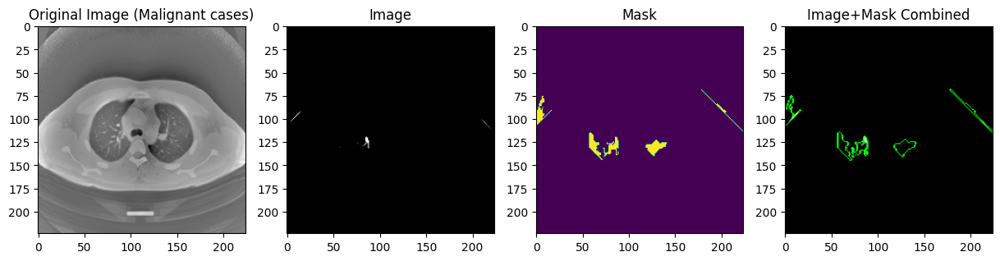

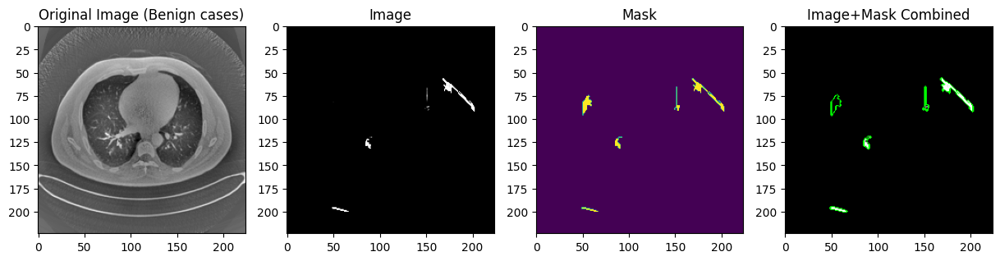

In [ ]:
import numpy as np
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

# Function to reshape the flattened image
def reshape_image(flattened_image):
    return flattened_image.reshape(224, 224)

# Function to make predictions on the reshaped and colored images
def make_predictions_on_categories(color_img):
    print(f"Shape of color_img before processing: {color_img.shape}")

    # Handle both single images and batches
    if len(color_img.shape) == 3:  # Single image
        gray_img = rgb2gray(color_img).reshape(1, 224, 224, 1)
    else:  # Batch of images
        gray_img = np.array([rgb2gray(img) for img in color_img])
        gray_img = gray_img.reshape(gray_img.shape[0], 224, 224, 1)

    print(f"Input shape for prediction: {gray_img.shape}")
    preds = model2.predict(gray_img)
    return preds

# Function to plot the comparison of images
def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15, 5))
    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224, 224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0, 1, 0)))
    ax.set_title("Image+Mask Combined")

# Assuming Y_test is already defined as the true labels for X_test
# Obtain predictions for the entire test set
# Check the shape of X_test before prediction
print(f"Shape of X_test before prediction: {X_test.shape}")

# Ensure X_test is correctly shaped
if len(X_test.shape) == 3:  # If the shape is (num_samples, height, width)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)
elif len(X_test.shape) == 2:  # If the shape is (num_samples, flattened_pixels)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)

# Print the shape again to confirm
print(f"Shape of X_test after reshaping: {X_test.shape}")

if len(X_test.shape) == 1:  # Check if X_test is a flattened array
    # Calculate the number of images in the batch
    num_images = X_test.size // (224 * 224)  # Total elements divided by one image size
    X_test = X_test.reshape(num_images, 224, 224, 1)  # Reshape into the correct batch size

print(f"Reshaped X_test shape: {X_test.shape}")

# Now, perform the prediction
Y_test_preds = model2.predict(X_test).argmax(axis=1)

# Iterate over each category
for label_name, label_value in label_map.items():
    # Filter misclassified instances for this category
    misclassified_indices = [i for i in category_indices[label_value] if y_test[i] != Y_test_preds[i]]

    if misclassified_indices:
        idx = misclassified_indices[0]  # Select the first misclassified image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Generate LIME explanation for the incorrect prediction
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get the image and mask for the misclassified sample
        predicted_class = Y_test_preds[idx]
        img, mask = explanation.get_image_and_mask(predicted_class, positive_only=True, hide_rest=True)

        # Print shape information for verification
        print(img.shape)
        print(mask.shape)

        # Plot the comparison between the original and the LIME explanation
        plot_comparison(X_test[idx], img, mask, label_name)

# FALSE PREDICTION USING felzenszwalb segmentation method - NEGATIVE CONTRIBUTION

Shape of X_test before prediction: (220, 224, 224, 1)
Shape of X_test after reshaping: (220, 224, 224, 1)
Reshaped X_test shape: (220, 224, 224, 1)
7/7 ━━━━━━━━━━━━━━━━━━━━ 3s 361ms/step
Category: Normal cases
Index: 2
Shape of image: (224, 224)
Actual Label: Normal cases
Predicted Label: Benign cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Predictions: [[0.33030933 0.323463   0.34622762]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
Shape of colo

(224, 224, 3)
(224, 224)
Category: Malignant cases
Index: 104
Shape of image: (224, 224)
Actual Label: Malignant cases
Predicted Label: Benign cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
Predictions: [[0.31790435 0.33946452 0.3426311 ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
Shape of color

(224, 224, 3)
(224, 224)


Category: Benign cases
Index: 42
Shape of image: (224, 224)
Actual Label: Normal cases
Predicted Label: Benign cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
Predictions: [[0.32546887 0.32866782 0.3458633 ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
Shape of colo

(224, 224, 3)
(224, 224)


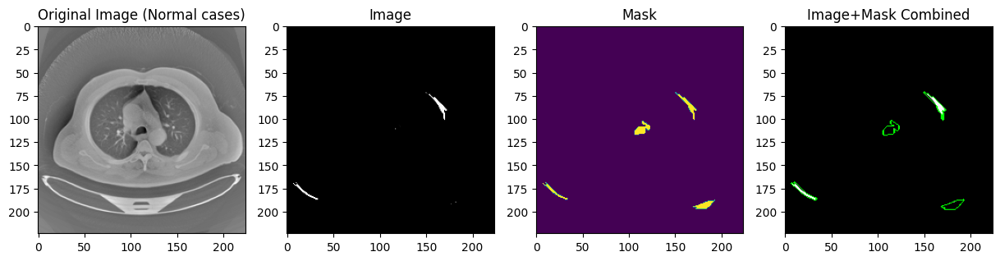

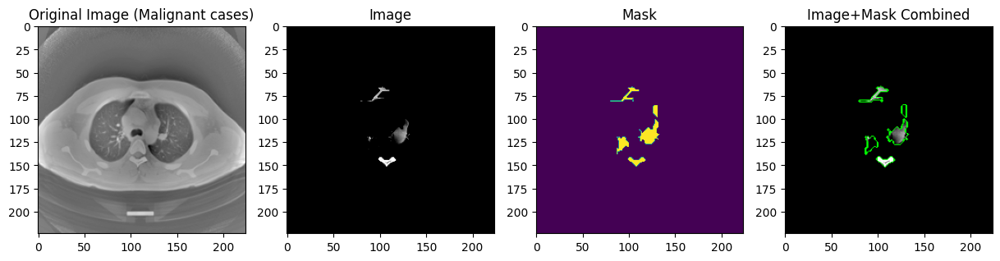

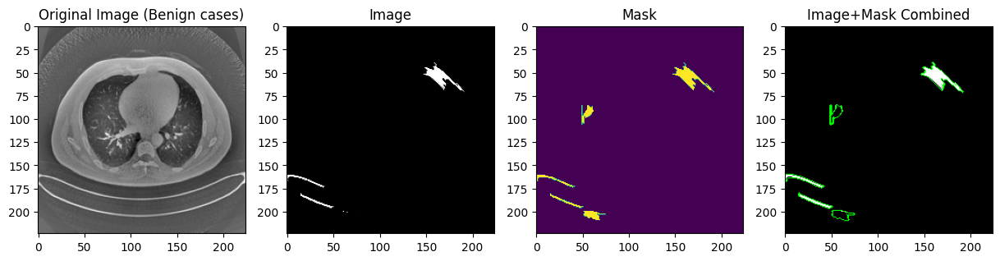

In [ ]:
import numpy as np
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

# Function to reshape the flattened image
def reshape_image(flattened_image):
    return flattened_image.reshape(224, 224)

# Function to make predictions on the reshaped and colored images
def make_predictions_on_categories(color_img):
    print(f"Shape of color_img before processing: {color_img.shape}")

    # Handle both single images and batches
    if len(color_img.shape) == 3:  # Single image
        gray_img = rgb2gray(color_img).reshape(1, 224, 224, 1)
    else:  # Batch of images
        gray_img = np.array([rgb2gray(img) for img in color_img])
        gray_img = gray_img.reshape(gray_img.shape[0], 224, 224, 1)

    print(f"Input shape for prediction: {gray_img.shape}")
    preds = model2.predict(gray_img)
    return preds

# Function to plot the comparison of images
def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15, 5))
    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224, 224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0, 1, 0)))
    ax.set_title("Image+Mask Combined")

# Assuming Y_test is already defined as the true labels for X_test
# Obtain predictions for the entire test set
# Check the shape of X_test before prediction
print(f"Shape of X_test before prediction: {X_test.shape}")

# Ensure X_test is correctly shaped
if len(X_test.shape) == 3:  # If the shape is (num_samples, height, width)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)
elif len(X_test.shape) == 2:  # If the shape is (num_samples, flattened_pixels)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)

# Print the shape again to confirm
print(f"Shape of X_test after reshaping: {X_test.shape}")

if len(X_test.shape) == 1:  # Check if X_test is a flattened array
    # Calculate the number of images in the batch
    num_images = X_test.size // (224 * 224)  # Total elements divided by one image size
    X_test = X_test.reshape(num_images, 224, 224, 1)  # Reshape into the correct batch size

print(f"Reshaped X_test shape: {X_test.shape}")

# Now, perform the prediction
Y_test_preds = model2.predict(X_test).argmax(axis=1)

for label_name, label_value in label_map.items(): # Switch the order of label_value and label_name
    # Filter misclassified instances for this category
    misclassified_indices = [i for i in category_indices[label_value] if y_test[i] != Y_test_preds[i]]

    if misclassified_indices:
        idx = misclassified_indices[0]  # Select the first misclassified image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Get the actual and predicted labels
        actual_label = y_test[idx]
        predicted_label = Y_test_preds[idx]

        # Print category, index, and label information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")
        # Use actual_label and predicted_label to get the label names from label_map
        print(f"Actual Label: {list(label_map.keys())[list(label_map.values()).index(actual_label)]}")
        print(f"Predicted Label: {list(label_map.keys())[list(label_map.values()).index(predicted_label)]}")
        print()
        #print(f"Actual Label: {label_map[actual_label]}")
        #print(f"Predicted Label: {label_map[predicted_label]}")
        #print()

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Generate LIME explanation for the incorrect prediction
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get the image and mask for the misclassified sample
        predicted_class = Y_test_preds[idx]
        img, mask = explanation.get_image_and_mask(predicted_class, positive_only=False, negative_only=True, hide_rest=True)

        # Print shape information for verification
        print(img.shape)
        print(mask.shape)

        # Plot the comparison between the original and the LIME explanation
        plot_comparison(X_test[idx], img, mask, label_name)

# Lime results using different methods

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 788ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 781ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

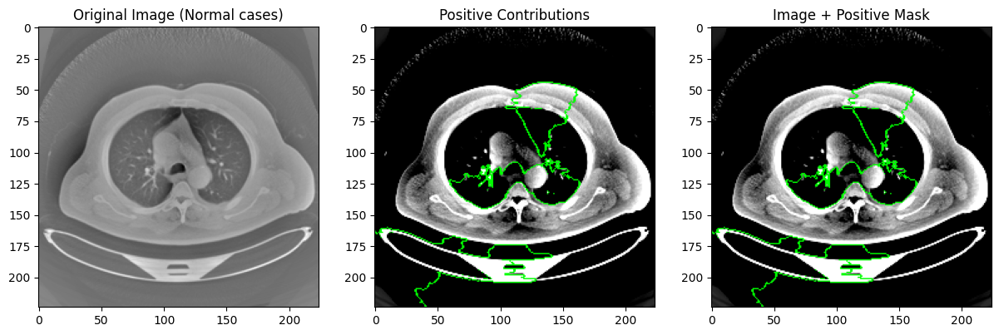

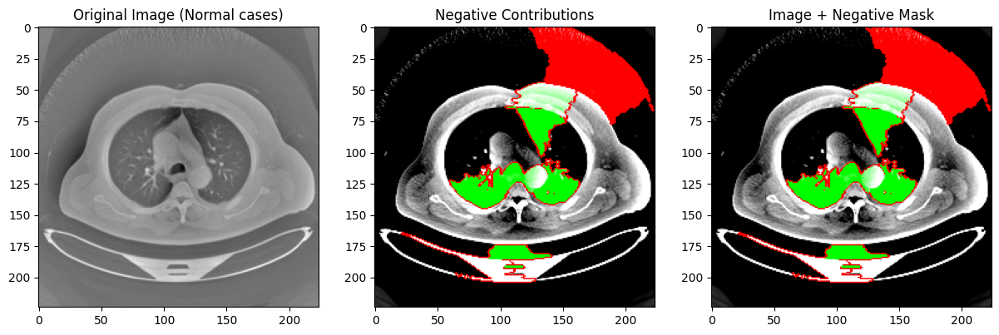

Generating explanation for: Malignant cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 609ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

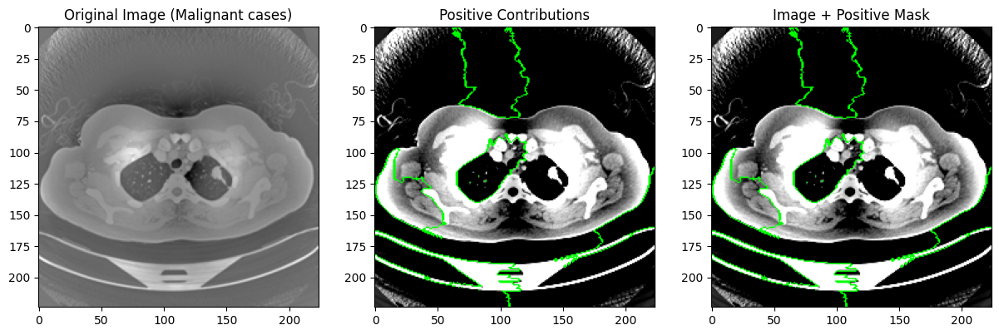

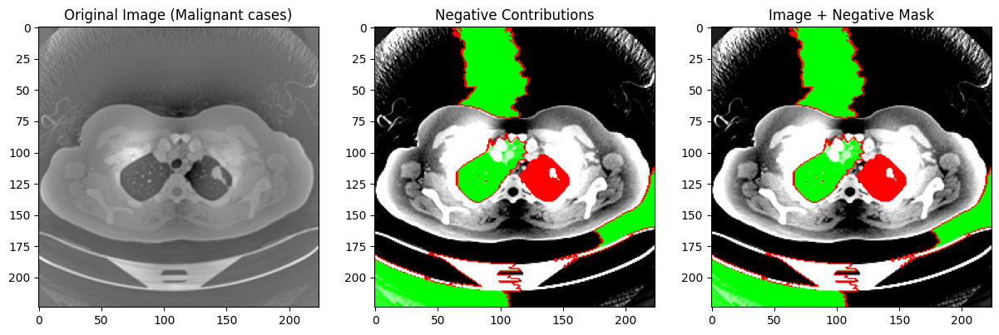

Generating explanation for: Benign cases (Image index: 1)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

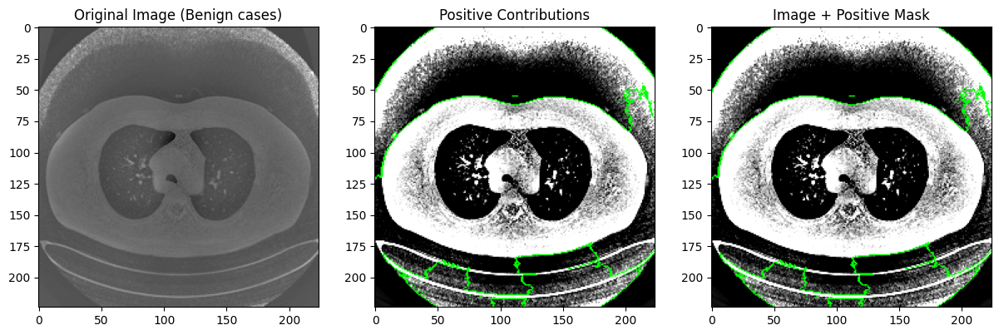

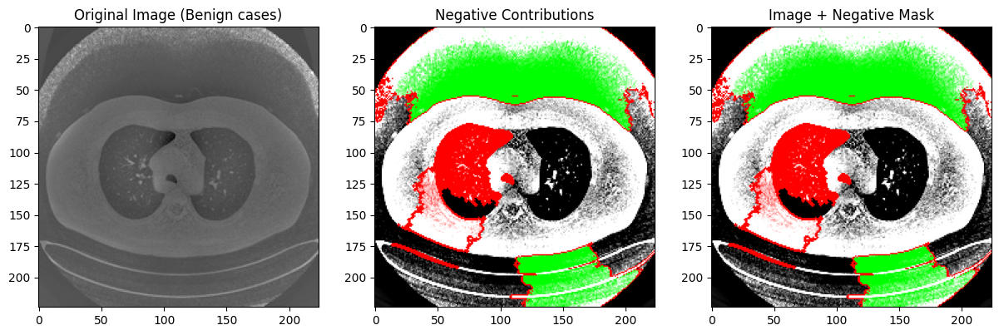

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model2.predict(image)
    return preds

# Function to plot the comparison
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries

def plot_positive_contributions(main_image, img_pos, mask_pos, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Positive Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Positive Mask")

    plt.show()

def plot_negative_contributions(main_image, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Negative Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_neg, mask_neg, color=(1, 0, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Negative Mask")

    plt.show()


# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model2.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_positive_contributions(X_test_reshaped[idx], img_pos, mask_pos, label_name)
        plot_negative_contributions(X_test_reshaped[idx], img_neg, mask_neg, label_name)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 675ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 930ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 812

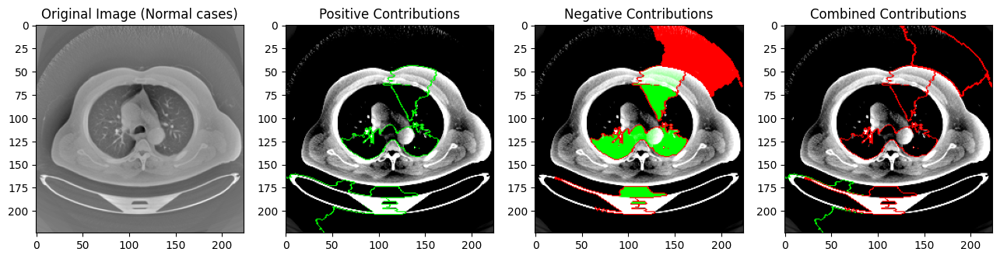

Generating explanation for: Malignant cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 609ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

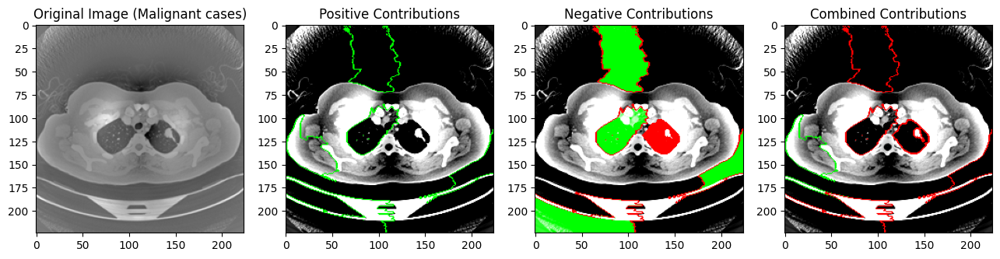

Generating explanation for: Benign cases (Image index: 1)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 613ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

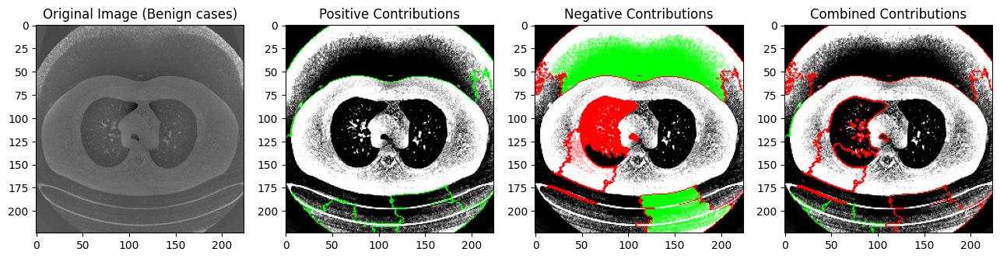

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model2.predict(image)
    return preds

# Function to plot the comparison
def plot_comparison(main_image, img_pos, mask_pos, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    ax = fig.add_subplot(151)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    ax = fig.add_subplot(152)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    ax = fig.add_subplot(153)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    ax = fig.add_subplot(154)
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    # Apply negative mask without alpha, as it's not supported in older versions
    combined_img = mark_boundaries(combined_img, mask_neg, color=(1, 0, 0))
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Combined Contributions")

    plt.show()

# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model2.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_comparison(X_test_reshaped[idx], img_pos, mask_pos, img_neg, mask_neg, label_name)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

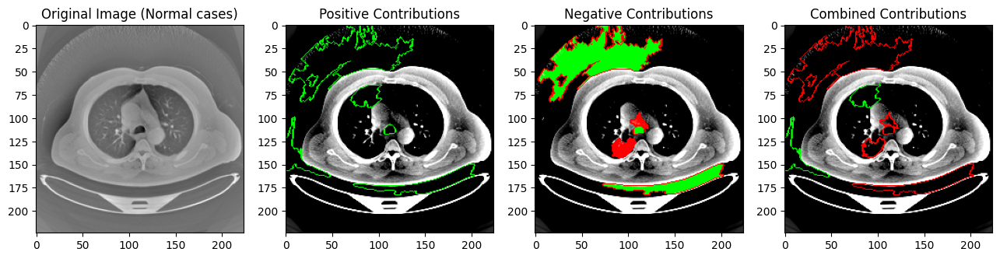

Generating explanation for: Malignant cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 610ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

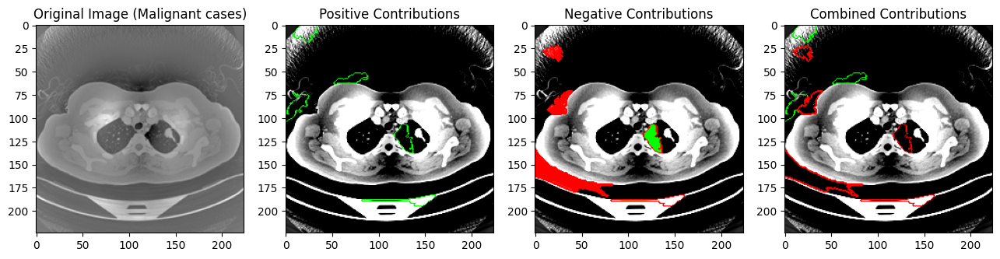

Generating explanation for: Benign cases (Image index: 1)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

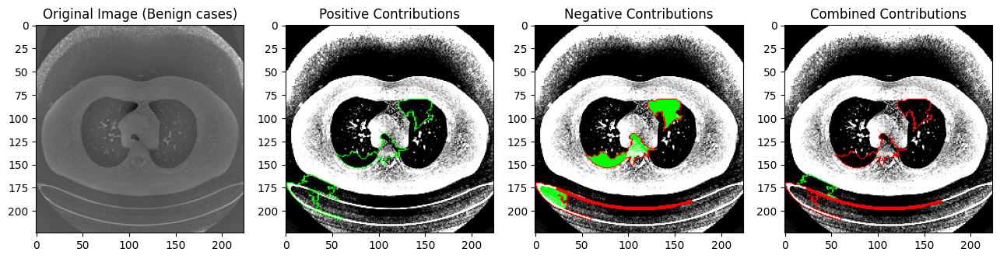

In [ ]:
# Lime using felzenszwalb segmentation method
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, felzenszwalb
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model2.predict(image)
    return preds

# Function to plot the comparison
def plot_comparison(main_image, img_pos, mask_pos, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    ax = fig.add_subplot(151)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    ax = fig.add_subplot(152)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    ax = fig.add_subplot(153)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    ax = fig.add_subplot(154)
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    combined_img = mark_boundaries(combined_img, mask_neg, color=(1, 0, 0))
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Combined Contributions")

    plt.show()

# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model2.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label using felzenszwalb segmentation
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            segmentation_fn=lambda x: felzenszwalb(x, scale=100, sigma=0.5, min_size=50),  # Customize segmentation parameters
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_comparison(X_test_reshaped[idx], img_pos, mask_pos, img_neg, mask_neg, label_name)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 573ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

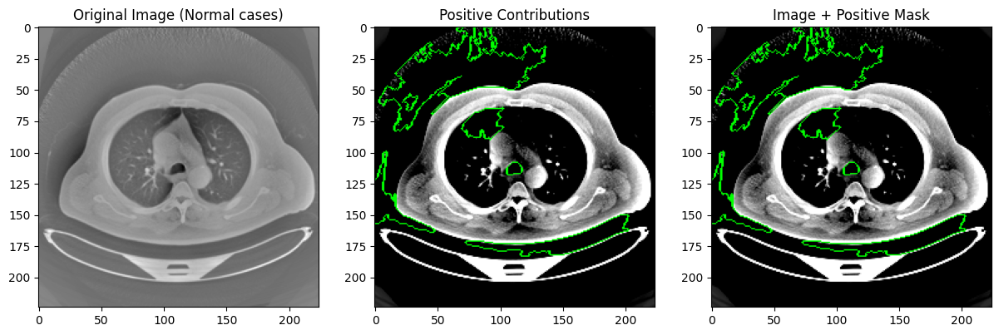

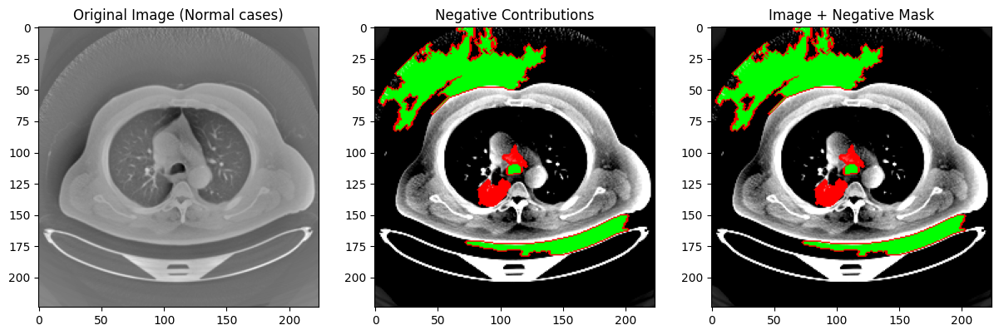

Generating explanation for: Malignant cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

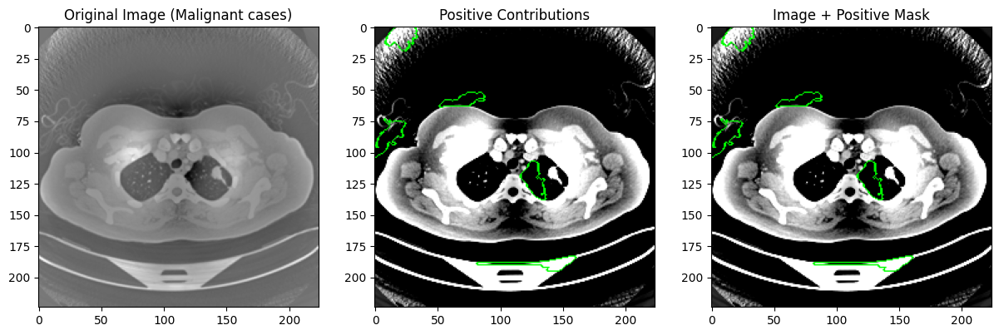

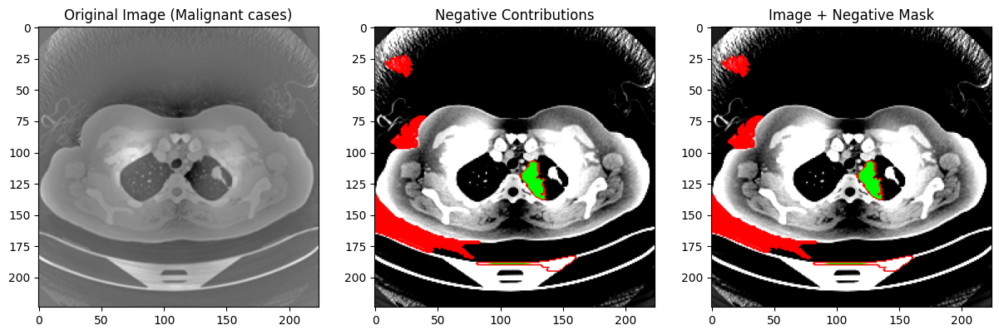

Generating explanation for: Benign cases (Image index: 1)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 605ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

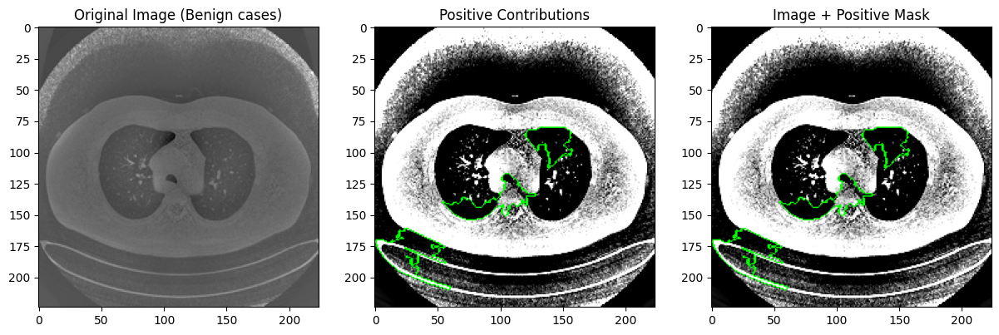

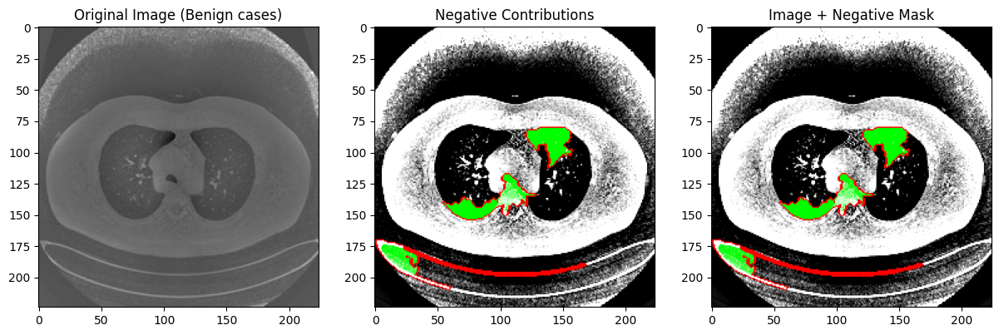

In [ ]:
# Lime using felzenszwalb segmentation method
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, felzenszwalb
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model2.predict(image)
    return preds

# Function to plot the comparison
def plot_positive_contributions(main_image, img_pos, mask_pos, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Positive Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Positive Mask")

    plt.show()

def plot_negative_contributions(main_image, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Negative Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_neg, mask_neg, color=(1, 0, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Negative Mask")

    plt.show()


# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model2.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label using felzenszwalb segmentation
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            segmentation_fn=lambda x: felzenszwalb(x, scale=100, sigma=0.5, min_size=50),
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_positive_contributions(X_test_reshaped[idx], img_pos, mask_pos, label_name)
        plot_negative_contributions(X_test_reshaped[idx], img_neg, mask_neg, label_name)


# Data Augmentation using Augmentor library

In [ ]:
!pip install Augmentor

In [ ]:
# Augmenting imbalanced dataset
import Augmentor
import os
import shutil

# Define the paths to the original dataset and the directory to store augmented images
original_dataset_path = '/content/drive/My Drive/The IQ-OTHNCCD lung cancer dataset'
output_dataset_path = '/content/drive/My Drive/The IQ Augmented dataset'

# Create a new directory for the augmented dataset
os.makedirs(output_dataset_path, exist_ok=True)

# Function to copy files from one directory to another
def copy_files(source_dir, dest_dir):
    for file_name in os.listdir(source_dir):
        shutil.copy(os.path.join(source_dir, file_name), dest_dir)

# Define the desired number of images per class after augmentation
desired_images_per_class = 1500

# Iterate over each class directory in the original dataset
for class_name in os.listdir(original_dataset_path):
    class_dir = os.path.join(original_dataset_path, class_name)

    # Skip non-directory files
    if not os.path.isdir(class_dir):
        continue

    output_class_dir = os.path.join(output_dataset_path, class_name)
    os.makedirs(output_class_dir, exist_ok=True)

    # Count the number of original images
    num_original_images = len(os.listdir(class_dir))

    # Copy original images to the output class directory
    copy_files(class_dir, output_class_dir)

    # Calculate the number of additional images needed
    num_additional_images = desired_images_per_class - num_original_images

    if num_additional_images > 0:
        # Create an Augmentor Pipeline for the class
        p = Augmentor.Pipeline(output_class_dir, output_directory=".")

        # Add augmentation operations
        p.rotate(probability=0.7, max_left_rotation=10, max_right_rotation=10)
        p.flip_left_right(probability=0.5)
        p.zoom_random(probability=0.5, percentage_area=0.8)

        # Generate the required number of augmented samples
        p.sample(num_additional_images)

# After augmentation, count the total number of samples in the augmented dataset
num_augmented_images = sum(len(files) for _, _, files in os.walk(output_dataset_path))

print("Total number of images in the augmented dataset:", num_augmented_images)


Initialised with 561 image(s) found.
Output directory set to /content/drive/My Drive/The IQ Augmented dataset/Malignant cases/..

Processing <PIL.Image.Image image mode=RGB size=512x512 at 0x791794A5AE90>: 100%|██████████| 939/939 [00:50<00:00, 18.63 Samples/s]


Initialised with 416 image(s) found.
Output directory set to /content/drive/My Drive/The IQ Augmented dataset/Normal cases/..

Processing <PIL.Image.Image image mode=RGB size=512x512 at 0x7917EF09E920>: 100%|██████████| 1084/1084 [00:51<00:00, 21.12 Samples/s]


Initialised with 120 image(s) found.
Output directory set to /content/drive/My Drive/The IQ Augmented dataset/Benign cases/..

Processing <PIL.Image.Image image mode=RGB size=512x512 at 0x79179D749C60>: 100%|██████████| 1380/1380 [01:05<00:00, 21.09 Samples/s]


Total number of images in the augmented dataset: 4500


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import seaborn as sns
import cv2
import random
import os
import imageio
import plotly.graph_objects as go
import plotly.express as px
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from collections import Counter
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import accuracy_score, recall_score, precision_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import RandomizedSearchCV, cross_val_score, RepeatedStratifiedKFold
from imblearn.over_sampling import SMOTE
import tensorflow as tf
#import tensorflow_addons as tfa
import keras
from tensorflow.keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, BatchNormalization,AvgPool2D
from keras.applications import resnet
from tensorflow.keras.applications import EfficientNetB0, EfficientNetB1, EfficientNetB2, EfficientNetB3, EfficientNetB4, EfficientNetB5, EfficientNetB6, EfficientNetB7
from keras.applications.resnet import ResNet50
from tensorflow.keras.utils import load_img, img_to_array, array_to_img
from tensorflow.keras.preprocessing.image import ImageDataGenerator


In [ ]:
directory = '/content/drive/My Drive/The IQ Augmented dataset'
categories = os.listdir(directory)
print(categories)

['Malignant cases', 'Normal cases', 'Benign cases']


In [ ]:

size_data = {}
HEIGHT = WIDTH = 224
img_size = 224
for i in categories:
    path = os.path.join(directory, i)
    class_num = categories.index(i)
    temp_dict = {}
    for file in os.listdir(path):
        filepath = os.path.join(path, file)
        height, width, channels = imageio.v2.imread(filepath).shape
        # TODO if height == width then aspect ratio 1:1 currenly the if statement is removing 1024 x 1024
#         if height == width:
        k = str(height) + ' x ' + str(width)
        temp_dict[k] = temp_dict.get(k, 0) + 1
    size_data[i] = temp_dict

size_data

{'Malignant cases': {'512 x 512': 1343,
  '512 x 623': 81,
  '512 x 801': 75,
  '404 x 511': 1},
 'Normal cases': {'512 x 512': 1496, '331 x 506': 4},
 'Benign cases': {'512 x 512': 1500}}

In [ ]:
import os
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Set the path to your dataset directory
dir_path = '/content/drive/My Drive/The IQ Augmented dataset'

# Initialize lists to hold features and labels
X = []
y = []

# Mapping from directory names to labels
label_map = {'Malignant cases': 0, 'Normal cases': 1, 'Benign cases': 2}

# Load images and labels
for label_name, label_id in label_map.items():
    label_dir = os.path.join(dir_path, label_name)
    for file_name in os.listdir(label_dir):
        file_path = os.path.join(label_dir, file_name)
        # Load image
        image = Image.open(file_path)
        # Convert image to grayscale and resize if necessary
        image = image.convert('L')  # Or 'L' for grayscale or 'RGB' for colored
        image = image.resize((224, 224))  # Resize to a fixed size if necessary
        # Convert image to numpy array and flatten
        image_array = np.array(image).flatten()
        # Append to lists
        X.append(image_array)
        y.append(label_id)

# Convert lists to numpy arrays
X = np.array(X)
y = np.array(y)

# Normalize data (optional but often useful)
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Split the dataset into training+validation and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Split the training+validation set into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.2, random_state=42, stratify=y_train_val)

# Print the shapes of the resulting sets
print("Training set shape:", X_train.shape)
print("Validation set shape:", X_val.shape)
print("Test set shape:", X_test.shape)

# Since SMOTE is not used, there's no need to print the resampled training set shape
# If you want to include that for completeness, you can just print the original training set shape
print(f"Original training set size: {X_train.shape[0]}")
print(f"Validation set size: {X_val.shape[0]}")
print(f"Test set size: {X_test.shape[0]}")


Training set shape: (2880, 50176)
Validation set shape: (720, 50176)
Test set shape: (900, 50176)
Original training set size: 2880
Validation set size: 720
Test set size: 900


In [ ]:
print(Counter(y_train), Counter(y_test))

Counter({2: 960, 0: 960, 1: 960}) Counter({2: 300, 0: 300, 1: 300})


In [ ]:
import numpy as np
from collections import Counter

# Assuming y_test contains the labels for the test set
class_distribution = Counter(y_test)

# Map labels back to class names if necessary
label_map_inverse = {v: k for k, v in label_map.items()}
class_distribution_names = {label_map_inverse[k]: v for k, v in class_distribution.items()}

print("Test set class distribution:")
for class_name, count in class_distribution_names.items():
    print(f"{class_name}: {count} images")


Test set class distribution:
Benign cases: 300 images
Malignant cases: 300 images
Normal cases: 300 images


# Model 3

In [ ]:
model3 = keras.models.Sequential([
    keras.layers.Conv2D(filters=128, kernel_size=(8, 8), strides=(3, 3), activation='relu', input_shape=(224, 224, 1)),
#     keras.layers.BatchNormalization(),

    keras.layers.Conv2D(filters=256, kernel_size=(5, 5), strides=(1, 1), activation='relu', padding="same"),
#     keras.layers.BatchNormalization(),
    keras.layers.MaxPool2D(pool_size=(3, 3)),

    keras.layers.Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),
    keras.layers.Conv2D(filters=256, kernel_size=(1, 1), strides=(1, 1), activation='relu', padding="same"),
#

    keras.layers.Conv2D(filters=256, kernel_size=(1, 1), strides=(1, 1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),

    keras.layers.Conv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
#     keras.layers.BatchNormalization(),
    keras.layers.MaxPool2D(pool_size=(2, 2)),

    keras.layers.Conv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),

    keras.layers.Conv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
#     keras.layers.BatchNormalization(),

    keras.layers.MaxPool2D(pool_size=(2, 2)),

    keras.layers.Conv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),

    keras.layers.MaxPool2D(pool_size=(2, 2)),

    keras.layers.Flatten(),
    keras.layers.Dense(1024, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(1024, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(3, activation='softmax')
])

model3.compile(
    loss='categorical_crossentropy',
    optimizer=tf.optimizers.SGD(learning_rate=0.001),
    metrics=['accuracy']
)

model3.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 73, 73, 128)         │           8,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 73, 73, 256)         │         819,456 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 24, 24, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 24, 24, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 24, 24, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 24, 24, 256)         │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 24, 24, 256)         │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 24, 24, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 24, 24, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 12, 12, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 12, 12, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 12, 12, 512)         │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 12, 12, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 6, 6, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_8 (Conv2D)                    │ (None, 6, 6, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 6, 6, 512)           │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 3, 3, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 4608)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1024)                │       4,719,616 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 15,587,459 (59.46 MB)

 Trainable params: 15,584,387 (59.45 MB)

 Non-trainable params: 3,072 (12.00 KB)

In [ ]:
X_train = X_train.reshape(-1, 224, 224, 1)

In [ ]:
X_train.shape

(2880, 224, 224, 1)

In [ ]:
y_train.shape

(2880,)

In [ ]:
y_train

array([2, 0, 2, ..., 0, 2, 0])

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint  # Import necessary classes

# Define early stopping callback
early_stopping = EarlyStopping(monitor='val_loss',  # Monitor validation loss
                               patience=3,         # Number of epochs with no improvement after which training will be stopped
                               restore_best_weights=True)  # Restore weights to the best model observed during training

# Define model checkpoint callback to save the best model during training
checkpoint = ModelCheckpoint('minor_project_model_3.keras',  # Filepath to save the best model
                             monitor='val_loss',  # Monitor validation loss
                             save_best_only=True,  # Save only the best model
                             mode='min',          # Mode of monitoring (minimize validation loss)
                             verbose=1)           # Verbosity mode (1 for updates)

In [ ]:
from tensorflow.keras.utils import to_categorical

y_train_one_hot = to_categorical(y_train, num_classes=3)
y_val_one_hot = to_categorical(y_val, num_classes=3)
y_test_one_hot = to_categorical(y_test, num_classes=3)

In [ ]:
history = model3.fit(X_train, y_train_one_hot, epochs=15, validation_split=0.2, verbose=1, batch_size=16, callbacks=[early_stopping, checkpoint] )


Epoch 1/15
144/144 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - accuracy: 0.3935 - loss: 1.9744
Epoch 1: val_loss improved from inf to 1.10630, saving model to minor_project_model_3.keras
144/144 ━━━━━━━━━━━━━━━━━━━━ 39s 137ms/step - accuracy: 0.3937 - loss: 1.9723 - val_accuracy: 0.3194 - val_loss: 1.1063
Epoch 2/15
144/144 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - accuracy: 0.4807 - loss: 1.2842
Epoch 2: val_loss improved from 1.10630 to 1.03860, saving model to minor_project_model_3.keras
144/144 ━━━━━━━━━━━━━━━━━━━━ 15s 102ms/step - accuracy: 0.4808 - loss: 1.2839 - val_accuracy: 0.4410 - val_loss: 1.0386
Epoch 3/15
144/144 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - accuracy: 0.5335 - loss: 1.0654
Epoch 3: val_loss improved from 1.03860 to 0.81874, saving model to minor_project_model_3.keras
144/144 ━━━━━━━━━━━━━━━━━━━━ 20s 99ms/step - accuracy: 0.5335 - loss: 1.0652 - val_accuracy: 0.6337 - val_loss: 0.8187
Epoch 4/15
144/144 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - accuracy: 0.5849 - loss: 0.9071
Epoch 4: 

In [ ]:
# Load the trained model
model3 = tf.keras.models.load_model('/content/minor_project_model_3.keras')

In [ ]:
X_test_reshaped= X_test.reshape(-1, 224, 224, 1)

In [ ]:
X_test= X_test.reshape(-1, 224, 224, 1)

# Now use the reshaped data for prediction
y_pred = model3.predict(X_test, verbose=1)
y_pred_bool = np.argmax(y_pred, axis=1)

29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 145ms/step


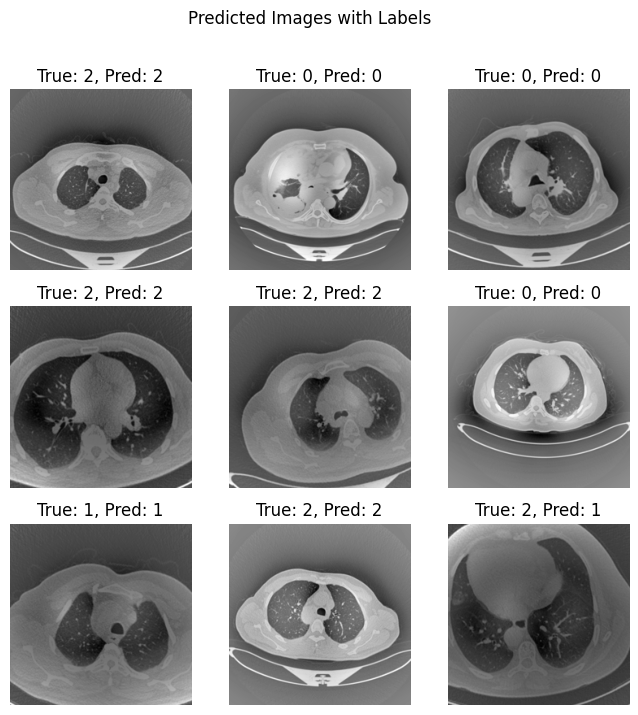

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(8, 8))
fig.suptitle('Predicted Images with Labels')

for i, ax in enumerate(axes.flat):
    ax.imshow(X_test[i].reshape(img_size, img_size, 1), cmap='gray')
    true_label = y_test[i]  # Integer-encoded label
    pred_label = y_pred_bool[i]
    ax.set_title(f'True: {true_label}, Pred: {pred_label}')
    ax.axis('off')

plt.show()

In [ ]:
print(classification_report(y_test, y_pred_bool))
print(confusion_matrix(y_true=y_test, y_pred=y_pred_bool))

              precision    recall  f1-score   support

           0       0.88      0.91      0.89       300
           1       0.82      0.72      0.77       300
           2       0.74      0.82      0.78       300

    accuracy                           0.81       900
   macro avg       0.82      0.81      0.81       900
weighted avg       0.82      0.81      0.81       900

[[272   9  19]
 [ 20 215  65]
 [ 17  38 245]]


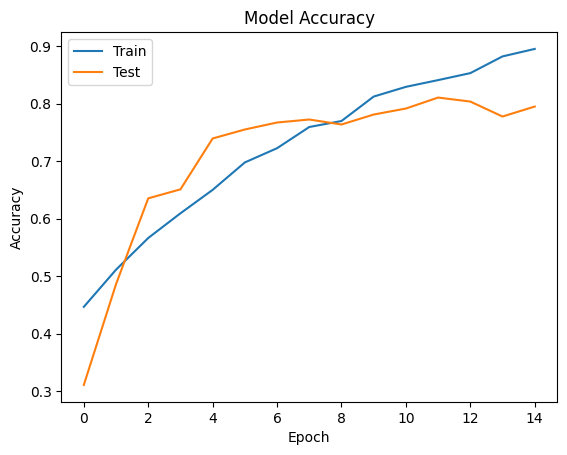

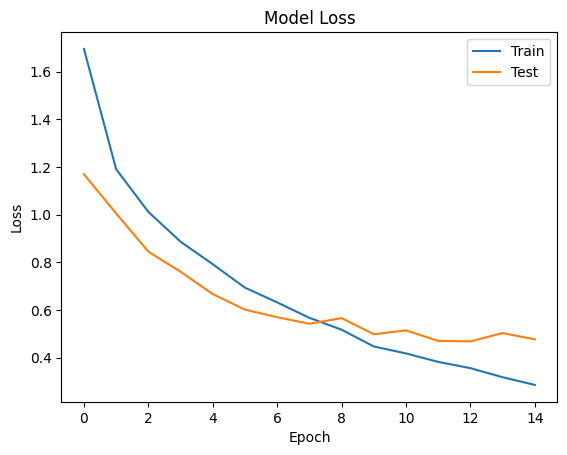

In [ ]:
plt.plot(history.history['accuracy'], label='Train')
plt.plot(history.history['val_accuracy'], label='Test')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='Train')
plt.plot(history.history['val_loss'], label='Test')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

In [ ]:
# Ensure the image dimensions are correctly defined
IMAGE_HEIGHT = 224
IMAGE_WIDTH = 224
IMAGE_CHANNELS = 1  # For grayscale images

# Function to reshape flattened image to its original dimensions
def reshape_image(flattened_image):
    return flattened_image.reshape(IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS)  # Reshape to (224, 224, 1)

# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test)):
    flattened_image = X_test[i]
    image = reshape_image(flattened_image)  # Reshape to (224, 224, 1)

    pred_label = model3.predict(image.reshape(1, IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Print the shape of the first image of each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")
        print()


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 8.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=61345800187805641c6f34700dd208a126c1fcaf4b76b9a271124d1fdb0d1702
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from lime import lime_image
explainer = lime_image.LimeImageExplainer(random_state=123)

# TRUE PREDICTION – POSITIVE CONTRIBUTION

Category: Malignant cases
Index: 1
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
Shape of model predictions: (1, 3)
Predictions: [[9.9721152e-01 8.3075004e-04 1.9577974e-03]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━

Category: Normal cases
Index: 15
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Shape of model predictions: (1, 3)
Predictions: [[0.00147445 0.90749335 0.09103226]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━

Category: Benign cases
Index: 0
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Shape of model predictions: (1, 3)
Predictions: [[0.00209184 0.01465862 0.98324955]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━

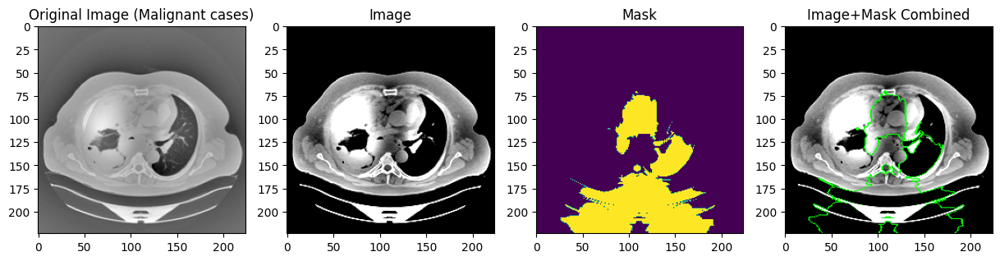

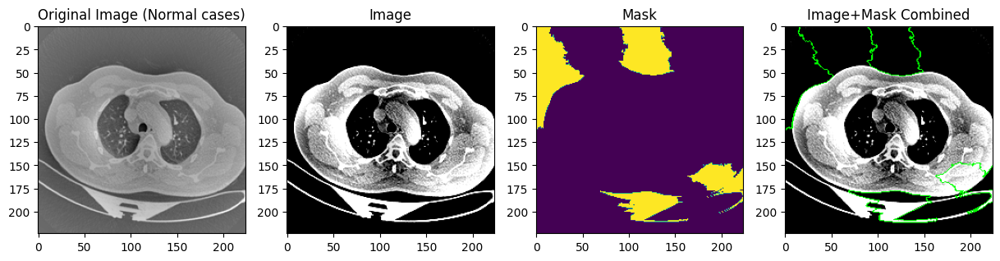

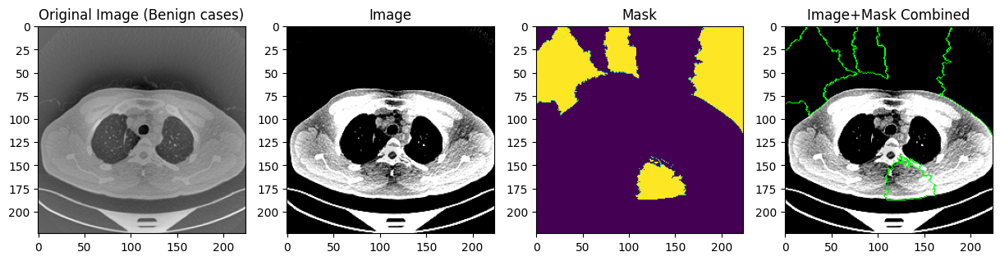

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (224x224)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(gray_img):
    # Prepare the grayscale image for prediction
    gray_img_reshaped = gray_img.reshape(-1, 224, 224, 1)

    # Debugging: Print the shape of the input image
    print(f"Shape of input to model: {gray_img_reshaped.shape}")

    # Get predictions for the image
    preds = model3.predict(gray_img_reshaped)

    # Debugging: Print the shape of the prediction output
    print(f"Shape of model predictions: {preds.shape}")

    # Return the prediction probabilities
    return preds

from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray");
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img);
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask);
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)));
    ax.set_title("Image+Mask Combined");

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB for LIME, and make predictions using grayscale
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(image)  # Pass the grayscale image for prediction

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # LIME needs to call a function that returns just the predictions
        explanation = explainer.explain_instance(colored_image,  # Use RGB image for explanation
                                                 lambda x: make_predictions_on_categories(rgb2gray(x)),
                                                 random_seed=123)

        # Get the image and mask for negative contributions
        img, mask = explanation.get_image_and_mask(y_test[idx], positive_only=True, hide_rest=False)

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# TRUE PREDICTION – NEGATIVE CONTRIBUTION

Category: Malignant cases
Index: 1
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Shape of model predictions: (1, 3)
Predictions: [[9.9721152e-01 8.3075004e-04 1.9577974e-03]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━

Category: Normal cases
Index: 15
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Shape of model predictions: (1, 3)
Predictions: [[0.00147445 0.90749335 0.09103226]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━

Category: Benign cases
Index: 0
Shape of image: (224, 224)
Shape of input to model: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of model predictions: (1, 3)
Predictions: [[0.00209184 0.01465862 0.98324955]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Shape of model predictions: (10, 3)
Shape of input to model: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━

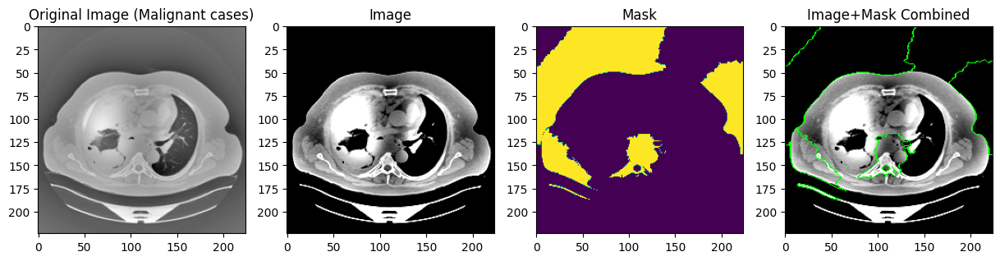

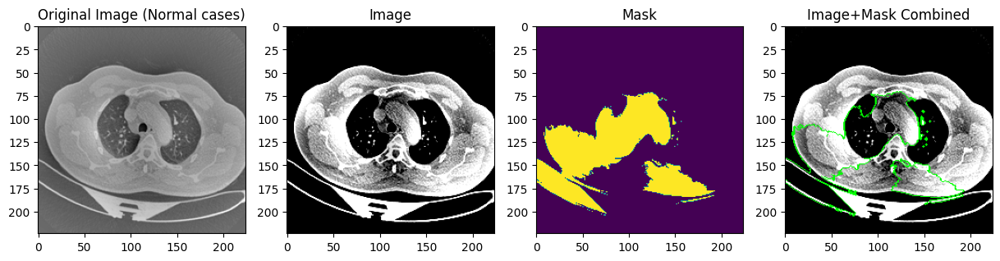

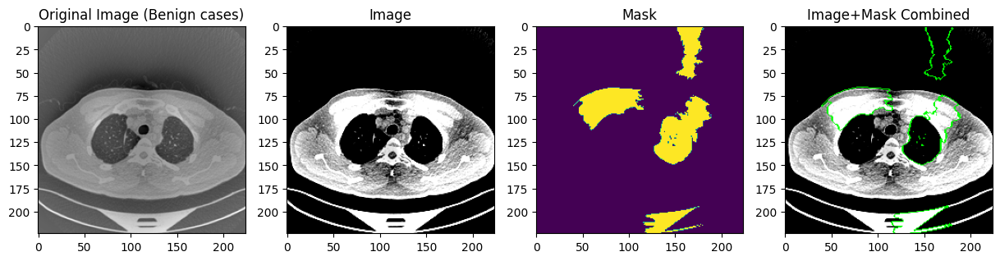

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (224x224)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(gray_img):
    # Prepare the grayscale image for prediction
    gray_img_reshaped = gray_img.reshape(-1, 224, 224, 1)

    # Debugging: Print the shape of the input image
    print(f"Shape of input to model: {gray_img_reshaped.shape}")

    # Get predictions for the image
    preds = model3.predict(gray_img_reshaped)

    # Debugging: Print the shape of the prediction output
    print(f"Shape of model predictions: {preds.shape}")

    # Return the prediction probabilities
    return preds

from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray");
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img);
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask);
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)));
    ax.set_title("Image+Mask Combined");

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB for LIME, and make predictions using grayscale
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(image)  # Pass the grayscale image for prediction

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # LIME needs to call a function that returns just the predictions
        explanation = explainer.explain_instance(colored_image,  # Use RGB image for explanation
                                                 lambda x: make_predictions_on_categories(rgb2gray(x)),
                                                 random_seed=123)

        # Get the image and mask for negative contributions
        img, mask = explanation.get_image_and_mask(y_test[idx], positive_only=False, negative_only=True, hide_rest=False)

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# TRUE PREDICTION USING felzenszwalb segmentation method - POSITIVE CONTRIBUTION

Category: Malignant cases
Index: 1
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Predictions: [[9.9721152e-01 8.3075004e-04 1.9577974e-03]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━

(224, 224, 3)
(224, 224)
Category: Normal cases
Index: 15
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
Predictions: [[0.00147445 0.90749335 0.09103226]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━

(224, 224, 3)
(224, 224)


Category: Benign cases
Index: 0
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Predictions: [[0.00209184 0.01465862 0.98324955]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━

(224, 224, 3)
(224, 224)


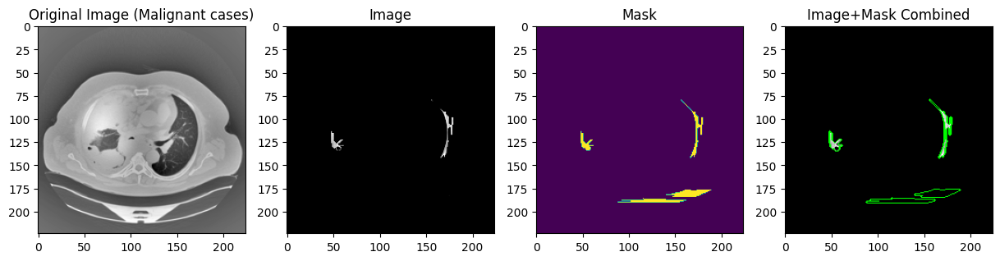

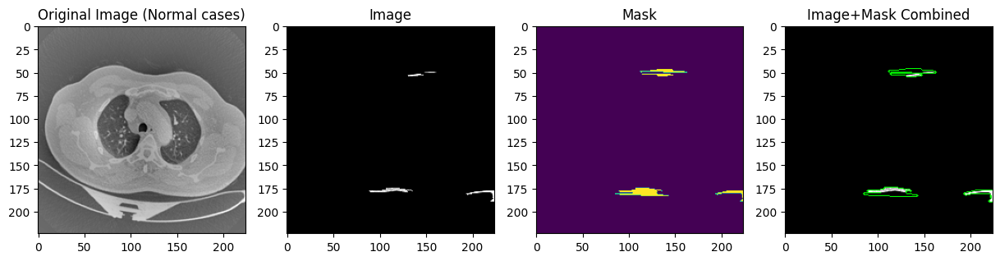

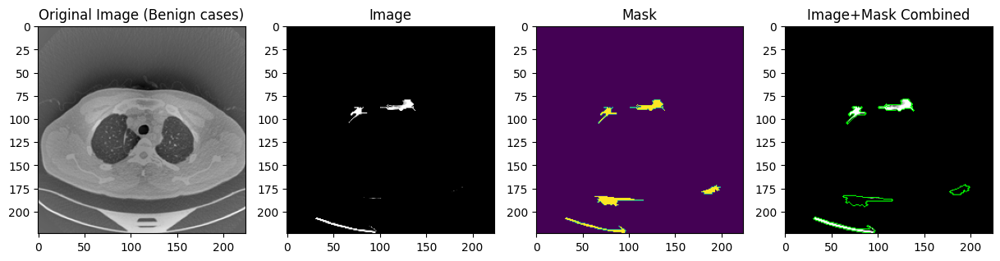

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (28x28)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(color_img):
    # Convert the RGB image to grayscale
    gray_img = rgb2gray(color_img).reshape(-1, 224, 224, 1)

    # Get predictions for the image
    preds = model3.predict(gray_img)

    # Return the prediction probabilities as a 2D array
    return preds

from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray");
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img);
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask);
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)));
    ax.set_title("Image+Mask Combined");

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Pass the reshaped image (squeeze to remove the single channel dimension)
        explanation = explainer.explain_instance(colored_image, make_predictions_on_categories,
                                         segmentation_fn=felzenszwalb, random_seed=123)

        img, mask = explanation.get_image_and_mask(y_test[idx], positive_only=True, hide_rest=True)

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# TRUE PREDICTION USING felzenszwalb segmentation method - NEGATIVE CONTRIBUTION

Category: Malignant cases
Index: 1
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
Predictions: [[9.9721152e-01 8.3075004e-04 1.9577974e-03]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━

(224, 224, 3)
(224, 224)
Category: Normal cases
Index: 15
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predictions: [[0.00147445 0.90749335 0.09103226]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━

(224, 224, 3)
(224, 224)


Category: Benign cases
Index: 0
Shape of image: (224, 224)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Predictions: [[0.00209184 0.01465862 0.98324955]]



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━

(224, 224, 3)
(224, 224)


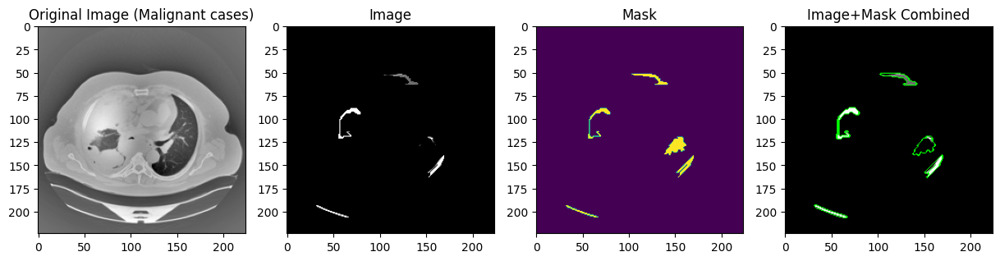

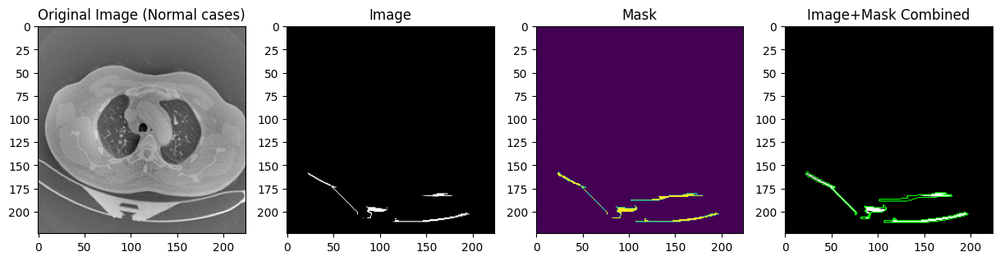

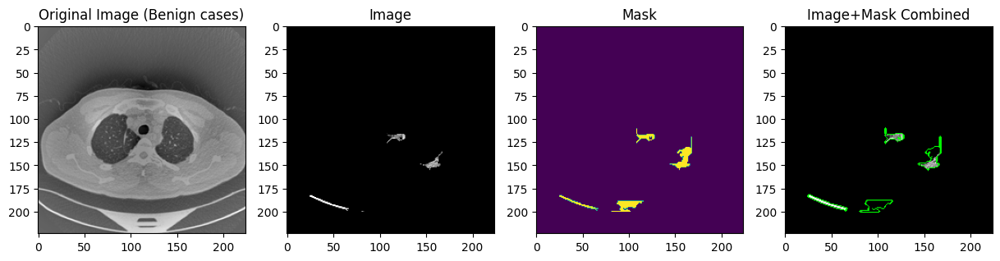

In [ ]:
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

def reshape_image(flattened_image):
    # Reshape the flattened image to the appropriate dimensions (224x224)
    return flattened_image.reshape(224, 224)

def make_predictions_on_categories(color_img):
    # Convert the RGB image to grayscale
    gray_img = rgb2gray(color_img).reshape(-1, 224, 224, 1)

    # Get predictions for the image
    preds = model3.predict(gray_img)

    # Return the prediction probabilities as a 2D array
    return preds

def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224,224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0,1,0)))
    ax.set_title("Image+Mask Combined")

# Print the shape of the first image of each category and make predictions
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Pass the reshaped image (squeeze to remove the single channel dimension)
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get image and mask for negative contributions
        img, mask = explanation.get_image_and_mask(
            y_test[idx],
            positive_only=False,  # Set to False to include negative contributions
            negative_only=True,    # Set to True to focus only on negative contributions
            hide_rest=True
        )

        print(img.shape)
        print(mask.shape)

        plot_comparison(X_test[idx], img, mask, label_name)


# FALSE PREDICTION USING felzenszwalb segmentation method - POSITIVE CONTRIBUTION

Shape of X_test before prediction: (900, 224, 224, 1)
Shape of X_test after reshaping: (900, 224, 224, 1)
Reshaped X_test shape: (900, 224, 224, 1)
29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step
Category: Malignant cases
Index: 10
Shape of image: (224, 224)
Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Predictions: [[0.59836876 0.03116278 0.37046847]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Shape of color_img b

(224, 224, 3)
(224, 224)
Category: Normal cases
Index: 15
Shape of image: (224, 224)
Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Predictions: [[0.00147445 0.90749335 0.09103226]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
Shape of color_img b

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 6
Shape of image: (224, 224)
Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Predictions: [[0.09977373 0.4019754  0.4982509 ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of color_img b

(224, 224, 3)
(224, 224)


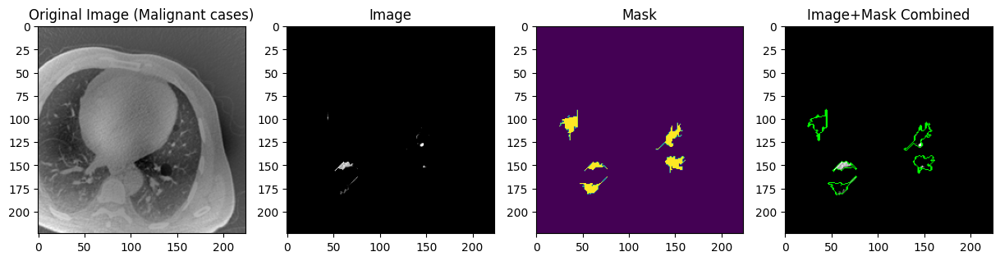

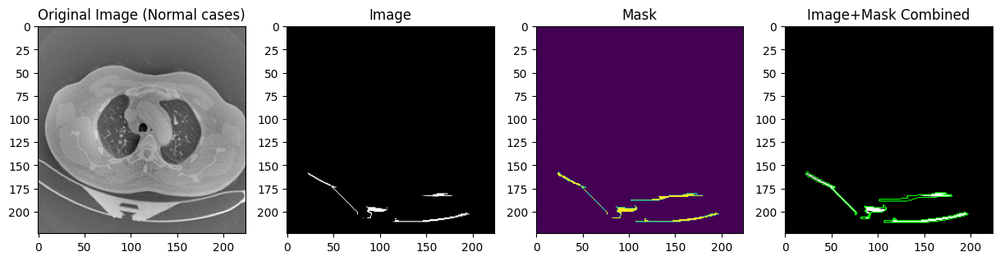

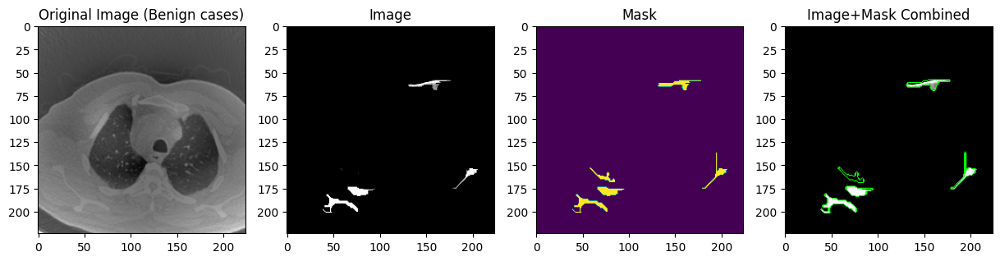

In [ ]:
import numpy as np
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

# Function to reshape the flattened image
def reshape_image(flattened_image):
    return flattened_image.reshape(224, 224)

# Function to make predictions on the reshaped and colored images
def make_predictions_on_categories(color_img):
    print(f"Shape of color_img before processing: {color_img.shape}")

    # Handle both single images and batches
    if len(color_img.shape) == 3:  # Single image
        gray_img = rgb2gray(color_img).reshape(1, 224, 224, 1)
    else:  # Batch of images
        gray_img = np.array([rgb2gray(img) for img in color_img])
        gray_img = gray_img.reshape(gray_img.shape[0], 224, 224, 1)

    print(f"Input shape for prediction: {gray_img.shape}")
    preds = model3.predict(gray_img)
    return preds

# Function to plot the comparison of images
def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15, 5))
    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224, 224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0, 1, 0)))
    ax.set_title("Image+Mask Combined")

# Assuming Y_test is already defined as the true labels for X_test
# Obtain predictions for the entire test set
# Check the shape of X_test before prediction
print(f"Shape of X_test before prediction: {X_test.shape}")

# Ensure X_test is correctly shaped
if len(X_test.shape) == 3:  # If the shape is (num_samples, height, width)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)
elif len(X_test.shape) == 2:  # If the shape is (num_samples, flattened_pixels)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)

# Print the shape again to confirm
print(f"Shape of X_test after reshaping: {X_test.shape}")

if len(X_test.shape) == 1:  # Check if X_test is a flattened array
    # Calculate the number of images in the batch
    num_images = X_test.size // (224 * 224)  # Total elements divided by one image size
    X_test = X_test.reshape(num_images, 224, 224, 1)  # Reshape into the correct batch size

print(f"Reshaped X_test shape: {X_test.shape}")

# Now, perform the prediction
Y_test_preds = model3.predict(X_test).argmax(axis=1)

# Iterate over each category
for label_name, label_value in label_map.items():
    # Filter misclassified instances for this category
    misclassified_indices = [i for i in category_indices[label_value] if y_test[i] != Y_test_preds[i]]

    if misclassified_indices:
        idx = misclassified_indices[0]  # Select the first misclassified image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Print category and image information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Generate LIME explanation for the incorrect prediction
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get the image and mask for the misclassified sample
        predicted_class = Y_test_preds[idx]
        img, mask = explanation.get_image_and_mask(predicted_class, positive_only=True, hide_rest=True)

        # Print shape information for verification
        print(img.shape)
        print(mask.shape)

        # Plot the comparison between the original and the LIME explanation
        plot_comparison(X_test[idx], img, mask, label_name)

# FALSE PREDICTION USING felzenszwalb segmentation method - NEGATIVE CONTRIBUTION

Shape of X_test before prediction: (900, 224, 224, 1)
Shape of X_test after reshaping: (900, 224, 224, 1)
Reshaped X_test shape: (900, 224, 224, 1)
29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step
Category: Malignant cases
Index: 10
Shape of image: (224, 224)
Actual Label: Benign cases
Predicted Label: Malignant cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Predictions: [[0.59836876 0.03116278 0.37046847]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Shape of color_img b

(224, 224, 3)
(224, 224)
Category: Normal cases
Index: 15
Shape of image: (224, 224)
Actual Label: Benign cases
Predicted Label: Normal cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predictions: [[0.00147445 0.90749335 0.09103226]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of color_img b

(224, 224, 3)
(224, 224)
Category: Benign cases
Index: 6
Shape of image: (224, 224)
Actual Label: Normal cases
Predicted Label: Benign cases

Shape of color_img before processing: (224, 224, 3)
Input shape for prediction: (1, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Predictions: [[0.09977373 0.4019754  0.4982509 ]]



  0%|          | 0/1000 [00:00<?, ?it/s]

Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Shape of color_img before processing: (10, 224, 224, 3)
Input shape for prediction: (10, 224, 224, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Shape of color_img b

(224, 224, 3)
(224, 224)


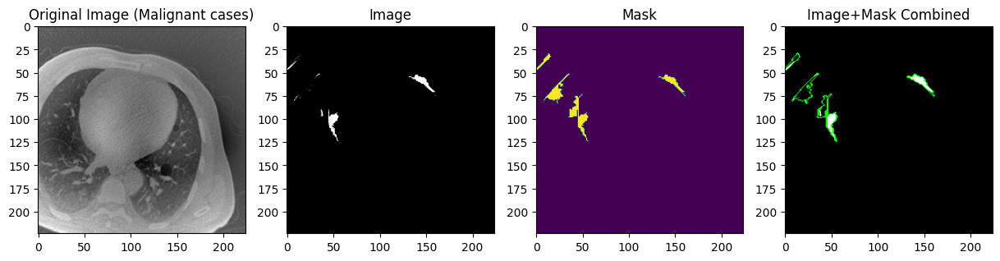

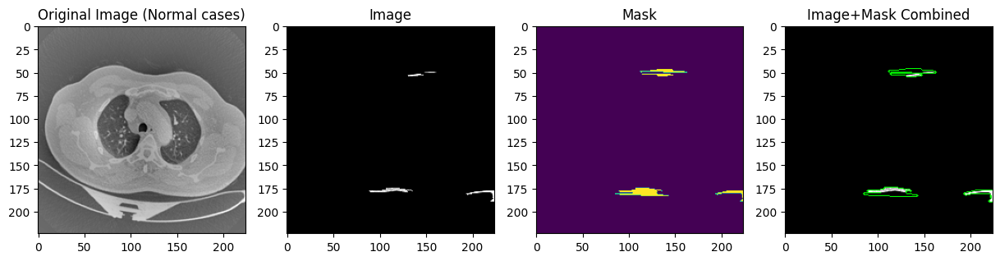

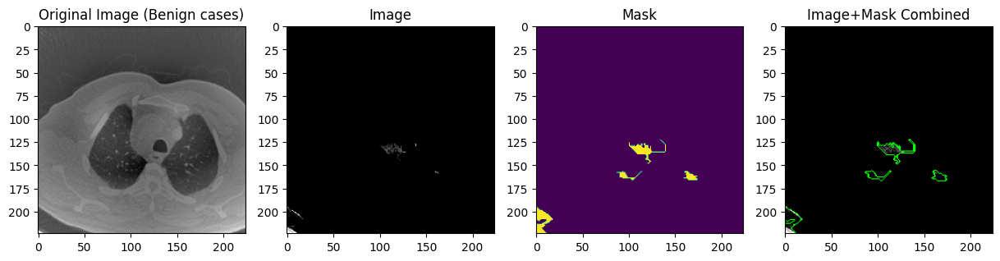

In [ ]:
import numpy as np
import skimage
from skimage.color import gray2rgb, rgb2gray
from skimage.segmentation import felzenszwalb, mark_boundaries
import matplotlib.pyplot as plt

# Function to reshape the flattened image
def reshape_image(flattened_image):
    return flattened_image.reshape(224, 224)

# Function to make predictions on the reshaped and colored images
def make_predictions_on_categories(color_img):
    print(f"Shape of color_img before processing: {color_img.shape}")

    # Handle both single images and batches
    if len(color_img.shape) == 3:  # Single image
        gray_img = rgb2gray(color_img).reshape(1, 224, 224, 1)
    else:  # Batch of images
        gray_img = np.array([rgb2gray(img) for img in color_img])
        gray_img = gray_img.reshape(gray_img.shape[0], 224, 224, 1)

    print(f"Input shape for prediction: {gray_img.shape}")
    preds = model3.predict(gray_img)
    return preds

# Function to plot the comparison of images
def plot_comparison(main_image, img, mask, label_name):
    fig = plt.figure(figsize=(15, 5))
    ax = fig.add_subplot(141)
    ax.imshow(main_image.reshape(224, 224), cmap="gray")
    ax.set_title(f"Original Image ({label_name})")
    ax = fig.add_subplot(142)
    ax.imshow(img)
    ax.set_title("Image")
    ax = fig.add_subplot(143)
    ax.imshow(mask)
    ax.set_title("Mask")
    ax = fig.add_subplot(144)
    ax.imshow(mark_boundaries(img, mask, color=(0, 1, 0)))
    ax.set_title("Image+Mask Combined")

# Assuming Y_test is already defined as the true labels for X_test
# Obtain predictions for the entire test set
# Check the shape of X_test before prediction
print(f"Shape of X_test before prediction: {X_test.shape}")

# Ensure X_test is correctly shaped
if len(X_test.shape) == 3:  # If the shape is (num_samples, height, width)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)
elif len(X_test.shape) == 2:  # If the shape is (num_samples, flattened_pixels)
    X_test = X_test.reshape(-1, 224, 224, 1)  # Reshape to (num_samples, 224, 224, 1)

# Print the shape again to confirm
print(f"Shape of X_test after reshaping: {X_test.shape}")

if len(X_test.shape) == 1:  # Check if X_test is a flattened array
    # Calculate the number of images in the batch
    num_images = X_test.size // (224 * 224)  # Total elements divided by one image size
    X_test = X_test.reshape(num_images, 224, 224, 1)  # Reshape into the correct batch size

print(f"Reshaped X_test shape: {X_test.shape}")

# Now, perform the prediction
Y_test_preds = model3.predict(X_test).argmax(axis=1)

for label_name, label_value in label_map.items(): # Switch the order of label_value and label_name
    # Filter misclassified instances for this category
    misclassified_indices = [i for i in category_indices[label_value] if y_test[i] != Y_test_preds[i]]

    if misclassified_indices:
        idx = misclassified_indices[0]  # Select the first misclassified image for the category
        flattened_image = X_test[idx]
        image = reshape_image(flattened_image)

        # Get the actual and predicted labels
        actual_label = y_test[idx]
        predicted_label = Y_test_preds[idx]

        # Print category, index, and label information
        print(f"Category: {label_name}")
        print(f"Index: {idx}")
        print(f"Shape of image: {image.shape}")
        # Use actual_label and predicted_label to get the label names from label_map
        print(f"Actual Label: {list(label_map.keys())[list(label_map.values()).index(actual_label)]}")
        print(f"Predicted Label: {list(label_map.keys())[list(label_map.values()).index(predicted_label)]}")
        print()
        #print(f"Actual Label: {label_map[actual_label]}")
        #print(f"Predicted Label: {label_map[predicted_label]}")
        #print()

        # Convert grayscale to RGB and make predictions
        colored_image = gray2rgb(image)
        predictions = make_predictions_on_categories(colored_image)

        # Print the predictions
        print(f"Predictions: {predictions}")
        print()

        # Generate LIME explanation for the incorrect prediction
        explanation = explainer.explain_instance(
            colored_image,
            make_predictions_on_categories,
            segmentation_fn=felzenszwalb,
            random_seed=123
        )

        # Get the image and mask for the misclassified sample
        predicted_class = Y_test_preds[idx]
        img, mask = explanation.get_image_and_mask(predicted_class, positive_only=False, negative_only=True, hide_rest=True)

        # Print shape information for verification
        print(img.shape)
        print(mask.shape)

        # Plot the comparison between the original and the LIME explanation
        plot_comparison(X_test[idx], img, mask, label_name)

# Lime Results using different method

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━

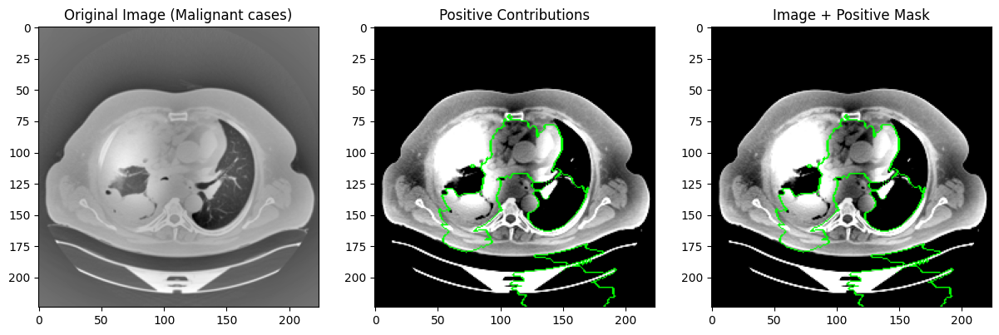

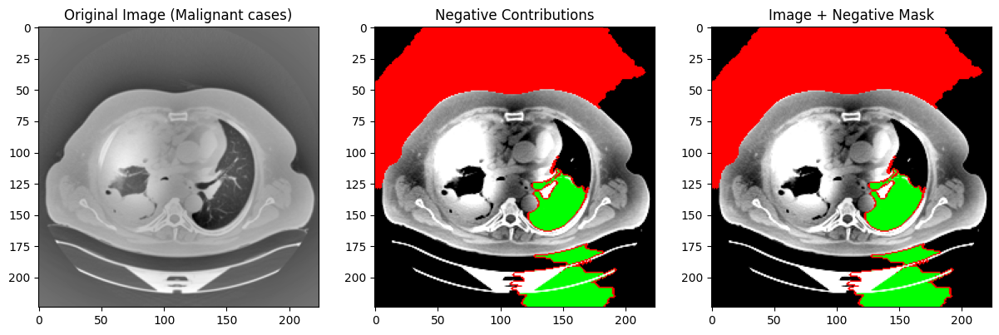

Generating explanation for: Normal cases (Image index: 6)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━

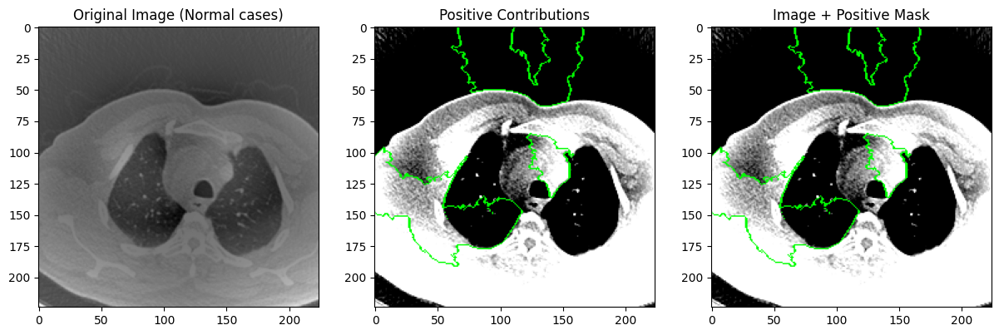

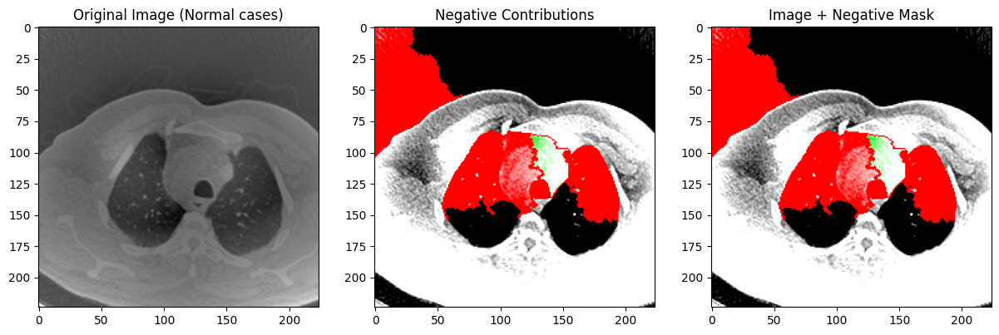

Generating explanation for: Benign cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━

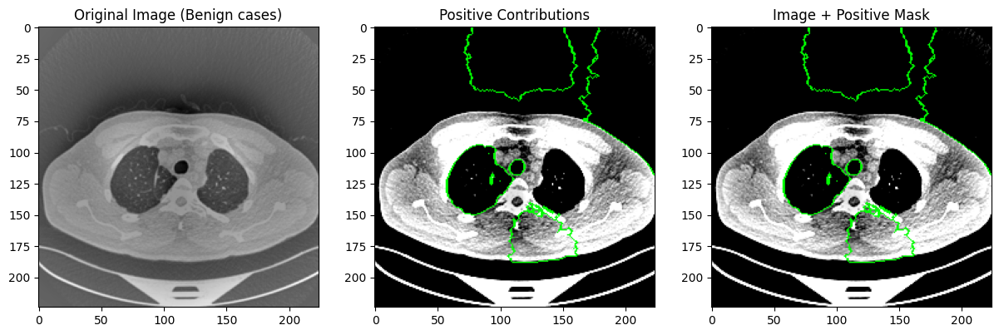

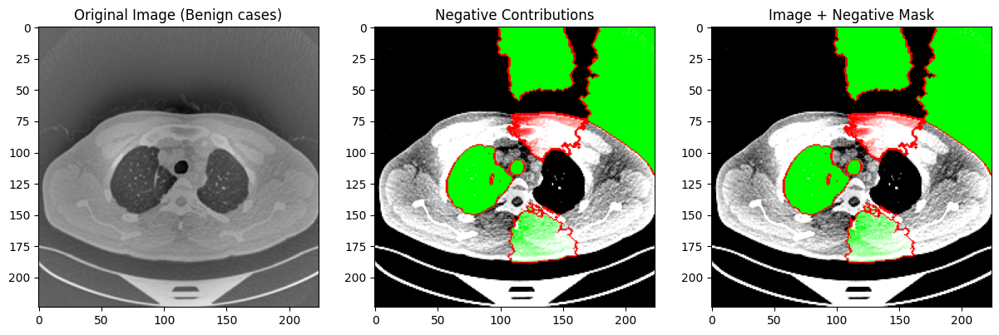

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model3.predict(image)
    return preds

# Function to plot the comparison
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries

def plot_positive_contributions(main_image, img_pos, mask_pos, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Positive Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Positive Mask")

    plt.show()

def plot_negative_contributions(main_image, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Negative Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_neg, mask_neg, color=(1, 0, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Negative Mask")

    plt.show()


# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model3.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_positive_contributions(X_test_reshaped[idx], img_pos, mask_pos, label_name)
        plot_negative_contributions(X_test_reshaped[idx], img_neg, mask_neg, label_name)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━

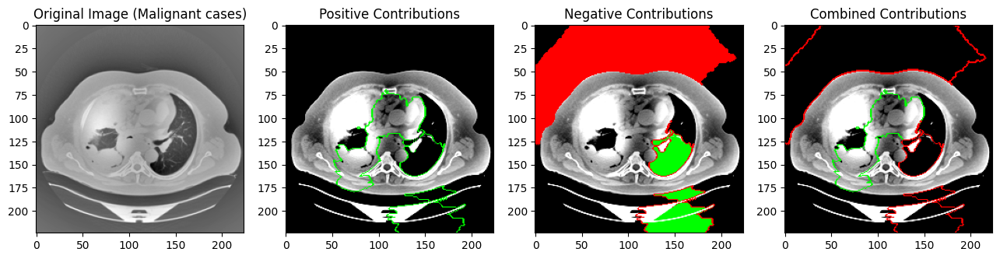

Generating explanation for: Normal cases (Image index: 6)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━

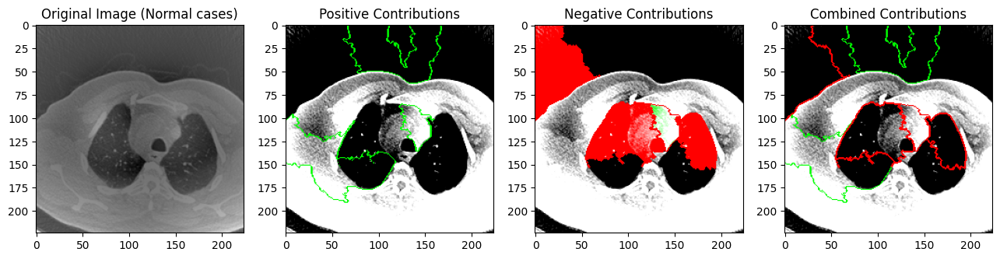

Generating explanation for: Benign cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━

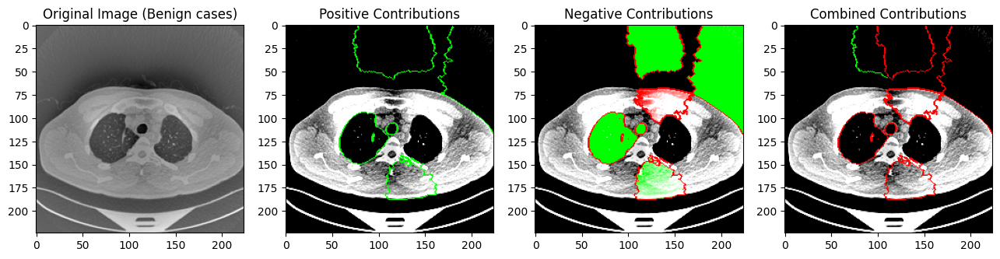

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model3.predict(image)
    return preds

# Function to plot the comparison
def plot_comparison(main_image, img_pos, mask_pos, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    ax = fig.add_subplot(151)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    ax = fig.add_subplot(152)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    ax = fig.add_subplot(153)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    ax = fig.add_subplot(154)
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    # Apply negative mask without alpha, as it's not supported in older versions
    combined_img = mark_boundaries(combined_img, mask_neg, color=(1, 0, 0))
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Combined Contributions")

    plt.show()

# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model3.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_comparison(X_test_reshaped[idx], img_pos, mask_pos, img_neg, mask_neg, label_name)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━

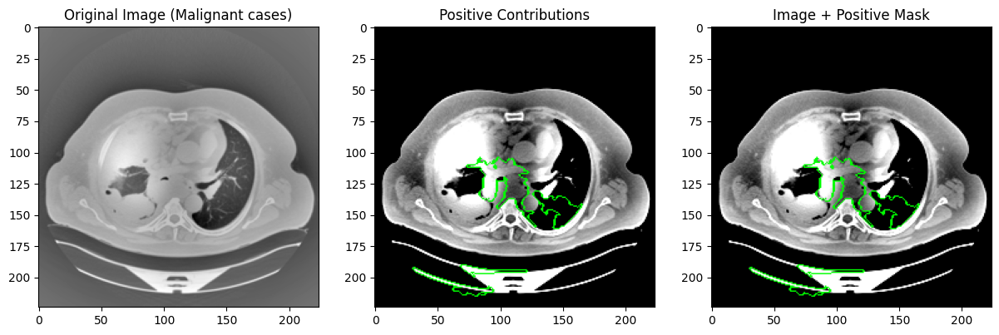

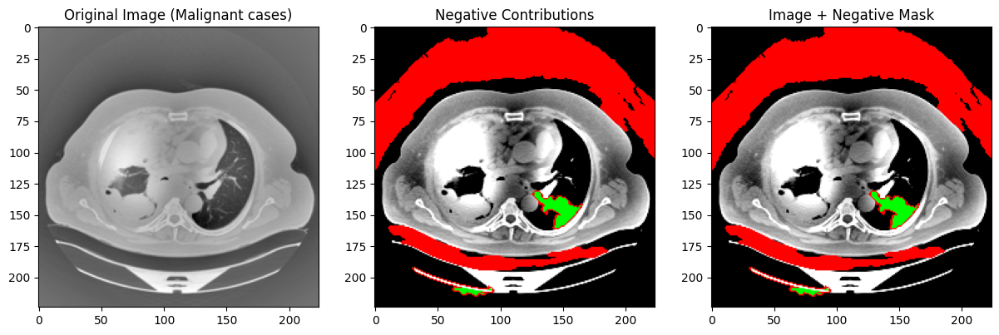

Generating explanation for: Normal cases (Image index: 6)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━

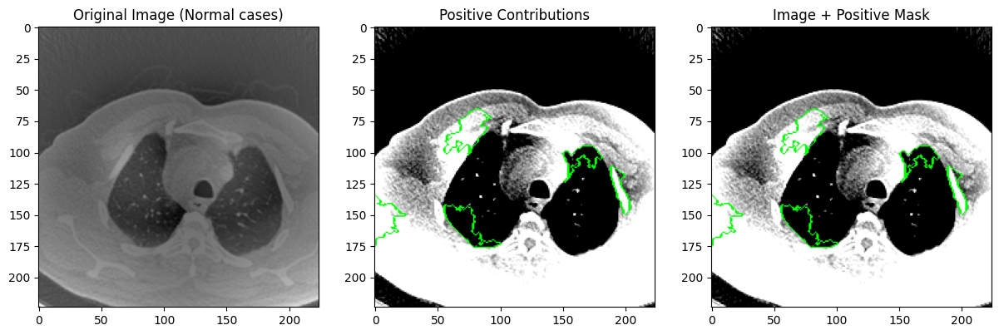

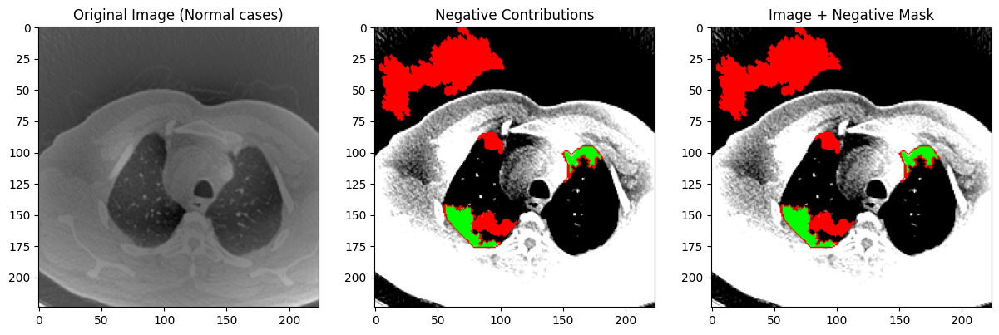

Generating explanation for: Benign cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━

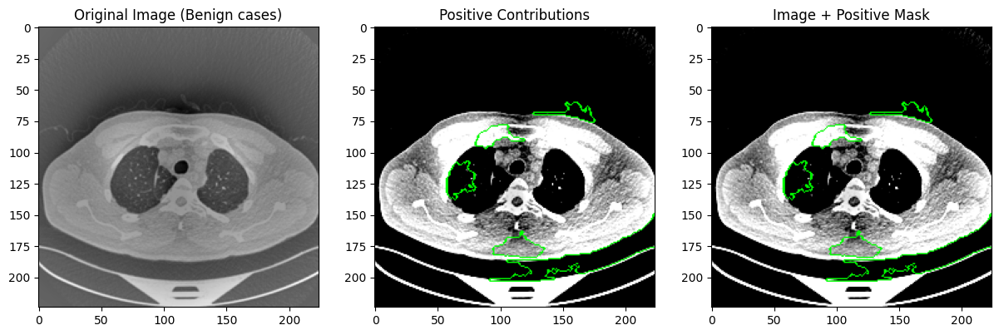

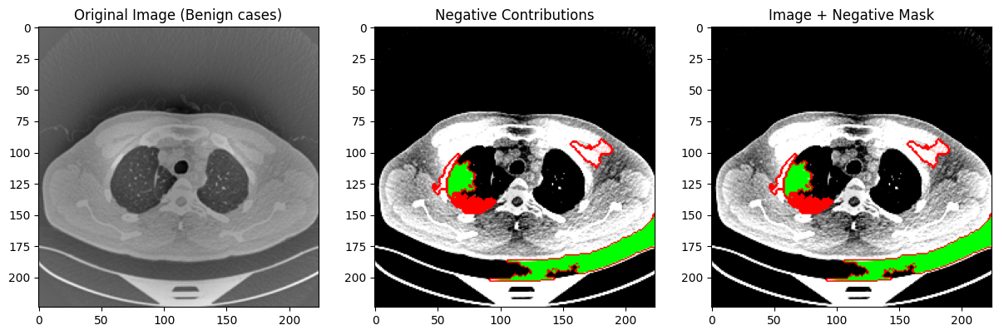

In [ ]:
# Lime using felzenszwalb segmentation method
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, felzenszwalb
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model3.predict(image)
    return preds

# Function to plot the comparison
def plot_positive_contributions(main_image, img_pos, mask_pos, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Positive Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Positive Mask")

    plt.show()

def plot_negative_contributions(main_image, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    # Original Image
    ax = fig.add_subplot(141)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    # Image with Negative Mask
    ax = fig.add_subplot(142)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    # Combined Image
    combined_img = mark_boundaries(img_neg, mask_neg, color=(1, 0, 0))
    ax = fig.add_subplot(143)
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Image + Negative Mask")

    plt.show()


# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model3.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label using felzenszwalb segmentation
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            segmentation_fn=lambda x: felzenszwalb(x, scale=100, sigma=0.5, min_size=50),
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_positive_contributions(X_test_reshaped[idx], img_pos, mask_pos, label_name)
        plot_negative_contributions(X_test_reshaped[idx], img_neg, mask_neg, label_name)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━

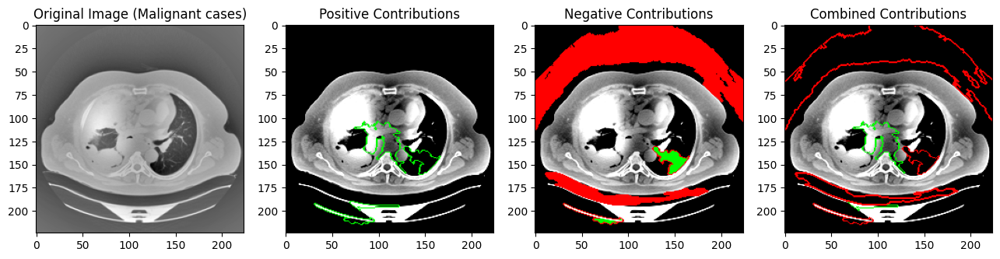

Generating explanation for: Normal cases (Image index: 6)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━

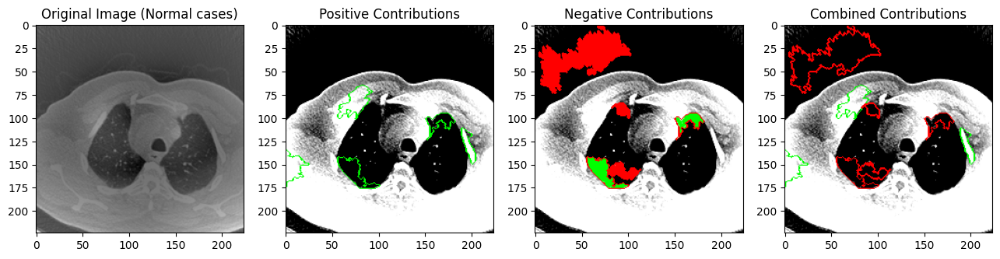

Generating explanation for: Benign cases (Image index: 0)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━

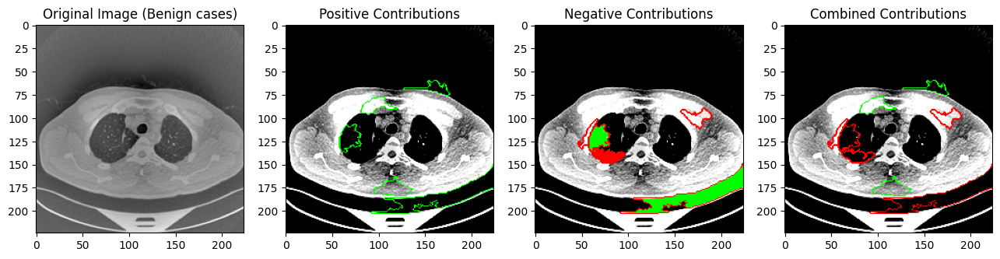

In [ ]:
# Lime using felzenszwalb segmentation method
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, felzenszwalb
from lime import lime_image
from skimage.color import rgb2gray

# Create LimeImageExplainer instance
explainer = lime_image.LimeImageExplainer(random_state=123)

# Function to make predictions
def make_prediction(image):
    # Handle both single images and batches of images
    if image.shape[0] == 1:  # Single image
        image = image[0]  # Remove batch dimension
        if image.shape[-1] == 3:  # If color, convert to grayscale
            image = rgb2gray(image)
            image = image[:, :, np.newaxis]  # Add channel dimension
    else:  # Batch of images
        # Convert color images in the batch to grayscale
        # Create a new list to store the processed images
        processed_images = []
        for i in range(image.shape[0]):
            if image[i].shape[-1] == 3:
                processed_image = rgb2gray(image[i])
                processed_image = processed_image[:, :, np.newaxis]
            else:
                processed_image = image[i]
            processed_images.append(processed_image)
        # Stack the processed images back into an array
        image = np.stack(processed_images, axis=0)

    # Reshape to match model input shape (batch_size, height, width, channels)
    image = image.reshape(-1, 224, 224, 1)  # Assuming model expects grayscale images with one channel
    preds = model3.predict(image)
    return preds

# Function to plot the comparison
def plot_comparison(main_image, img_pos, mask_pos, img_neg, mask_neg, label_name):
    fig = plt.figure(figsize=(20, 5))

    ax = fig.add_subplot(151)
    ax.imshow(main_image, cmap="gray")
    ax.set_title(f"Original Image ({label_name})")

    ax = fig.add_subplot(152)
    ax.imshow(mark_boundaries(img_pos, mask_pos, color=(0, 1, 0)), cmap="gray")
    ax.set_title("Positive Contributions")

    ax = fig.add_subplot(153)
    ax.imshow(mark_boundaries(img_neg, mask_neg, color=(1, 0, 0)), cmap="gray")
    ax.set_title("Negative Contributions")

    ax = fig.add_subplot(154)
    combined_img = mark_boundaries(img_pos, mask_pos, color=(0, 1, 0))
    combined_img = mark_boundaries(combined_img, mask_neg, color=(1, 0, 0))
    ax.imshow(combined_img, cmap="gray")
    ax.set_title("Combined Contributions")

    plt.show()

# Separate images into categories based on model predictions
category_indices = {label: [] for label in label_map.values()}

for i in range(len(X_test_reshaped)):
    image = X_test_reshaped[i]
    if len(image.shape) == 2:  # Ensure image is grayscale
        image = image[:, :, np.newaxis]  # Add channel dimension if it's missing

    if image.shape != (224, 224, 1):
        continue  # Skip if the image shape is not correct

    pred_label = model3.predict(image.reshape(1, 224, 224, 1)).argmax(axis=1)[0]
    category_indices[pred_label].append(i)

# Generate explanations for each category
for label_name, label_value in label_map.items():
    if category_indices[label_value]:
        idx = category_indices[label_value][0]  # Select the first image for the category
        print(f"Generating explanation for: {label_name} (Image index: {idx})")

        # Ensure the image is grayscale and has the correct shape
        image = X_test_reshaped[idx]
        if len(image.shape) == 4:  # Check if it's a batch
            image = image[0]  # Select the first image from the batch
        if image.shape[-1] == 3:  # Check if it's a color image
            image = rgb2gray(image)  # Convert to grayscale
            image = image[:, :, np.newaxis]  # Add channel dimension for grayscale
        if image.shape != (224, 224, 1):
            print(f"Skipping image with unexpected shape: {image.shape}")
            continue  # Skip if the image shape is not correct

        # Get explanation for the selected image and label using felzenszwalb segmentation
        explanation = explainer.explain_instance(
            image.squeeze(),
            make_prediction,
            labels=[label_value],
            segmentation_fn=lambda x: felzenszwalb(x, scale=100, sigma=0.5, min_size=50),  # Customize segmentation parameters
            random_seed=123
        )

        # Get positive contribution image and mask
        img_pos, mask_pos = explanation.get_image_and_mask(
            label_value, positive_only=True, hide_rest=False
        )

        # Get negative contribution image and mask
        img_neg, mask_neg = explanation.get_image_and_mask(
            label_value, positive_only=False, hide_rest=False, num_features=5
        )

        # Plot comparison for positive and negative masks
        plot_comparison(X_test_reshaped[idx], img_pos, mask_pos, img_neg, mask_neg, label_name)
